<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 1 Import the needed libraries
    

    
</div>

In [1]:
# initials
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# encoders
import category_encoders as ce
from sklearn.preprocessing import OneHotEncoder

#Feature Selectiom
import scipy.stats as stats
from scipy.stats import chi2_contingency
from sklearn.feature_selection import mutual_info_classif
from skfeature.function.similarity_based import fisher_score
from sklearn.svm import SVC
from sklearn.feature_selection import RFE, SelectKBest, f_classif
from sklearn.linear_model import LassoCV, Ridge, RidgeCV, Lasso
from sklearn.feature_selection import RFECV
from sklearn.inspection import permutation_importance

# Sampling
from imblearn.over_sampling import SMOTE

# Scaler
from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler

# Models
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier

# Metrics
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, median_absolute_error, make_scorer, accuracy_score, f1_score, log_loss, classification_report
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.metrics import precision_recall_curve, confusion_matrix

# for better resolution plots and others
%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'
from joblib import Parallel, delayed
import warnings
warnings.filterwarnings('ignore')

In [2]:
pd.set_option('display.max_columns', None)

<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 2. Initial Data Understanding
    

    
</div>

In [3]:
df_train = pd.read_csv('train_data.csv')
df_train.head()

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Identifier,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,OIICS Nature of Injury Description,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,WCB Decision,Number of Dependents
0,2019-12-30,31.0,N,2020-01-01,N,0.00,1988.0,2019-12-31,NaN,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,5393875,2. NON-COMP,ST. LAWRENCE,N,SYRACUSE,NaN,M,NaN,44.0,RETAIL TRADE,I,NaN,27.0,FROM LIQUID OR GREASE SPILLS,10.0,CONTUSION,62.0,BUTTOCKS,13662,0.0,Not Work Related,1.0
1,2019-08-30,46.0,N,2020-01-01,Y,1745.93,1973.0,2020-01-01,2020-01-14,ZURICH AMERICAN INSURANCE CO,1A. PRIVATE,5393091,4. TEMPORARY,WYOMING,N,ROCHESTER,2020-02-21,F,4.0,23.0,CONSTRUCTION,I,NaN,97.0,REPETITIVE MOTION,49.0,SPRAIN OR TEAR,38.0,SHOULDER(S),14569,1.0,Not Work Related,4.0
2,2019-12-06,40.0,N,2020-01-01,N,1434.80,1979.0,2020-01-01,NaN,INDEMNITY INSURANCE CO OF,1A. PRIVATE,5393889,4. TEMPORARY,ORANGE,N,ALBANY,NaN,M,NaN,56.0,ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMEN...,II,NaN,79.0,OBJECT BEING LIFTED OR HANDLED,7.0,CONCUSSION,10.0,MULTIPLE HEAD INJURY,12589,0.0,Not Work Related,6.0
3,NaN,NaN,NaN,2020-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,957648180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-12-30,61.0,N,2020-01-01,N,NaN,1958.0,2019-12-31,NaN,STATE INSURANCE FUND,2A. SIF,5393887,2. NON-COMP,DUTCHESS,N,ALBANY,NaN,M,NaN,62.0,HEALTH CARE AND SOCIAL ASSISTANCE,II,NaN,16.0,"HAND TOOL, UTENSIL; NOT POWERED",43.0,PUNCTURE,36.0,FINGER(S),12603,0.0,Not Work Related,1.0


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 593471 entries, 0 to 593470
Data columns (total 33 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   Accident Date                       570337 non-null  object 
 1   Age at Injury                       574026 non-null  float64
 2   Alternative Dispute Resolution      574026 non-null  object 
 3   Assembly Date                       593471 non-null  object 
 4   Attorney/Representative             574026 non-null  object 
 5   Average Weekly Wage                 545375 non-null  float64
 6   Birth Year                          544948 non-null  float64
 7   C-2 Date                            559466 non-null  object 
 8   C-3 Date                            187245 non-null  object 
 9   Carrier Name                        574026 non-null  object 
 10  Carrier Type                        574026 non-null  object 
 11  Claim Identifier          

There were claim identifiers with 7 or 9 digits. However, the ones with 9 digits were all missing values, so the group kept only the claims with identifiers that had 7 digits.

In [5]:
df_train["Claim Identifier"] = df_train["Claim Identifier"].astype(str) # convert column to type "str" in order to use length()
df_train["Claim Identifier"].str.len().value_counts()                   # check how it´s divided between 7 or 9 digits

Claim Identifier
7    574026
9     19445
Name: count, dtype: int64

In [6]:
id9digits = df_train[df_train["Claim Identifier"].str.len() == 9].isnull().sum() # counting missing values in all columns knowing that are 19445 rows where ID is 9 digits
id9digits

Accident Date                         19445
Age at Injury                         19445
Alternative Dispute Resolution        19445
Assembly Date                             0
Attorney/Representative               19445
Average Weekly Wage                   19445
Birth Year                            19445
C-2 Date                              19445
C-3 Date                              19445
Carrier Name                          19445
Carrier Type                          19445
Claim Identifier                          0
Claim Injury Type                     19445
County of Injury                      19445
COVID-19 Indicator                    19445
District Name                         19445
First Hearing Date                    19445
Gender                                19445
IME-4 Count                           19445
Industry Code                         19445
Industry Code Description             19445
Medical Fee Region                    19445
OIICS Nature of Injury Descripti

In [7]:
df_train = df_train[df_train["Claim Identifier"].str.len() == 7] # maintain only 7 digits values
df_train["Claim Identifier"].str.len().value_counts()

Claim Identifier
7    574026
Name: count, dtype: int64

In [8]:
df_train["Claim Identifier"] = df_train["Claim Identifier"].astype('Int64') # convert column to type "int" in order to use it as index.

In [9]:
df_train["Claim Injury Type"].value_counts() # target variable

Claim Injury Type
2. NON-COMP        291078
4. TEMPORARY       148507
3. MED ONLY         68906
5. PPD SCH LOSS     48280
1. CANCELLED        12477
6. PPD NSL           4211
8. DEATH              470
7. PTD                 97
Name: count, dtype: int64

In [10]:
df_train["Age at Injury"].describe()

count    574026.000000
mean         42.114270
std          14.256432
min           0.000000
25%          31.000000
50%          42.000000
75%          54.000000
max         117.000000
Name: Age at Injury, dtype: float64

In [11]:
df_train["WCB Decision"].unique() #WCB Decision - Decision of the WCB relative to the claim. Drop this column because only have one value

array(['Not Work Related'], dtype=object)

In [12]:
df_train["Zip Code"].unique()

array(['13662', '14569', '12589', ..., 'G9B0Y', '15143', '07122'],
      dtype=object)

In [13]:
df_train["Medical Fee Region"].unique() # approximate region where the injured worker would receive medical service.

array(['I', 'II', 'IV', 'UK', 'III'], dtype=object)

In [14]:
df_train["COVID-19 Indicator"].value_counts() # Indication that the claim may be associated with COVID-19.
### N means No and Y means Yes

COVID-19 Indicator
N    546505
Y     27521
Name: count, dtype: int64

In [15]:
df_train["Carrier Name"].nunique() #There are 2046 insurance providers (carriers) responsible for providing workers’ compensation coverage to the injured worker’s employer

2046

In [16]:
df_train["Alternative Dispute Resolution"].value_counts() # N means No and Y means Yes, U means Unknown

Alternative Dispute Resolution
N    571412
Y      2609
U         5
Name: count, dtype: int64

In [17]:
df_train["Attorney/Representative"].value_counts() # N means No and Y means Yes - transform to binary

Attorney/Representative
N    392291
Y    181735
Name: count, dtype: int64

In [18]:
df_train["Carrier Type"].value_counts() # Type of primary insurance provider responsible for providing workers’ compensation coverage

Carrier Type
1A. PRIVATE                                    285368
3A. SELF PUBLIC                                121920
2A. SIF                                        111144
4A. SELF PRIVATE                                52788
UNKNOWN                                          1774
5D. SPECIAL FUND - UNKNOWN                       1023
5C. SPECIAL FUND - POI CARRIER WCB MENANDS          5
5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)         4
Name: count, dtype: int64

In [19]:
df_train["Gender"].value_counts()

Gender
M    335218
F    234051
U      4711
X        46
Name: count, dtype: int64

In [20]:
df_train["WCIO Part Of Body Code"].unique() # check the value -9 in the column "WCIO Part Of Body Code"

array([62., 38., 10., 36., 60., 14., 55., 53., 37., 42., 61., 54., 51.,
       52., 17., 34., 23., 35., 18., 31., 25., 56., 32., 30., 90., 91.,
       20., 44., 39., 13., 50., 43., 33., -9., 22., 41., 11., 57., 19.,
       nan, 16., 66., 40., 99., 65., 46., 15., 58., 48., 49., 21., 63.,
       12., 45., 64., 24., 47., 26.])

In [21]:
df_train[df_train["WCIO Part Of Body Code"]== -9].head()

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Identifier,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,OIICS Nature of Injury Description,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,WCB Decision,Number of Dependents
128,2019-12-19,42.0,N,2020-01-01,Y,1093.74,1977.0,2019-12-31,2020-01-14,PUBLIC EMPLOYERS RISK MGMT.,3A. SELF PUBLIC,5393974,4. TEMPORARY,DUTCHESS,N,ALBANY,2020-08-27,M,6.0,92.0,PUBLIC ADMINISTRATION,II,NaN,99.0,"OTHER - MISCELLANEOUS, NOC",52.0,STRAIN OR TEAR,-9.0,MULTIPLE,12578,1.0,Not Work Related,6.0
235,2019-09-13,36.0,N,2020-01-02,Y,1500.00,1983.0,2020-02-07,2019-12-27,"POLICE, FIRE, SANITATION",3A. SELF PUBLIC,5393785,5. PPD SCH LOSS,SUFFOLK,N,HAUPPAUGE,2020-03-12,F,3.0,92.0,PUBLIC ADMINISTRATION,IV,NaN,81.0,"STRUCK OR INJURED, NOC",10.0,CONTUSION,-9.0,MULTIPLE,11704,0.0,Not Work Related,5.0
790,2019-12-12,57.0,N,2020-01-03,Y,764.35,1962.0,2020-01-03,2020-01-09,PROPERTY AND CASUALTY,1A. PRIVATE,5395679,5. PPD SCH LOSS,BRONX,N,NYC,2020-02-18,M,NaN,31.0,MANUFACTURING,IV,NaN,29.0,ON SAME LEVEL,52.0,STRAIN OR TEAR,-9.0,MULTIPLE,10466,0.0,Not Work Related,4.0
1006,2018-01-06,50.0,N,2020-01-03,N,0.00,1967.0,2020-01-03,NaN,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,5395006,2. NON-COMP,BRONX,N,NYC,NaN,M,NaN,23.0,CONSTRUCTION,UK,NaN,97.0,REPETITIVE MOTION,59.0,"ALL OTHER SPECIFIC INJURIES, NOC",-9.0,MULTIPLE,07726,0.0,Not Work Related,0.0
2276,2019-12-26,33.0,N,2020-01-06,Y,670.00,NaN,2020-01-06,2020-12-08,"SYRACUSE, CITY OF",3A. SELF PUBLIC,5396338,4. TEMPORARY,ONONDAGA,N,SYRACUSE,2021-02-16,M,9.0,92.0,PUBLIC ADMINISTRATION,II,NaN,56.0,LIFTING,52.0,STRAIN OR TEAR,-9.0,MULTIPLE,13208,0.0,Not Work Related,1.0


In [22]:
df_train["WCIO Part Of Body Description"].unique()

array(['BUTTOCKS', 'SHOULDER(S)', 'MULTIPLE HEAD INJURY', 'FINGER(S)',
       'LUNGS', 'EYE(S)', 'ANKLE', 'KNEE', 'THUMB', 'LOWER BACK AREA',
       'ABDOMEN INCLUDING GROIN', 'LOWER LEG', 'HIP', 'UPPER LEG',
       'MOUTH', 'WRIST', 'SPINAL CORD', 'HAND', 'SOFT TISSUE',
       'UPPER ARM', 'FOOT', 'ELBOW', 'MULTIPLE UPPER EXTREMITIES',
       'MULTIPLE BODY PARTS (INCLUDING BODY',
       'BODY SYSTEMS AND MULTIPLE BODY SYSTEMS', 'MULTIPLE NECK INJURY',
       'CHEST', 'WRIST (S) & HAND(S)', 'EAR(S)',
       'MULTIPLE LOWER EXTREMITIES', 'DISC', 'LOWER ARM', 'MULTIPLE',
       'UPPER BACK AREA', 'SKULL', 'TOES', 'FACIAL BONES', nan, 'TEETH',
       'NO PHYSICAL INJURY', 'MULTIPLE TRUNK', 'WHOLE BODY',
       'INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLASSIFIED', 'PELVIS',
       'NOSE', 'GREAT TOE', 'INTERNAL ORGANS', 'HEART', 'VERTEBRAE',
       'LUMBAR & OR SACRAL VERTEBRAE (VERTEBRA', 'BRAIN',
       'SACRUM AND COCCYX', 'ARTIFICIAL APPLIANCE', 'LARYNX', 'TRACHEA'],
      dtype=ob

In [23]:
missing_values = df_train.isnull().sum().sort_values(ascending=False)                                   # count the number of missing values in each column and sort them in descending order
missing_percentage = (missing_values / len(df_train)) * 100                                             # calculate the percentage of missing values
missing_data = pd.DataFrame({'Missing Values': missing_values, 'Percentage': missing_percentage})       # create a dataframe to store the missing values and their percentage
missing_data.style.applymap(lambda x: 'background-color: red' if x > 10 else '', subset=['Percentage']) # highlight missing values above 10%

,Missing Values,Percentage
OIICS Nature of Injury Description,574026,100.000000
IME-4 Count,441223,76.864637
First Hearing Date,423228,73.729761
C-3 Date,386781,67.380397
Birth Year,29078,5.065624
Average Weekly Wage,28651,4.991237
Zip Code,28637,4.988798
WCIO Part Of Body Description,17082,2.975823
WCIO Part Of Body Code,17082,2.975823
WCIO Nature of Injury Description,15657,2.727577


There are 4 variables with a significant number of missing values, however we will see that 3 of them are actually relevant for the predictions if we assume that missing values as don´t exist:
- C-3 Date - 68.4 %
- First Hearing Date - 74.6%
- ME-4 Count - 77.6%
- OIICS Nature of Injury Description - 100%
- The rest of the variables have a percentage of missing values that go from 1% to 5% wich is acceptable and we can handle these with imputation

In [24]:
df_train.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Accident Date,570337,5539,2020-03-01,1245,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age at Injury,574026.0,NaN,NaN,NaN,42.11427,14.256432,0.0,31.0,42.0,54.0,117.0
Alternative Dispute Resolution,574026,3,N,571412,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Assembly Date,574026,897,2020-03-06,1413,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Attorney/Representative,574026,2,N,392291,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Average Weekly Wage,545375.0,NaN,NaN,NaN,491.088321,6092.91812,0.0,0.0,0.0,841.0,2828079.0
Birth Year,544948.0,NaN,NaN,NaN,1886.767604,414.644423,0.0,1965.0,1977.0,1989.0,2018.0
C-2 Date,559466,2475,2021-05-11,1847,NaN,NaN,NaN,NaN,NaN,NaN,NaN
C-3 Date,187245,1648,2021-04-21,350,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Carrier Name,574026,2046,STATE INSURANCE FUND,111144,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Check for duplicates

In [25]:
df_train[df_train.duplicated(subset=["Claim Identifier"], keep=False)]

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Identifier,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,OIICS Nature of Injury Description,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,WCB Decision,Number of Dependents


Set the column "Claim Identifier" as the index

In [26]:
df_train.set_index('Claim Identifier', inplace = True)

<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 3. Pre-Processing (Correct datatypes and drop irrelevant columns)
    

    
</div>

In [31]:
df_train.head(1)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5393875,2019-12-30,31,N,2020-01-01,N,0.0,1988,2019-12-31,NaT,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,2. NON-COMP,ST. LAWRENCE,N,SYRACUSE,NaT,M,NaN,44,RETAIL TRADE,I,27,FROM LIQUID OR GREASE SPILLS,10,CONTUSION,62,BUTTOCKS,13662,0,1


Drop the columns with a significant number of missing values and columns that are not relevant for the analysis (WCB Decision)

In [32]:
columns_to_drop =["OIICS Nature of Injury Description", "WCB Decision"]
for c in columns_to_drop:
    df_train = df_train.drop([c], axis=1) # axis = 1 drop columns

KeyError: "['OIICS Nature of Injury Description'] not found in axis"

Changing the Data Type of the columns : "Accident Date", "Assembly Date", "C-2 Date" to datetime

In [29]:
columns_to_date_time=["Accident Date", "Assembly Date", "C-2 Date", "C-3 Date", "First Hearing Date"]
for i in columns_to_date_time:
    df_train[i] = pd.to_datetime(df_train[i], errors='coerce') #coerce will force an out-of-bounds date to NaT, in case of any error 

Changing the Data Type of the columns : "Age at Injury", "Birth Year", "Industry Code", "WCIO Cause of Injury Code", "WCIO Nature of Injury Code", "Number of Dependents" to numeric

In [30]:
lista=["Age at Injury", "Birth Year", "Number of Dependents", "WCIO Part Of Body Code", "WCIO Nature of Injury Code", "WCIO Cause of Injury Code", "Industry Code", "Agreement Reached"]
for i in lista:
    df_train[i] = pd.to_numeric(df_train[i], errors='coerce').astype('Int64')

<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 4. EDA and specific Data Understanding
    

    
</div>

<a class="anchor" id="3rd-bullet">

## Function - truncated colormap
    
</a>

In [33]:
# set back to white - cleaner
sns.set_style("white")

from matplotlib.colors import LinearSegmentedColormap

# Create a truncated version of the "Blues" colormap - we interact with copilot to determine this for us.
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = LinearSegmentedColormap.from_list(
        'truncated', cmap(np.linspace(minval, maxval, n)))
    return new_cmap

# Use the truncated colormap
blues = plt.get_cmap('Blues')
truncated_blues = truncate_colormap(blues, 0.3, 1.0)  # Adjust minval to exclude the whitest color

<a class="anchor" id="3rd-bullet">

## Age at Injury
    
</a>

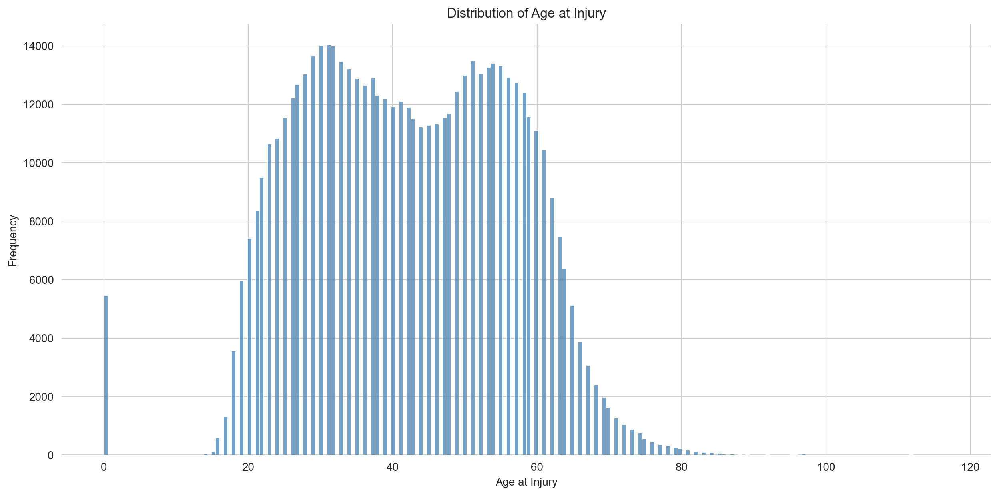

In [34]:
plt.figure(figsize=(15, 7))                                   # set the size of the plot
sns.histplot(df_train['Age at Injury'], color='#4782B4')      # histogram of the 'Age at Injury' column
plt.xlabel('Age at Injury')                                   # set the x-axis label
plt.ylabel('Frequency')                                       # set the y-axis label
plt.title('Distribution of Age at Injury')
plt.grid(True)                                                # display the grid
ax = plt.gca()                                                
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

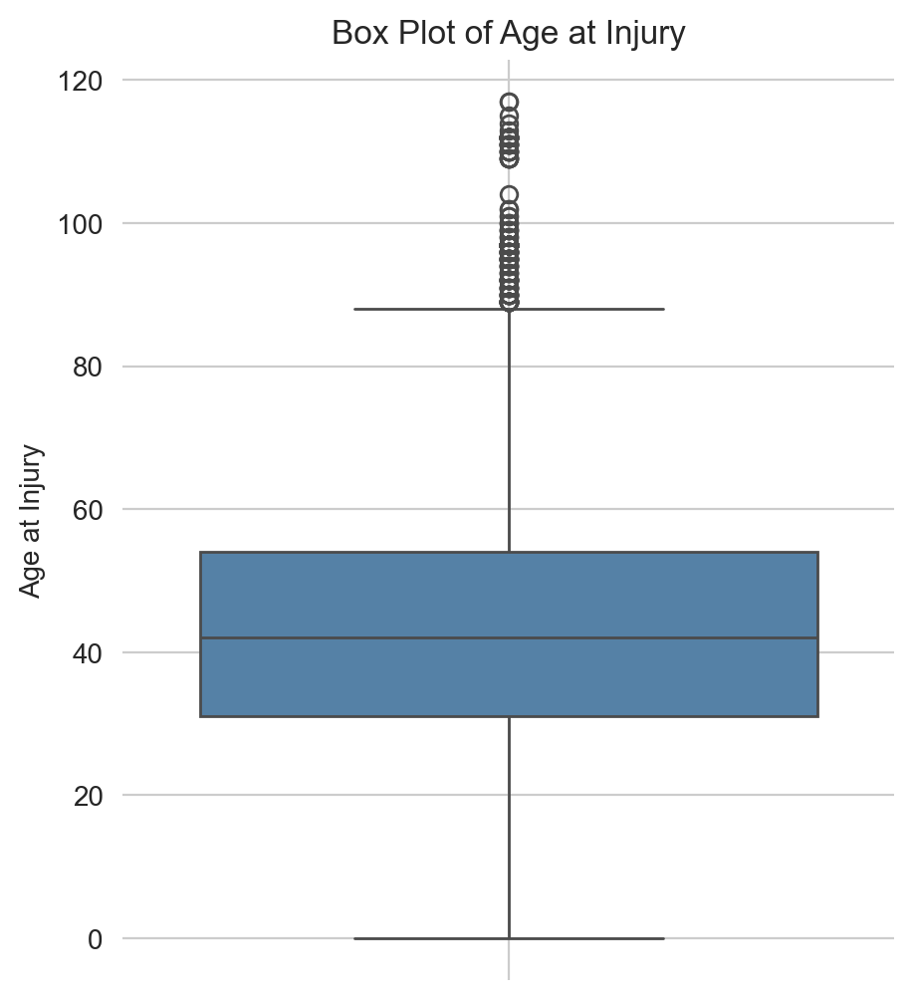

In [35]:
plt.figure(figsize=(5, 6))
sns.boxplot(y=df_train["Age at Injury"], color='#4782B4')
plt.ylabel('Age at Injury')
plt.title('Box Plot of Age at Injury')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [36]:
df_train[df_train["Age at Injury"] > 90][["Claim Injury Type"]].value_counts() # see if high age affects more Claim Type.

Claim Injury Type
2. NON-COMP          137
1. CANCELLED          10
4. TEMPORARY          10
3. MED ONLY            6
5. PPD SCH LOSS        3
Name: count, dtype: int64

In [37]:
df_train[df_train["Age at Injury"] == 117]   # check the rows with the highest age

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5424769,2018-08-26,117,N,2020-02-10,N,0.0,1901,2020-02-10,NaT,AMTRUST INS CO OF KANSAS INC,1A. PRIVATE,2. NON-COMP,KINGS,N,NYC,NaT,M,NaN,62,HEALTH CARE AND SOCIAL ASSISTANCE,IV,25,FROM DIFFERENT LEVEL (ELEVATION),59,"ALL OTHER SPECIFIC INJURIES, NOC",65,INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLA...,11218,0,5
5459129,2018-03-22,117,N,2020-03-27,N,0.0,1901,2020-03-27,NaT,AMTRUST INS CO OF KANSAS INC,1A. PRIVATE,2. NON-COMP,SUFFOLK,N,HAUPPAUGE,NaT,M,NaN,33,MANUFACTURING,IV,82,"ABSORPTION, INGESTION OR INHALATION, NOC",59,"ALL OTHER SPECIFIC INJURIES, NOC",65,INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLA...,11703,0,2


The group decided to check the Average Age at Injury by Claim Injury Type

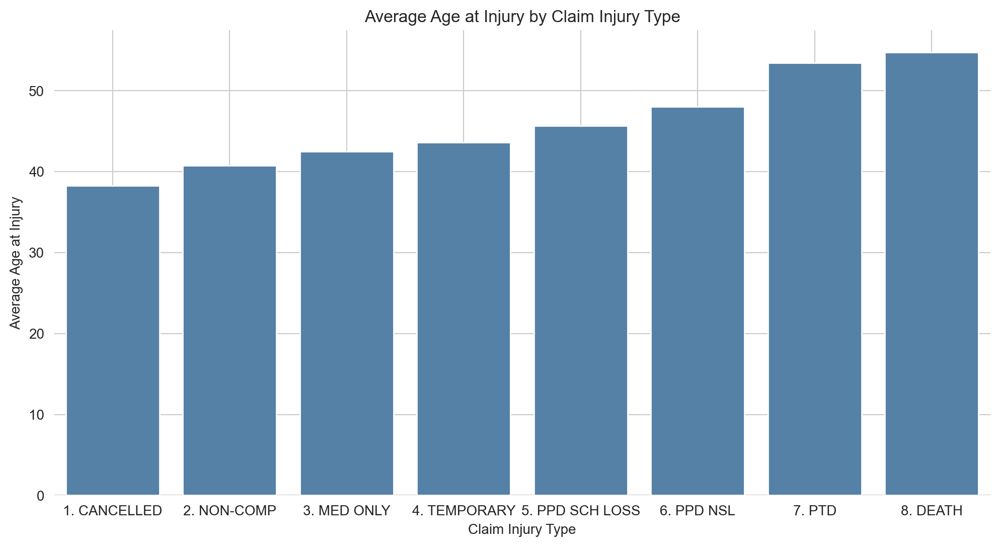

In [38]:
average_age_by_injury_type = df_train.groupby('Claim Injury Type')['Age at Injury'].mean()           # group by 'Claim Injury Type' and calculate the mean of 'Age'
plt.figure(figsize=(12, 6))
sns.barplot(x=average_age_by_injury_type.index, y=average_age_by_injury_type.values, color='#4782B4')
plt.xlabel('Claim Injury Type')
plt.ylabel('Average Age at Injury')
plt.title('Average Age at Injury by Claim Injury Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

<a class="anchor" id="3rd-bullet">

## Birth Year
    
</a>

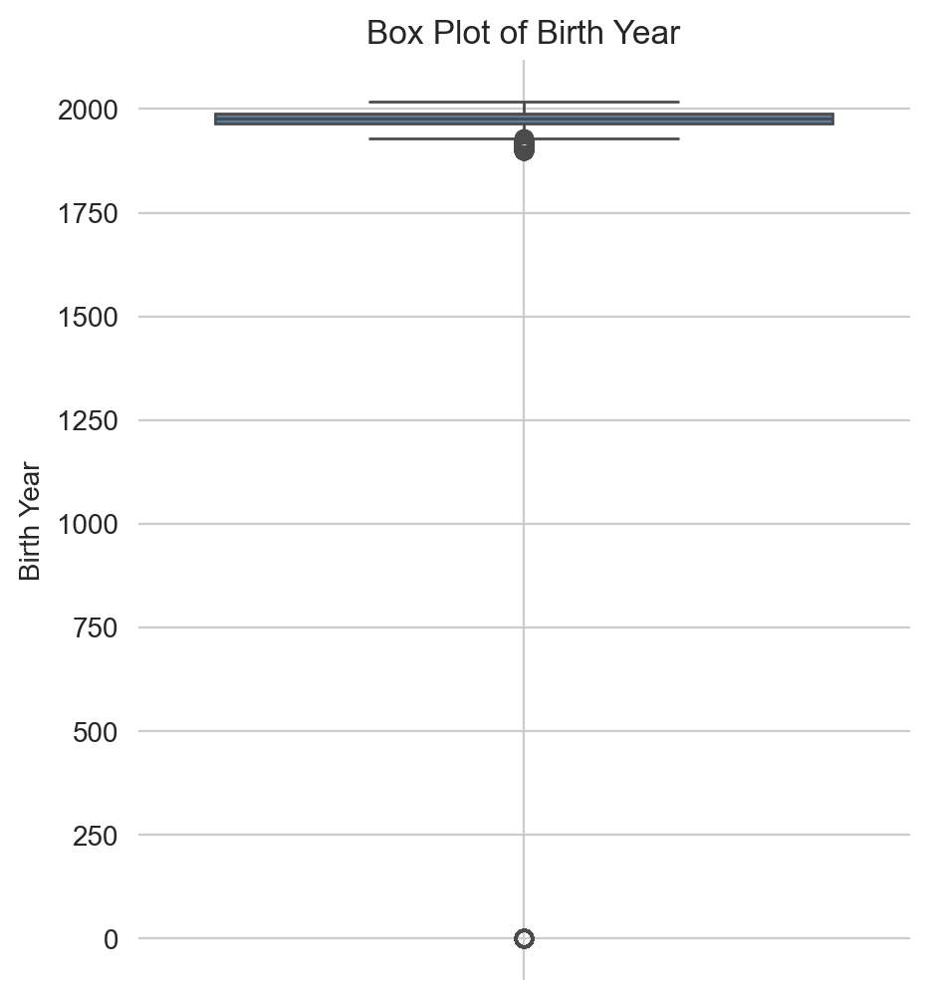

In [39]:
plt.figure(figsize=(5, 6))
sns.boxplot(y=df_train["Birth Year"], color='#4782B4')
plt.ylabel("Birth Year")
plt.title('Box Plot of Birth Year')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

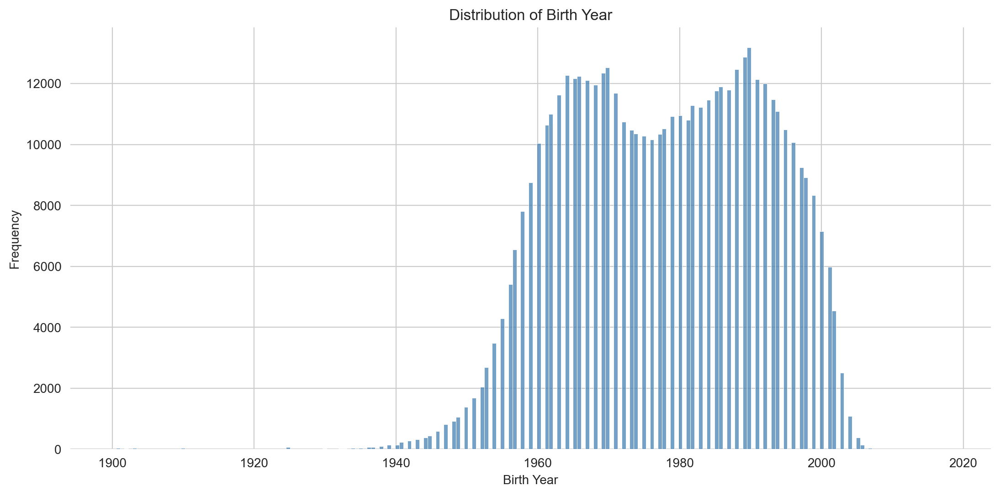

In [40]:
plt.figure(figsize=(13, 6))
df_filtered = df_train[df_train['Birth Year'] > 0]
sns.histplot(df_filtered['Birth Year'], color='#4782B4')
plt.xlabel('Birth Year')
plt.ylabel('Frequency')
plt.title('Distribution of Birth Year')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

### Check if in all rows both 'Age at Injury' and 'Birth Year' are 0

In [41]:
# Check if in all rows both 'Age at Injury' and 'Birth Year' are 0
condition = df_train[(df_train['Age at Injury'] == 0) & (df_train['Birth Year'] == 0)]
mismatch_1 = df_train[(df_train['Age at Injury'] == 0) & (df_train['Birth Year'] != 0)] # Age at Injury is 0 but Birth Year is not
mismatch_2 = df_train[(df_train['Age at Injury'] != 0) & (df_train['Birth Year'] == 0)] # Age at Injury is not 0 but Birth Year is
len(condition), len(mismatch_1), len(mismatch_2)


(1926, 3278, 23155)

- when 'Age at Injury' is 0 and 'Birth Year' is also 0 we might consider replace 0 with NaN
- when 'Age at Injury' is 0 but 'Birth Year' is not 0 we can calculate the age based on the 'Birth Year'
- when 'Age at Injury' is not 0 but 'Birth Year' is 0 we can calculate the birth year based on the 'Age at Injury'

<a class="anchor" id="3rd-bullet">

## Age Group
    
</a>

In [42]:
df_dates = df_train.copy() # df copy to explore more

In [43]:
df_dates["Age at Injury"].describe()

count     574026.0
mean      42.11427
std      14.256432
min            0.0
25%           31.0
50%           42.0
75%           54.0
max          117.0
Name: Age at Injury, dtype: Float64

In [44]:
df_dates[(df_dates["Age at Injury"] == 0)][["Claim Injury Type"]].value_counts()

Claim Injury Type
2. NON-COMP          2891
1. CANCELLED         1730
4. TEMPORARY          568
3. MED ONLY           251
5. PPD SCH LOSS        21
8. DEATH                2
6. PPD NSL              1
Name: count, dtype: int64

In [45]:
df_dates[(df_dates["Age at Injury"] == 0)].head(3)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5393971,2019-06-26,0,N,2020-01-02,N,0.0,0,NaT,NaT,AMERICAN ZURICH INSURANCE CO,1A. PRIVATE,2. NON-COMP,NASSAU,N,NYC,NaT,M,NaN,62,HEALTH CARE AND SOCIAL ASSISTANCE,IV,<NA>,NaN,<NA>,NaN,<NA>,NaN,11801,0,1
5394093,2019-12-28,0,N,2020-01-02,N,0.0,0,2019-12-30,NaT,TWIN CITY FIRE INS CO.,1A. PRIVATE,2. NON-COMP,NEW YORK,N,NYC,NaT,M,NaN,71,"ARTS, ENTERTAINMENT, AND RECREATION",IV,55,HOLDING OR CARRYING,52,STRAIN OR TEAR,61,ABDOMEN INCLUDING GROIN,NaN,0,5
5394068,NaT,0,N,2020-01-02,Y,0.0,1959,NaT,2019-12-23,STARR INDEMNITY & LIABILITY CO,1A. PRIVATE,2. NON-COMP,BRONX,N,NYC,NaT,M,NaN,23,CONSTRUCTION,IV,<NA>,NaN,<NA>,NaN,<NA>,NaN,NaN,0,6


Let´s see the cases that are above 1 and less then 10 - childs

In [46]:
df_dates[(df_dates["Age at Injury"] >= 1) & (df_dates["Age at Injury"] < 10)]["Claim Injury Type"].value_counts() 

Claim Injury Type
2. NON-COMP     11
1. CANCELLED     2
8. DEATH         1
3. MED ONLY      1
Name: count, dtype: int64

In [47]:
# Define a function to categorize based on these statistics
def categorize_age_group_initial(x):
    if x == 0:
        return "missing"
    elif 1 <= x <= 15: # to work after replace the zero ages with the median (the ones we don´t have birth year)
        return 'child'
    elif 16 <= x <= 32:
        return 'teen'
    elif 33 <= x <= 52:
        return 'adult'
    elif 53 <= x <= 75:
        return 'old_adult'
    else:
        return 'old_senior'

# Apply the function to create a new feature
df_dates['Age_Category'] = df_dates['Age at Injury'].apply(categorize_age_group_initial)

# Check the distribution of the new feature
df_dates['Age_Category'].value_counts()

Age_Category
adult         246161
teen          163380
old_adult     156394
missing         5464
old_senior      2407
child            220
Name: count, dtype: int64

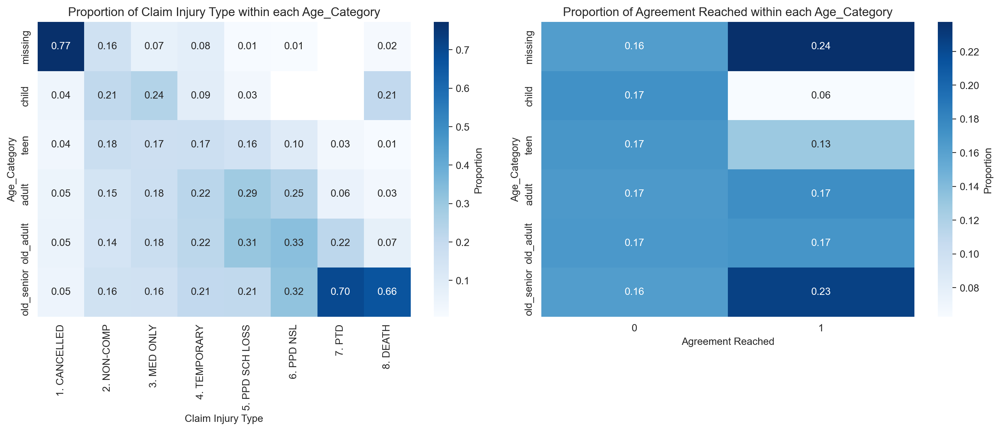

In [48]:
# Perform groupby and value_counts, then reset the index to get a DataFrame for Claim Injury Type
df_age_counts_injury = df_dates.groupby("Age_Category")[["Claim Injury Type"]].value_counts(normalize=True).reset_index(name='proportion')
df_pivot_injury = df_age_counts_injury.pivot(index='Age_Category', columns='Claim Injury Type', values='proportion')
df_pivot_injury = df_pivot_injury.div(df_pivot_injury.sum(axis=0), axis=1)

# Perform groupby and value_counts, then reset the index to get a DataFrame for Agreement Reached
df_age_counts_agreement = df_dates.groupby("Age_Category")[["Agreement Reached"]].value_counts(normalize=True).reset_index(name='proportion')
df_pivot_agreement = df_age_counts_agreement.pivot(index='Age_Category', columns='Agreement Reached', values='proportion')
df_pivot_agreement = df_pivot_agreement.div(df_pivot_agreement.sum(axis=0), axis=1)

age_category_order = ['missing', 'child', 'teen', 'adult', 'old_adult', 'old_senior']

# Sort the DataFrames by Age_Category
df_pivot_injury = df_pivot_injury.reindex(age_category_order)
df_pivot_agreement = df_pivot_agreement.reindex(age_category_order)

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.heatmap(df_pivot_injury, annot=True, fmt='.2f' ,cmap='Blues', cbar_kws={'label': 'Proportion'}, ax=axes[0])
axes[0].set_title('Proportion of Claim Injury Type within each Age_Category')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_ylabel('Age_Category')

sns.heatmap(df_pivot_agreement, annot=True, fmt='.2f' ,cmap='Blues', cbar_kws={'label': 'Proportion'}, ax=axes[1])
axes[1].set_title('Proportion of Agreement Reached within each Age_Category')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_ylabel('Age_Category')

plt.tight_layout()
plt.show()

We see that more severe injuries occur when age increases

<a class="anchor" id="3rd-bullet">

## Agreement Reached vs Claim Type of Injury: 
    
</a>

We noticed that this variable if predict well, can help the perfomance of the model since it´s 1 is more likely to be on more severe/disputed cases like from 4 to 8:

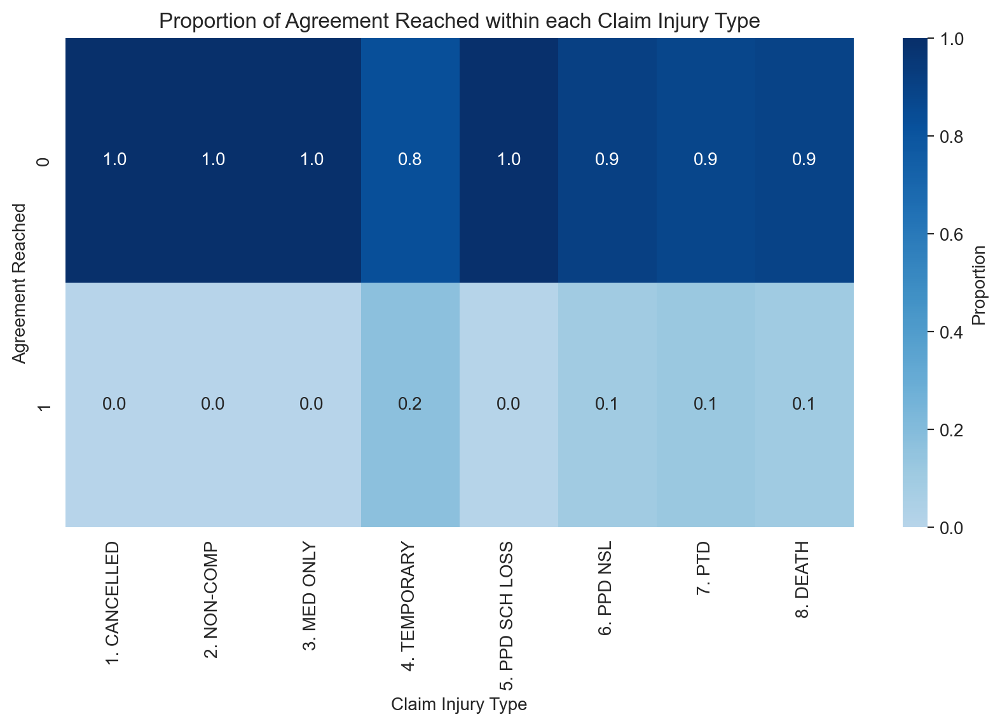

In [49]:
# Create a crosstab for proportions of "Agreement Reached" by "Claim Injury Type"
df_pivot = pd.crosstab(
    df_dates['Agreement Reached'], 
    df_dates['Claim Injury Type'], 
    normalize='columns'
)

# Plot the heatmap
plt.figure(figsize=(10, 5))
sns.heatmap(df_pivot, annot=True, fmt='.1f' ,cmap=truncated_blues, cbar_kws={'label': 'Proportion'})
plt.title('Proportion of Agreement Reached within each Claim Injury Type')
plt.xlabel('Claim Injury Type')
plt.ylabel('Agreement Reached')
plt.show()

<a class="anchor" id="3rd-bullet">

## Ime-4 Count
    
</a>

In [50]:
df_dates['IME4_binary'] = df_dates['IME-4 Count'].apply(lambda x: 1 if x > 0 else 0)
df_dates['IME4_binary'].value_counts()

IME4_binary
0    441223
1    132803
Name: count, dtype: int64

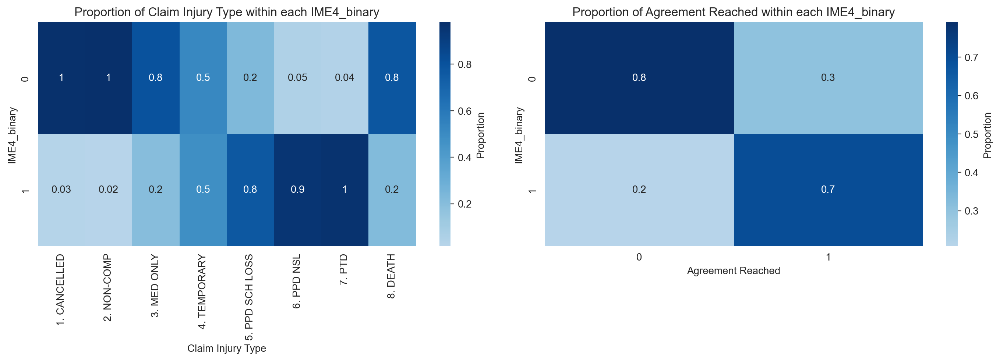

In [51]:
# Create the first crosstab for proportions of "Claim Injury Type" by "IME4_binary"
df_pivot1 = pd.crosstab(df_dates['IME4_binary'], df_dates['Claim Injury Type'], normalize='columns')

# Create the second crosstab for proportions of "Agreement Reached" by "IME4_binary"
df_pivot2 = pd.crosstab(df_dates['IME4_binary'], df_dates['Agreement Reached'], normalize='columns')

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(df_pivot1, annot=True, fmt='.1g' ,cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[0])
axes[0].set_title('Proportion of Claim Injury Type within each IME4_binary')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_ylabel('IME4_binary')

sns.heatmap(df_pivot2, annot=True, fmt='.1g' ,cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[1])
axes[1].set_title('Proportion of Agreement Reached within each IME4_binary')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_ylabel('IME4_binary')

# Adjust layout
plt.tight_layout()
plt.show()

Will not use this in model, just the binary and original one.

In [52]:
# Define a function to categorize more detail
def categorize_ime4_count(x):
    if pd.isnull(x):
        return 'missing'
    elif x == 1:
        return "one"
    else:
        return 'more_than_one'

df_dates['IME4_Category'] = df_dates['IME-4 Count'].apply(categorize_ime4_count)
df_dates['IME4_Category'].value_counts()

IME4_Category
missing          441223
more_than_one     92691
one               40112
Name: count, dtype: int64

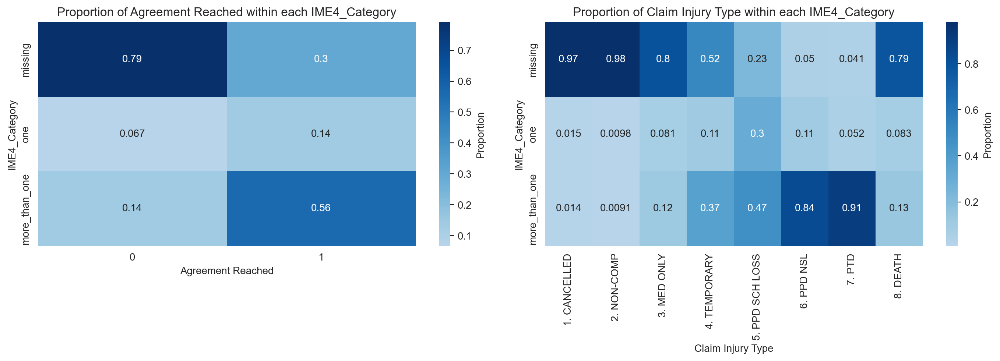

In [53]:
# Define a custom category order for IME4_Category
category_order = ['missing', 'one', 'more_than_one']
df_dates['IME4_Category'] = pd.Categorical(df_dates['IME4_Category'], categories=category_order, ordered=True)

# Create the first crosstab for proportions of "Agreement Reached" by "IME4_Category"
df_pivot1 = pd.crosstab(
    df_dates['IME4_Category'], 
    df_dates['Agreement Reached'], 
    normalize='columns')

# Create the second crosstab for proportions of "Claim Injury Type" by "IME4_Category"
df_pivot2 = pd.crosstab(
    df_dates['IME4_Category'], 
    df_dates['Claim Injury Type'], 
    normalize='columns')

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(df_pivot1, annot=True, cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[0])
axes[0].set_title('Proportion of Agreement Reached within each IME4_Category')
axes[0].set_xlabel('Agreement Reached')
axes[0].set_ylabel('IME4_Category')

sns.heatmap(df_pivot2, annot=True, cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[1])
axes[1].set_title('Proportion of Claim Injury Type within each IME4_Category')
axes[1].set_xlabel('Claim Injury Type')
axes[1].set_ylabel('IME4_Category')

plt.tight_layout()
plt.show()

Seeing this way, we can see for claim type, how well it is distributed:
- when IME-4 is missing the cases are less severe;
- when IME-4 is 1 class 3, 5, and 8 have bigger weights. 
- when IME-4 is more than 1, severe classes have a bigger weight (class 4, 6 and 7 with the highest)

<a class="anchor" id="3rd-bullet">

## C-3 Date and First Hearing Date
    
</a>

#### First Hearing Date: Due to high number of missing values - binary column: 1 if hearing date is present, 0 if missing

In [54]:
df_dates["First Hearing Date"].isnull().sum()

423228

In [55]:
df_dates['Hearing_Held'] = df_dates['First Hearing Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
df_dates['Hearing_Held'].value_counts()

Hearing_Held
0    423228
1    150798
Name: count, dtype: int64

Hearing Date is important for achieving a agreement.

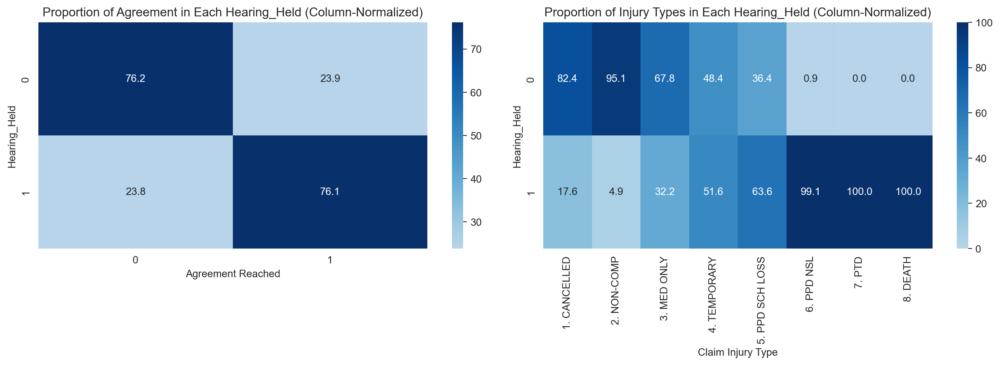

In [56]:
# Create the first crosstab for proportions of "Agreement Reached" by "Hearing_Held"
hearing_held_by_agreement_proportion = pd.crosstab(
    df_dates['Hearing_Held'], 
    df_dates['Agreement Reached'], 
    normalize='columns') * 100  # Normalize by columns so each cause sums to 1


# Create the second crosstab for proportions of "Claim Injury Type" by "Hearing_Held"
hearing_held_by_injury_type_proportion = pd.crosstab(
    df_dates['Hearing_Held'], 
    df_dates['Claim Injury Type'], 
    normalize='columns') * 100  # Normalize by columns so each cause sums to 1


# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(
    hearing_held_by_agreement_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.1f', 
    ax=axes[0])

axes[0].set_ylabel('Hearing_Held')
axes[0].set_xlabel('Agreement Reached')
axes[0].set_title('Proportion of Agreement in Each Hearing_Held (Column-Normalized)')

sns.heatmap(
    hearing_held_by_injury_type_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.1f', 
    ax=axes[1])

axes[1].set_ylabel('Hearing_Held')
axes[1].set_xlabel('Claim Injury Type')
axes[1].set_title('Proportion of Injury Types in Each Hearing_Held (Column-Normalized)')

plt.tight_layout()
plt.show()

We see that the most severe ones had a Hearing Held!!

#### C-3 Date Received: Due to high number of missing values - binary column: 1 if C3 date is present, 0 if missing

In [57]:
# Create a binary column: 1 if C-3 Date is present, 0 if missing
df_dates['C3_Received'] = df_dates['C-3 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
df_dates['C3_Received'].value_counts()

C3_Received
0    386781
1    187245
Name: count, dtype: int64

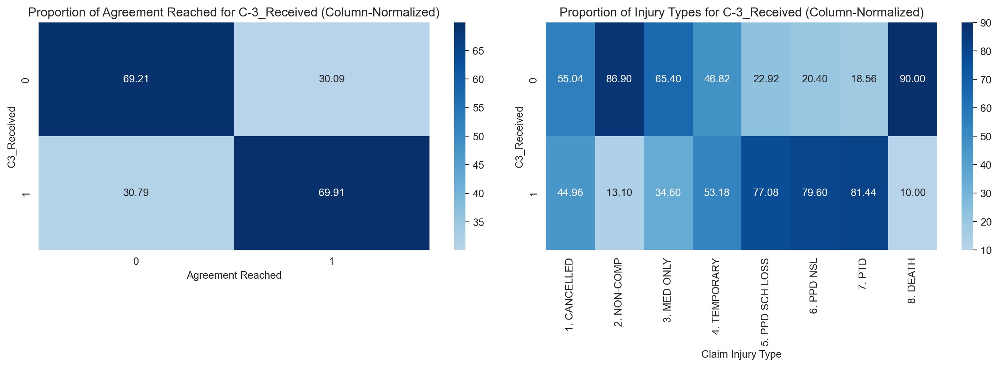

In [58]:
# Create the first crosstab for proportions of "Agreement Reached" by "C3_Received"
c3_received_by_agreement_proportion = pd.crosstab(
    df_dates['C3_Received'], 
    df_dates['Agreement Reached'], 
    normalize='columns') * 100  # Normalize by columns so each cause sums to 1


# Create the second crosstab for proportions of "Claim Injury Type" by "C3_Received"
c3_received_by_injury_type_proportion = pd.crosstab(
    df_dates['C3_Received'], 
    df_dates['Claim Injury Type'], 
    normalize='columns') * 100  # Normalize by columns so each cause sums to 1


# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(
    c3_received_by_agreement_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.2f', 
    ax=axes[0])

axes[0].set_ylabel('C3_Received')
axes[0].set_xlabel('Agreement Reached')
axes[0].set_title('Proportion of Agreement Reached for C-3_Received (Column-Normalized)')

sns.heatmap(
    c3_received_by_injury_type_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.2f', 
    ax=axes[1])

axes[1].set_ylabel('C3_Received')
axes[1].set_xlabel('Claim Injury Type')
axes[1].set_title('Proportion of Injury Types for C-3_Received (Column-Normalized)')

plt.tight_layout()
plt.show()


C-3 Also important for agreement

This is also good

<a class="anchor" id="3rd-bullet">

## Accident Date, Assembly Date and C-2 Date
    
</a>

#### Initial plots

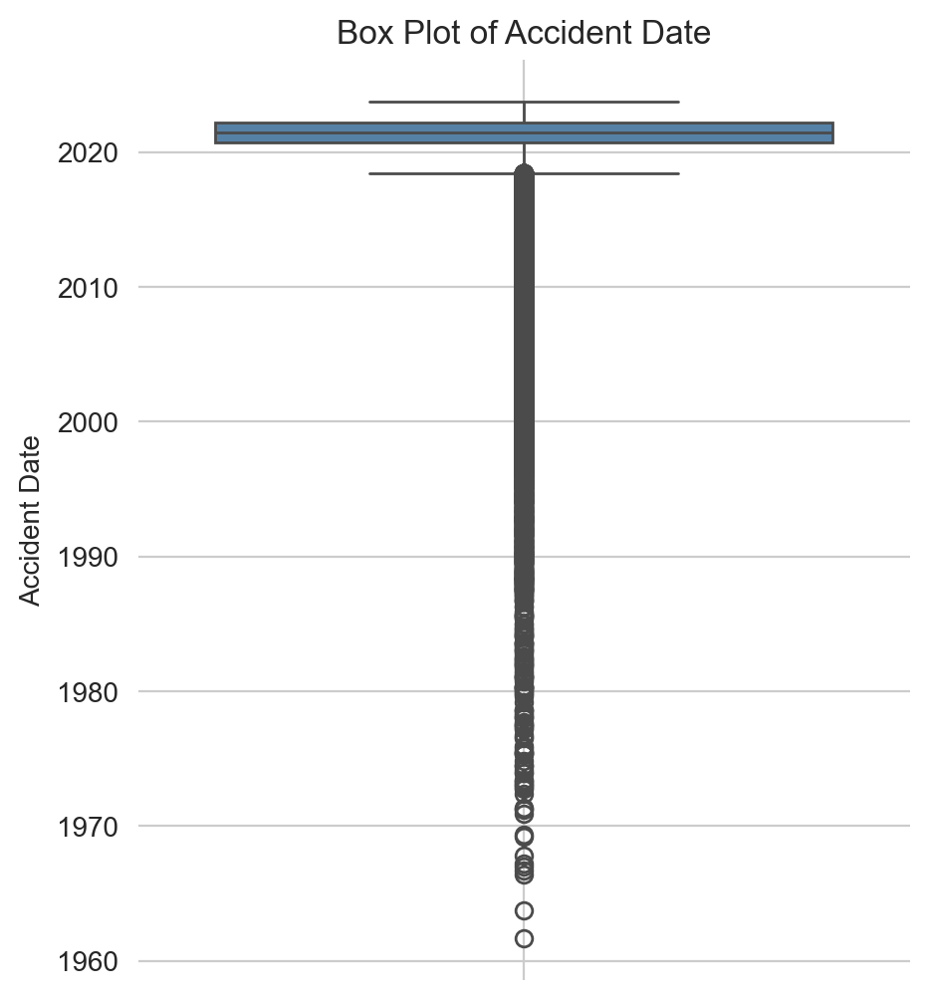

In [59]:
plt.figure(figsize=(5, 6))
sns.boxplot(y=df_train["Accident Date"], color='#4782B4')
plt.ylabel("Accident Date")
plt.title('Box Plot of Accident Date')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

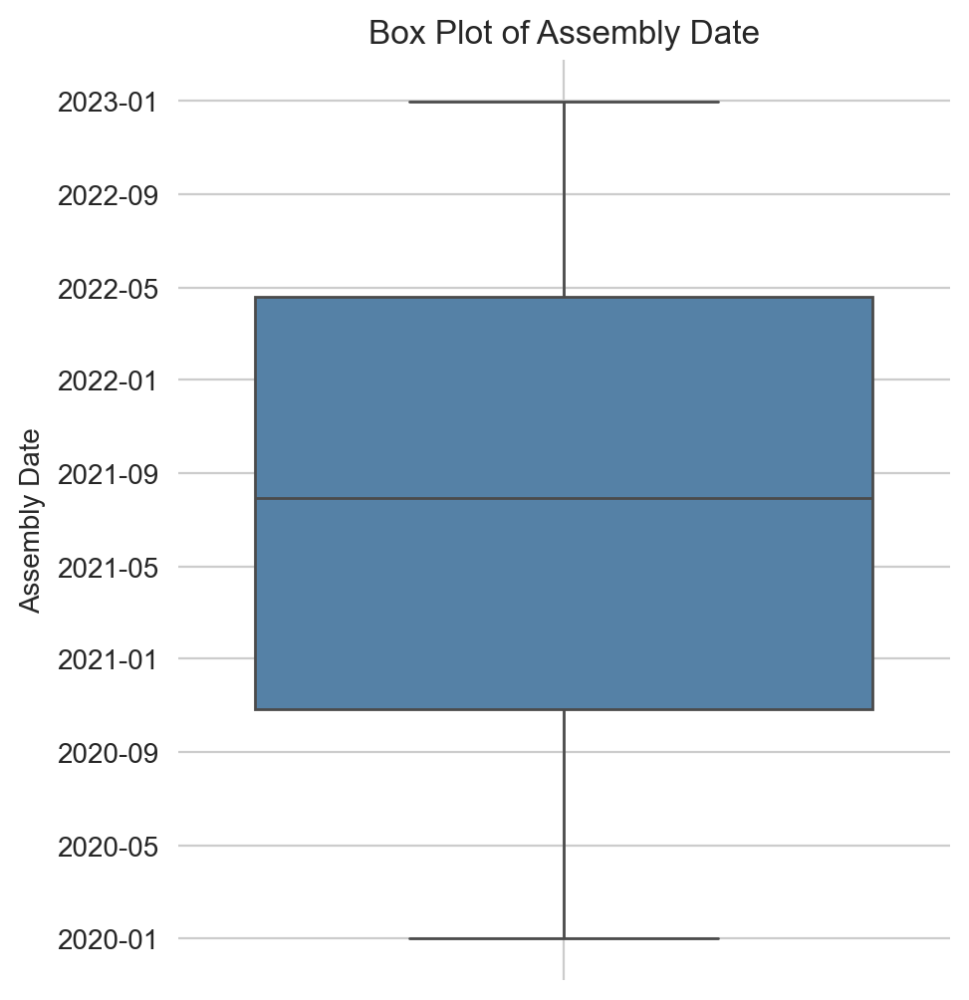

In [60]:
plt.figure(figsize=(5, 6))
sns.boxplot(y=df_train["Assembly Date"], color='#4782B4')
plt.ylabel("Assembly Date")
plt.title('Box Plot of Assembly Date')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

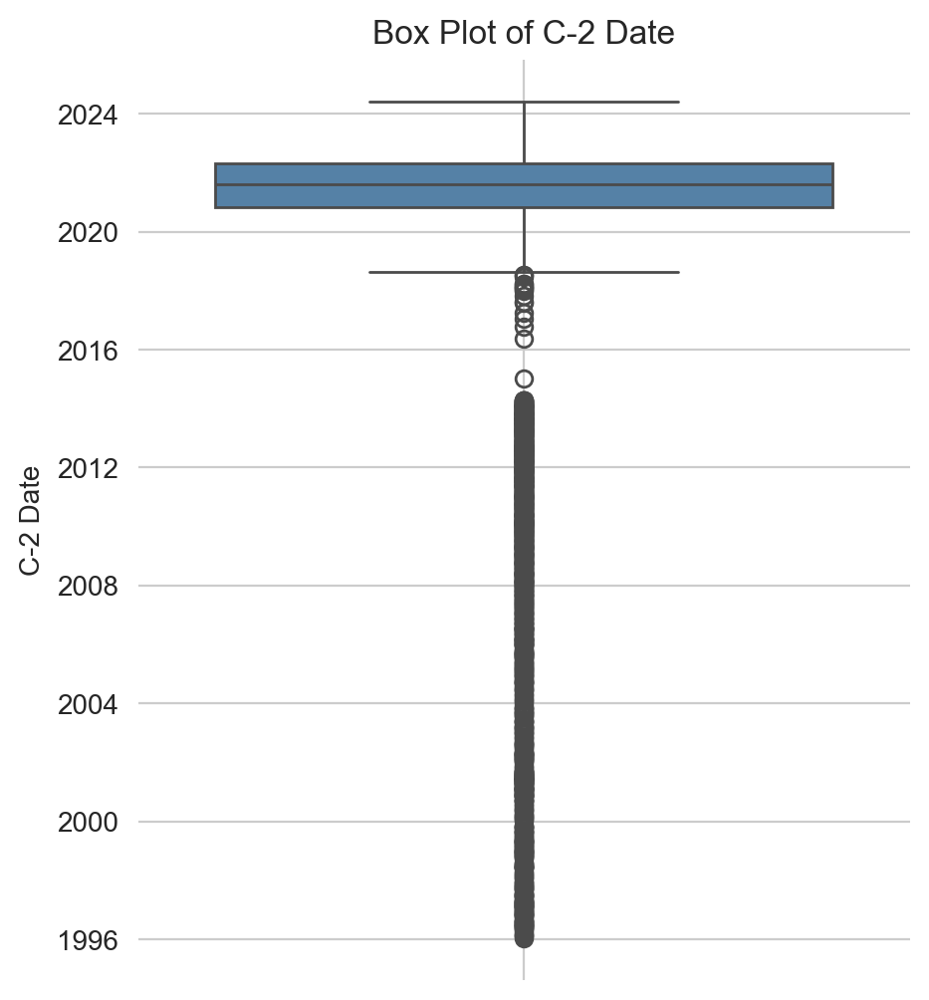

In [61]:
plt.figure(figsize=(5, 6))
sns.boxplot(y=df_train["C-2 Date"], color='#4782B4')
plt.ylabel("C-2 Date")
plt.title('Box Plot of C-2 Date')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [62]:
df_dates["Accident Date"].describe()

count                           570337
mean     2021-04-28 21:00:27.892983296
min                1961-09-06 00:00:00
25%                2020-09-14 00:00:00
50%                2021-06-27 00:00:00
75%                2022-03-21 00:00:00
max                2023-09-29 00:00:00
Name: Accident Date, dtype: object

In [63]:
df_dates["C-2 Date"].describe()

count                           559466
mean     2021-07-16 20:11:19.865442816
min                1996-01-12 00:00:00
25%                2020-11-06 00:00:00
50%                2021-08-09 00:00:00
75%                2022-04-26 00:00:00
max                2024-06-01 00:00:00
Name: C-2 Date, dtype: object

In [64]:
df_dates["Assembly Date"].describe()

count                           574026
mean     2021-07-19 19:01:36.894565888
min                2020-01-01 00:00:00
25%                2020-10-27 00:00:00
50%                2021-07-30 00:00:00
75%                2022-04-19 00:00:00
max                2022-12-31 00:00:00
Name: Assembly Date, dtype: object

Taking the descriptions of the variables into consideration, there are things that the group needed to check:
- The Accident Date should be before the C-2 Date, C-3 Date and Assembly Date, however many times one or more of those dates would be first then accident. <br>
We chose NOT to swap directly the accident date for the other first date.

#### C-2 Date Present:

In [65]:
# Create a binary feature for the presence of C-2 date
df_dates['C2_Received'] = df_dates['C-2 Date'].notnull().astype(int)
df_dates['C2_Received'].value_counts()

C2_Received
1    559466
0     14560
Name: count, dtype: int64

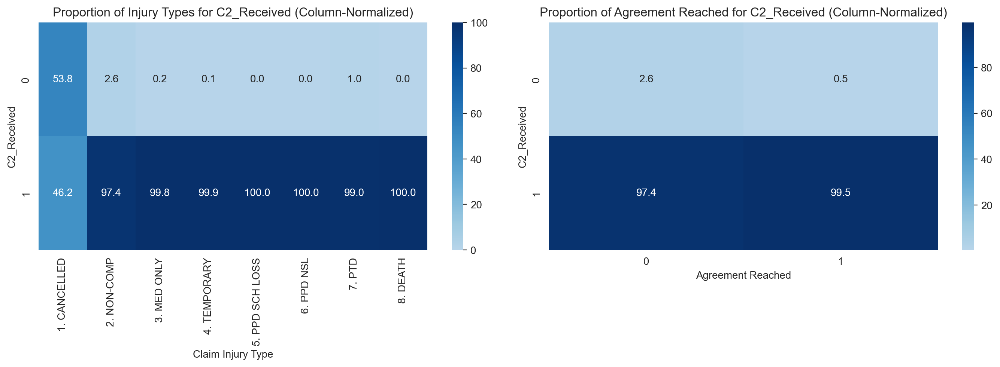

In [66]:
# Create the first crosstab for proportions of "Claim Injury Type" by "C2_Received"
C2_date_present_by_injury_type_proportion = pd.crosstab(df_dates['C2_Received'], df_dates['Claim Injury Type'], normalize='columns') * 100  # Normalize by columns so each cause sums to 1

# Create the second crosstab for proportions of "Agreement Reached" by "C2_Received"
C2_date_present_by_agreement_proportion = pd.crosstab(df_dates['C2_Received'], df_dates['Agreement Reached'], normalize='columns') * 100  # Normalize by columns so each cause sums to 1

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(C2_date_present_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[0])

axes[0].set_ylabel('C2_Received')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types for C2_Received (Column-Normalized)')

sns.heatmap(C2_date_present_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[1])

axes[1].set_ylabel('C2_Received')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached for C2_Received (Column-Normalized)')

plt.tight_layout()
plt.show()

When it´s 1. Cancelled, we have more than 50% of people that didn´t have a C2 submitted by employer 

#### Accident Date Present:

In [67]:
# Create a binary feature for the presence of C-2 date
df_dates['Accident_date_present'] = df_dates['Accident Date'].notnull().astype(int)
df_dates['Accident_date_present'].value_counts()

Accident_date_present
1    570337
0      3689
Name: count, dtype: int64

In [68]:
df_dates[df_dates["Accident_date_present"] == 0].tail(5) # see where there is no accident date

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
6163633,NaT,0,N,2022-12-29,Y,0.0,1967,NaT,2022-12-21,STATE INSURANCE FUND,2A. SIF,1. CANCELLED,QUEENS,N,NYC,NaT,F,NaN,<NA>,NaN,IV,<NA>,NaN,<NA>,NaN,<NA>,NaN,11422,0,1,missing,0,missing,0,1,0,0
6164216,NaT,0,N,2022-12-30,Y,0.0,1961,2023-01-10,2022-12-27,COUNTY OF NASSAU,3A. SELF PUBLIC,2. NON-COMP,NASSAU,N,NYC,2023-02-17,M,NaN,92,PUBLIC ADMINISTRATION,IV,52,CONTINUAL NOISE,31,HEARING LOSS OR IMPAIRMENT,13,EAR(S),11756,0,0,missing,0,missing,1,1,1,0
6164179,NaT,0,N,2022-12-30,Y,0.0,0,2023-01-10,2022-12-28,NYC TRANSIT AUTHORITY,3A. SELF PUBLIC,2. NON-COMP,SUFFOLK,N,HAUPPAUGE,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,UK,99,"OTHER - MISCELLANEOUS, NOC",78,CARPAL TUNNEL SYNDROME,-9,MULTIPLE,22473,0,3,missing,0,missing,0,1,1,0
6164933,NaT,0,N,2022-12-30,Y,0.0,1972,2023-01-20,2022-12-22,LM INSURANCE CORP,1A. PRIVATE,2. NON-COMP,KINGS,N,NYC,NaT,M,NaN,23,CONSTRUCTION,IV,60,"STRAIN OR INJURY BY, NOC",78,CARPAL TUNNEL SYNDROME,39,WRIST (S) & HAND(S),11221,0,6,missing,0,missing,0,1,1,0
6164931,NaT,0,N,2022-12-30,Y,0.0,1957,NaT,2022-12-27,"CNY OTHER THAN ED, HED WATER",3A. SELF PUBLIC,1. CANCELLED,KINGS,N,NYC,NaT,M,NaN,<NA>,NaN,IV,<NA>,NaN,<NA>,NaN,<NA>,NaN,11221,0,0,missing,0,missing,0,1,0,0


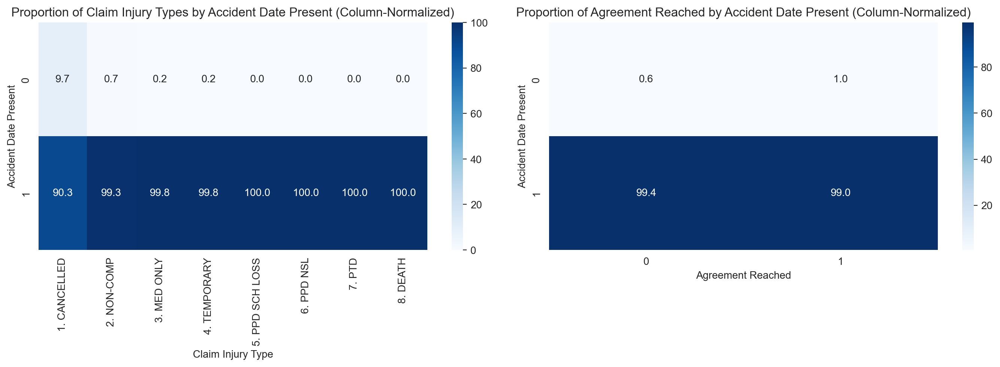

In [69]:
# Create the first crosstab for proportions of "Claim Injury Type" by "Accident_date_present"
Accident_date_present_by_injury_type_proportion = pd.crosstab(df_dates['Accident_date_present'], df_dates['Claim Injury Type'], normalize='columns') * 100  # Normalize by columns so each cause sums to 1

# Create the second crosstab for proportions of "Agreement Reached" by "Accident_date_present"
Accident_date_present_by_agreement_proportion = pd.crosstab(df_dates['Accident_date_present'], df_dates['Agreement Reached'], normalize='columns') * 100  # Normalize by columns so each cause sums to 1

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(Accident_date_present_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])

axes[0].set_ylabel('Accident Date Present')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Types by Accident Date Present (Column-Normalized)')

sns.heatmap(Accident_date_present_by_agreement_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])

axes[1].set_ylabel('Accident Date Present')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached by Accident Date Present (Column-Normalized)')

plt.tight_layout()
plt.show()


#### c2_to_accident_delay

In [70]:
df_dates['c2_to_accident_delay'] = (df_dates['C-2 Date'] - df_dates['Accident Date']).dt.days

In [71]:
df_dates['c2_to_accident_delay'].min()

-8842.0

See examples where C2 was first then accident date. In first row, all 3 dates are before accident, so we cant tell by who to replace

In [72]:
df_dates[df_dates['c2_to_accident_delay'] < 0].tail(5)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,c2_to_accident_delay
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
6156163,2023-01-26,56,N,2022-12-16,Y,2191.97,1966,2022-12-16,NaT,STATE INSURANCE FUND,2A. SIF,3. MED ONLY,LEWIS,N,SYRACUSE,2024-04-25,M,NaN,92,PUBLIC ADMINISTRATION,I,57,PUSHING OR PULLING,52,STRAIN OR TEAR,-9,MULTIPLE,13316,0,5,old_adult,0,missing,1,0,1,1,-41.0
6158378,2022-12-27,41,N,2022-12-20,Y,746.80,1981,2022-12-20,2022-12-20,AMERICAN GUAR & LIAB INS CO,1A. PRIVATE,3. MED ONLY,WYOMING,N,ROCHESTER,2023-03-17,F,1.0,52,FINANCE AND INSURANCE,I,60,"STRAIN OR INJURY BY, NOC",49,SPRAIN OR TEAR,35,HAND,14569,0,6,adult,1,one,1,1,1,1,-7.0
6160613,2023-02-07,51,N,2022-12-22,Y,1646.06,1971,2022-12-22,2022-12-02,LIBERTY INSURANCE CORP.,1A. PRIVATE,3. MED ONLY,NIAGARA,N,BUFFALO,2023-03-09,M,NaN,32,MANUFACTURING,I,97,REPETITIVE MOTION,78,CARPAL TUNNEL SYNDROME,35,HAND,14092,0,3,adult,0,missing,1,1,1,1,-47.0
6162010,2023-02-02,52,N,2022-12-26,Y,992.39,1970,2022-12-26,NaT,MASSACHUSETTS BAY INS.CO.C/O,1A. PRIVATE,3. MED ONLY,ONEIDA,N,SYRACUSE,2023-11-16,M,3.0,53,REAL ESTATE AND RENTAL AND LEASING,II,97,REPETITIVE MOTION,52,STRAIN OR TEAR,39,WRIST (S) & HAND(S),13501,0,6,adult,1,more_than_one,1,0,1,1,-38.0
6162263,2022-12-28,55,N,2022-12-26,N,0.00,1967,2022-12-26,NaT,STATE INSURANCE FUND,2A. SIF,2. NON-COMP,BRONX,N,NYC,NaT,F,NaN,62,HEALTH CARE AND SOCIAL ASSISTANCE,UK,31,"FALL, SLIP OR TRIP, NOC",52,STRAIN OR TEAR,42,LOWER BACK AREA,07407,0,3,old_adult,0,missing,0,0,1,1,-2.0


In [73]:
df_dates['c2_to_accident_delay'] = (df_dates['C-2 Date'] - df_dates['Accident Date']).dt.days

# Function to categorize c2_to_accident_delay using quartiles and additional conditions
def categorize_c2_to_accident_delay(delay):
    if pd.isnull(delay):
        return 'Undetermined' # neither one or one of them is missing - we can also create 2 placeholders to distinguish the null values of Accident vs C-2
    elif delay < 0:
        return 'C2_First'
    elif 0 <= delay <= 10: # we saw info about this 10 days so we decided to try it out
        return 'In_time'
    else:
        return 'Over_time'

# Apply the function to categorize the delay

df_dates['c2_to_accident_delay_category'] = df_dates['c2_to_accident_delay'].apply(categorize_c2_to_accident_delay)
df_dates[['Accident Date', 'C-2 Date', 'c2_to_accident_delay', 'c2_to_accident_delay_category', 'Accident_date_present', 'C2_Received']].head()

,Accident Date,C-2 Date,c2_to_accident_delay,c2_to_accident_delay_category,Accident_date_present,C2_Received
Claim Identifier,,,,,,
5393875,2019-12-30,2019-12-31,1.0,In_time,1,1
5393091,2019-08-30,2020-01-01,124.0,Over_time,1,1
5393889,2019-12-06,2020-01-01,26.0,Over_time,1,1
5393887,2019-12-30,2019-12-31,1.0,In_time,1,1
5393863,2019-12-26,2019-12-31,5.0,In_time,1,1


In [74]:
df_dates['c2_to_accident_delay_category'].value_counts()

c2_to_accident_delay_category
In_time         290383
Over_time       265981
Undetermined     16680
C2_First           982
Name: count, dtype: int64

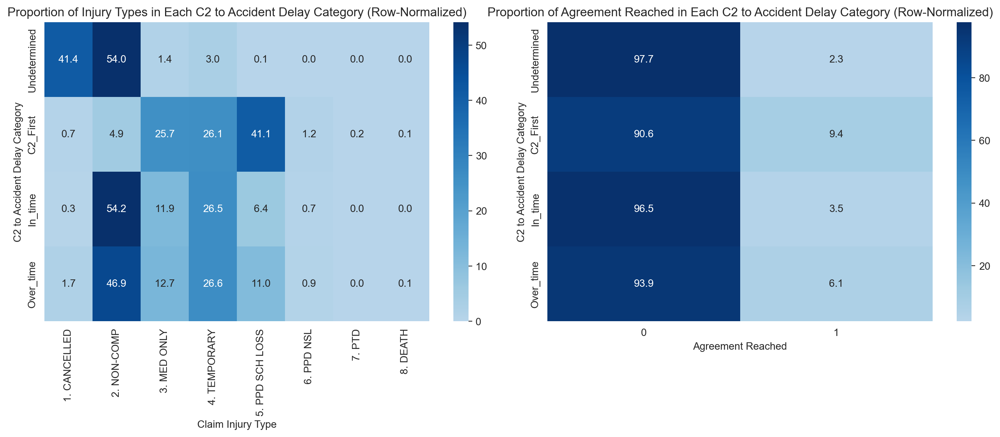

In [75]:
category_order = ['Undetermined', 'C2_First', 'In_time', 'Over_time']

# Convert 'c2_to_accident_delay_category' to a categorical type with the specified order
df_dates['c2_to_accident_delay_category'] = pd.Categorical(
    df_dates['c2_to_accident_delay_category'], 
    categories=category_order, 
    ordered=True)

# Create the first crosstab for proportions of "Claim Injury Type" by "c2_to_accident_delay_category"
c2_to_accident_delay_category_by_injury_type_proportion = pd.crosstab(
    df_dates['c2_to_accident_delay_category'], 
    df_dates['Claim Injury Type'], 
    normalize='index') * 100  # Normalize by rows so each category sums to 1


# Create the second crosstab for proportions of "Agreement Reached" by "c2_to_accident_delay_category"
c2_to_accident_delay_category_by_agreement_proportion = pd.crosstab(
    df_dates['c2_to_accident_delay_category'], 
    df_dates['Agreement Reached'], 
    normalize='index') * 100  # Normalize by rows so each category sums to 1


# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.heatmap(
    c2_to_accident_delay_category_by_injury_type_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.1f', 
    ax=axes[0])

axes[0].set_ylabel('C2 to Accident Delay Category')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types in Each C2 to Accident Delay Category (Row-Normalized)')

sns.heatmap(
    c2_to_accident_delay_category_by_agreement_proportion, 
    cmap=truncated_blues, 
    annot=True, 
    fmt='.1f', 
    ax=axes[1])

axes[1].set_ylabel('C2 to Accident Delay Category')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached in Each C2 to Accident Delay Category (Row-Normalized)')

plt.tight_layout()
plt.show()


We see a that when C2 was first, the Claim Type distribution is different...

#### Assembly delay:

In [76]:
df_dates[df_dates['Accident Date'] > df_dates["Assembly Date"]].head(2)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,c2_to_accident_delay,c2_to_accident_delay_category
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5393953,2020-02-26,57,N,2020-01-01,Y,1997.87,1962,2019-12-31,2020-01-31,"CNY OTHER THAN ED, HED WATER",3A. SELF PUBLIC,5. PPD SCH LOSS,KINGS,N,NYC,2020-05-04,M,NaN,92,PUBLIC ADMINISTRATION,IV,97,REPETITIVE MOTION,71,"ALL OTHER OCCUPATIONAL DISEASE INJURY, NOC",31,UPPER ARM,11226,0,0,old_adult,0,missing,1,1,1,1,-57.0,C2_First
5394099,2020-01-23,62,N,2020-01-02,Y,1775.89,1957,2020-01-14,2019-12-27,NYC TRANSIT AUTHORITY,3A. SELF PUBLIC,6. PPD NSL,QUEENS,N,NYC,2020-06-05,M,2.0,48,TRANSPORTATION AND WAREHOUSING,IV,99,"OTHER - MISCELLANEOUS, NOC",71,"ALL OTHER OCCUPATIONAL DISEASE INJURY, NOC",90,MULTIPLE BODY PARTS (INCLUDING BODY,11001,0,3,old_adult,1,more_than_one,1,1,1,1,-9.0,C2_First


In [77]:
assembled_before_acident = df_dates[df_dates['Accident Date'] > df_dates["Assembly Date"]] # check if 'Accident Date' is on or after 'Assembly Date'
c2_before_acident = df_dates[df_dates['Accident Date'] > df_dates["C-2 Date"]]             # check if 'Accident Date' is on or after 'C-2 Date'

common_cases = pd.concat([c2_before_acident, assembled_before_acident]) # combining rows where 'Accident Date' is on or after 'C-2 Date' and 'Assembly Date'
common_cases = common_cases[common_cases.duplicated()]

print(f"Number of rows with Accident Date after C-2 Date: {len(c2_before_acident)}")
print(f"Number of rows with Accident Date on or after Assembly Date: {len(assembled_before_acident)}")
print(f"Number of common rows: {len(common_cases)}")

Number of rows with Accident Date after C-2 Date: 982
Number of rows with Accident Date on or after Assembly Date: 1407
Number of common rows: 897


In [78]:
# Calculate the difference between Assembly Date and Accident Date
df_dates['assembly_delay'] = (df_dates['Assembly Date'] - df_dates['Accident Date']).dt.days

# Handle negative values
df_dates.loc[pd.isnull(df_dates['assembly_delay']), 'assembly_delay'] = -999 # placeholder

# Calculate quartiles for possible categorization
q1 = df_dates[df_dates['assembly_delay'] > 0]['assembly_delay'].quantile(0.25)
q2 = df_dates[df_dates['assembly_delay'] > 0]['assembly_delay'].median()
q3 = df_dates[df_dates['assembly_delay'] > 0]['assembly_delay'].quantile(0.75)

def categorize_assembly_delay(delay):
    if delay == -999:
        return 'No_accident_date'
    elif delay < 0:
        return 'Cumulative'
    elif 0 <= delay <= q1:
        return 'Short_Delay'
    elif q1 < delay <= q3:
        return 'Median_Delay'
    else:
        return 'Long_Delay'

# Apply the function to the dataset
df_dates['assembly_delay_category'] = df_dates['assembly_delay'].apply(categorize_assembly_delay)
df_dates[['Accident Date', 'Assembly Date', 'assembly_delay', 'assembly_delay_category']].head()


,Accident Date,Assembly Date,assembly_delay,assembly_delay_category
Claim Identifier,,,,
5393875,2019-12-30,2020-01-01,2.0,Short_Delay
5393091,2019-08-30,2020-01-01,124.0,Long_Delay
5393889,2019-12-06,2020-01-01,26.0,Long_Delay
5393887,2019-12-30,2020-01-01,2.0,Short_Delay
5393863,2019-12-26,2020-01-01,6.0,Median_Delay


In [79]:
df_dates['assembly_delay_category'].value_counts()

assembly_delay_category
Median_Delay        270304
Short_Delay         160205
Long_Delay          138421
No_accident_date      3689
Cumulative            1407
Name: count, dtype: int64

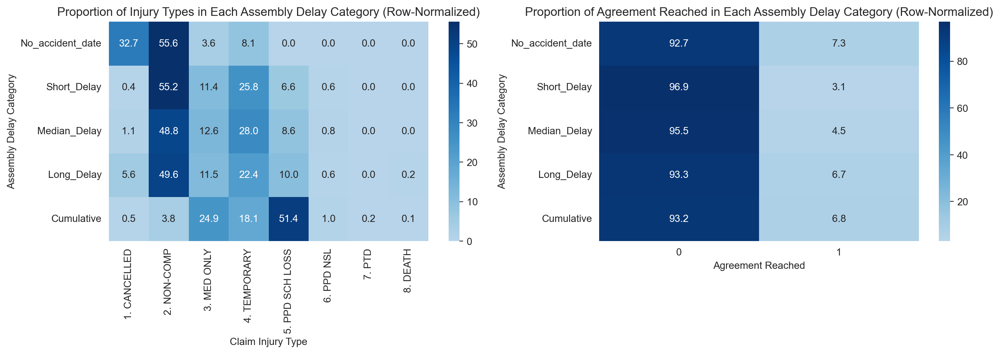

In [80]:
assembly_delay_category_by_injury_type_proportion = pd.crosstab(df_dates['assembly_delay_category'], df_dates['Claim Injury Type'], normalize='index') * 100 

sorted_index = ['No_accident_date', 'Short_Delay', 'Median_Delay', 'Long_Delay', 'Cumulative']
assembly_delay_category_by_injury_type_proportion = assembly_delay_category_by_injury_type_proportion.reindex(sorted_index)

assembly_delay_category_by_agreement_proportion = pd.crosstab(df_dates['assembly_delay_category'], df_dates['Agreement Reached'], normalize='index') * 100  

# Sort the index (assembly_delay_category) in a specific order
assembly_delay_category_by_agreement_proportion = assembly_delay_category_by_agreement_proportion.reindex(sorted_index)

# Create subplot
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(assembly_delay_category_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Assembly Delay Category')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types in Each Assembly Delay Category (Row-Normalized)')

sns.heatmap(assembly_delay_category_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('Assembly Delay Category')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached in Each Assembly Delay Category (Row-Normalized)')

plt.tight_layout()
plt.show()


#### C-3 Date delay:

In [81]:
df_dates['C-3 Date'].describe()

count                           187245
mean     2021-07-26 21:31:28.449892096
min                1992-11-13 00:00:00
25%                2020-10-27 00:00:00
50%                2021-07-21 00:00:00
75%                2022-04-20 00:00:00
max                2024-05-31 00:00:00
Name: C-3 Date, dtype: object

In [82]:
# Calculate the difference between C-3 Date and Accident Date
df_dates['c3_to_accident_delay'] = (df_dates['C-3 Date'] - df_dates['Accident Date']).dt.days

# Handle missing values in C-3 Date using the C3_date_present column
df_dates.loc[(df_dates['C3_Received'] == 1) & (df_dates['Accident_date_present'] == 0), 'c3_to_accident_delay'] = -10000 # placeholders

# Handle missing values in Accident Date using the Accident_date_present column
df_dates.loc[(df_dates['C3_Received'] == 0) & (df_dates['Accident_date_present'] == 1), 'c3_to_accident_delay'] = -9999

# Function to categorize c3_to_accident_delay using quartiles
def categorize_c3_to_accident_delay(delay):
    if delay == -10000:
        return 'No_accident_date'
    elif delay == -9999:
        return "No_C3"
    elif delay < 0:
        return "C3_first"
    elif 0 <= delay <= 30:
        return 'Short_Delay'
    elif 31 <= delay <= 731:  # 2 years time
        return 'Medium_Delay'
    else:
        return 'Overdue'

# Apply the function to categorize the delay
df_dates['c3_to_accident_delay_category'] = df_dates['c3_to_accident_delay'].apply(categorize_c3_to_accident_delay)

In [83]:
df_dates['c3_to_accident_delay_category'].value_counts()

c3_to_accident_delay_category
No_C3               386539
Short_Delay          98913
Medium_Delay         81348
No_accident_date      3447
Overdue               2490
C3_first              1289
Name: count, dtype: int64

In [84]:
df_dates[df_dates['c3_to_accident_delay'] < 0][["Claim Injury Type"]].value_counts(normalize=0)

Claim Injury Type
2. NON-COMP          254932
4. TEMPORARY          70017
3. MED ONLY           45505
5. PPD SCH LOSS       11765
1. CANCELLED           7740
6. PPD NSL              873
8. DEATH                423
7. PTD                   20
Name: count, dtype: int64

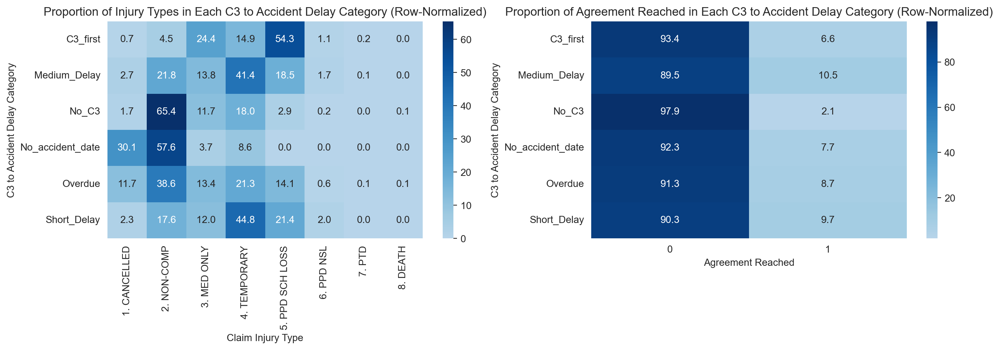

In [85]:
# Create the first crosstab for proportions of "Claim Injury Type" by "c3_to_accident_delay_category"
c3_to_accident_delay_category_by_injury_type_proportion = pd.crosstab(df_dates['c3_to_accident_delay_category'], df_dates['Claim Injury Type'], normalize='index') * 100

# Create the second crosstab for proportions of "Agreement Reached" by "c3_to_accident_delay_category"
c3_to_accident_delay_category_by_agreement_proportion = pd.crosstab(
    df_dates['c3_to_accident_delay_category'], 
    df_dates['Agreement Reached'], 
    normalize='index') * 100

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(c3_to_accident_delay_category_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('C3 to Accident Delay Category')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types in Each C3 to Accident Delay Category (Row-Normalized)')

sns.heatmap(c3_to_accident_delay_category_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('C3 to Accident Delay Category')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached in Each C3 to Accident Delay Category (Row-Normalized)')

plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## Month and Year of Injury variables
    
</a>

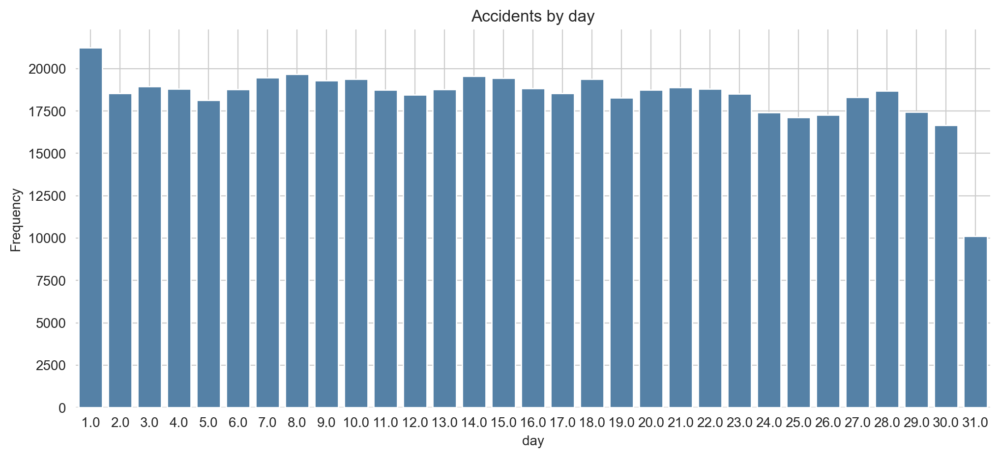

In [86]:
# Check the frequencies of the accidents by months
accidents_by_day = df_dates['Accident Date'].dt.day.value_counts().sort_index()

plt.figure(figsize=(12, 5))
sns.barplot(x=accidents_by_day.index, y=accidents_by_day.values, color='#4782B4')
plt.xlabel('day')
plt.ylabel('Frequency')
plt.title('Accidents by day')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

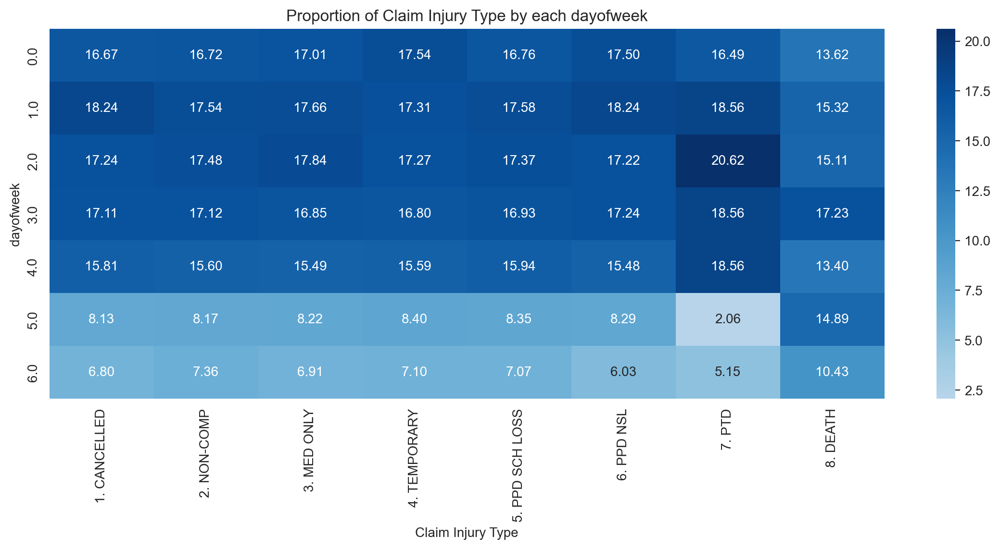

In [87]:
# Extract the quarter from 'Accident Date'
df_dates['Accident_day_of_week'] = df_dates['Accident Date'].dt.dayofweek

# Create a crosstab for 'Accident Quarter' and 'Claim Injury Type'
day_by_injury_type_proportion = pd.crosstab(df_dates['Accident_day_of_week'], df_dates['Claim Injury Type'], normalize='columns') * 100

plt.figure(figsize=(14, 5))
sns.heatmap(day_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.2f')
plt.xlabel('Claim Injury Type')
plt.ylabel('dayofweek')
plt.title('Proportion of Claim Injury Type by each dayofweek')
plt.show()

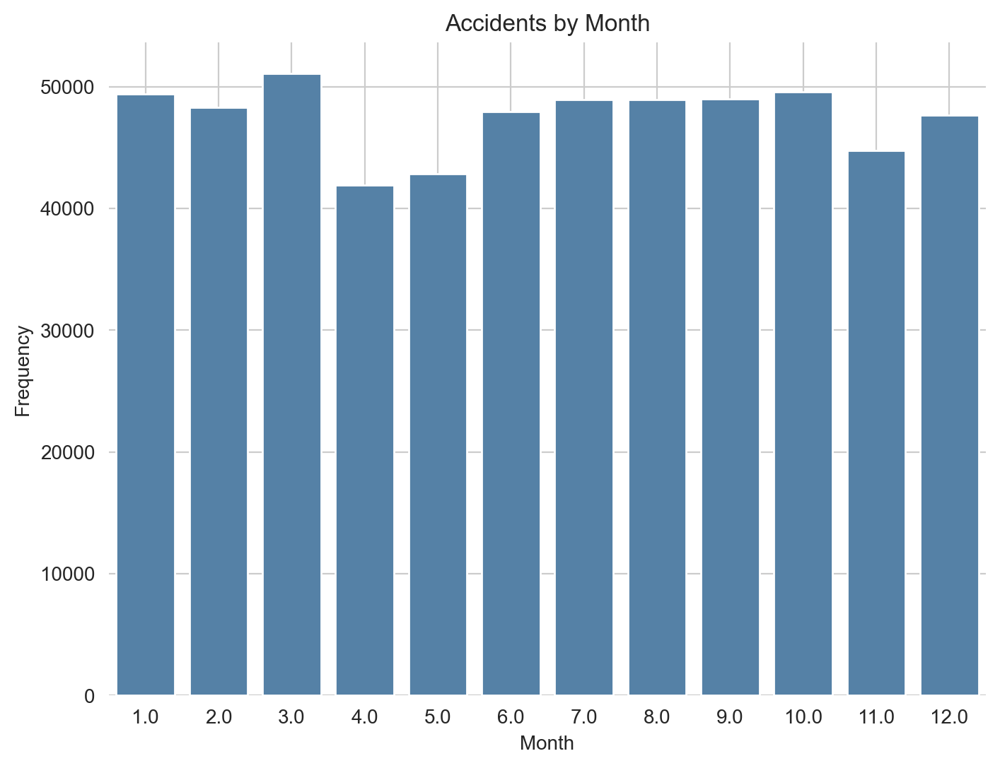

In [88]:
# Check the frequencies of the accidents by months
accidents_by_month = df_dates['Accident Date'].dt.month.value_counts().sort_index()

plt.figure(figsize=(8, 6))
sns.barplot(x=accidents_by_month.index, y=accidents_by_month.values, color='#4782B4')
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.title('Accidents by Month')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

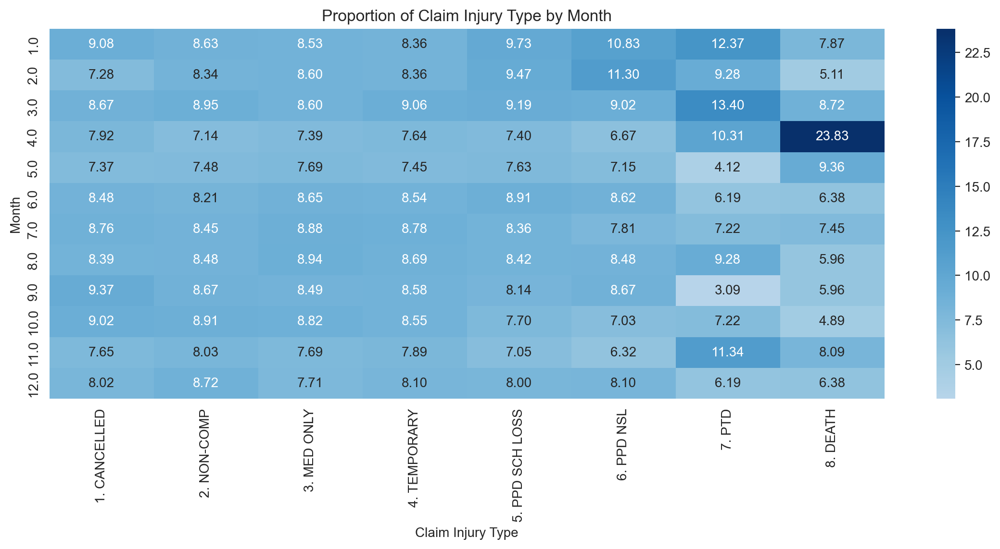

In [89]:
# Extract the month from 'Accident Date'
df_dates['Accident Month'] = df_dates['Accident Date'].dt.month

# Create a crosstab for 'Accident Month' and 'Claim Injury Type'
month_by_injury_type_proportion = pd.crosstab(df_dates['Accident Month'], df_dates['Claim Injury Type'], normalize='columns') * 100

# Plot the heatmap
plt.figure(figsize=(14, 5))
sns.heatmap(month_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.2f')
plt.xlabel('Claim Injury Type')
plt.ylabel('Month')
plt.title('Proportion of Claim Injury Type by Month')
plt.show()


In [90]:
# Define a function to categorize accident years with explicit elif conditions
def categorize_accident_year(year):
    if pd.isnull(year):
        return 'missing'
    elif year < 1960:
        return 'before_1960'
    elif 1960 <= year <= 1969:
        return '1960-1969'
    elif 1970 <= year <= 1979:
        return '1970-1979'
    elif 1980 <= year <= 1989:
        return '1980-1989'
    elif 1990 <= year <= 1999:
        return '1990-1999'
    elif 2000 <= year <= 2009:
        return '2000-2009'
    elif 2010 <= year <= 2019:
        return '2010-2019'
    elif 2020 <= year <= 2029:
        return '2020-2029'
    else:
        return 'after_2030'

df_dates['Accident_Year'] = df_dates['Accident Date'].dt.year

# Apply the function to categorize the years
df_dates['Accident_Year_Category'] = df_dates['Accident_Year'].apply(categorize_accident_year)

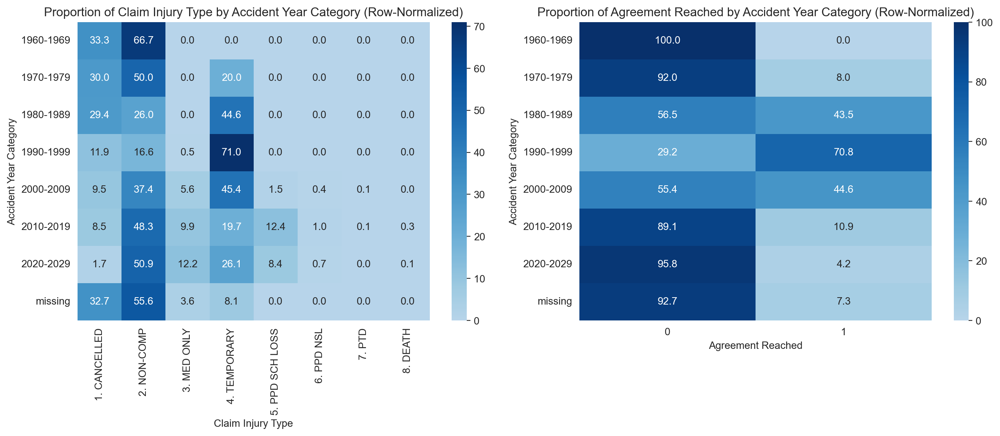

In [91]:
year_cat_by_injury_type_proportion = pd.crosstab(df_dates['Accident_Year_Category'], df_dates['Claim Injury Type'], normalize='index') * 100

year_cat_by_agreement_proportion = pd.crosstab(df_dates['Accident_Year_Category'], df_dates['Agreement Reached'], normalize='index') * 100

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.heatmap(year_cat_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Accident Year Category')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Type by Accident Year Category (Row-Normalized)')

sns.heatmap(year_cat_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('Accident Year Category')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached by Accident Year Category (Row-Normalized)')

plt.tight_layout()
plt.show()


We can also see some different behaviours alongside the period of years.

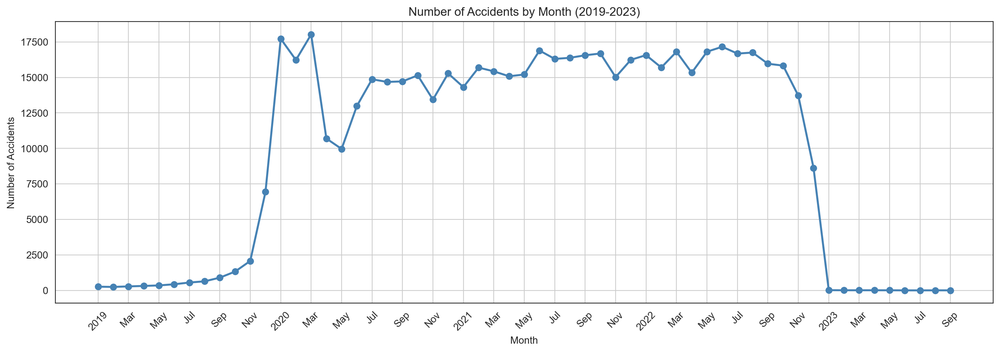

In [92]:
df_filtered = df_dates[df_dates['Accident Date'].dt.to_period('M') >= '2019-01']
accidents_by_month = df_filtered.groupby(df_train['Accident Date'].dt.to_period('M')).size()

plt.figure(figsize=(14, 5))
plt.plot(accidents_by_month.index.astype(str), accidents_by_month.values, marker='o', color='steelblue', linestyle='-', linewidth=2)
plt.title('Number of Accidents by Month (2019-2023)')
plt.xlabel('Month')
plt.ylabel('Number of Accidents')

# set x-axis labels to show only the month and year
labels = []
for month in accidents_by_month.index.to_timestamp():
    if month.month == 1:                          # If its january, show year
        labels.append(f"{month.strftime('%Y')}")
    else:                                         # else, show only the month
        labels.append(month.strftime('%b'))

plt.xticks(ticks=range(0, len(accidents_by_month), 2), labels=labels[::2], rotation=45)
plt.grid()
plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## 9/11 Terrorism:
    
</a>

In [93]:
df_dates[(df_dates['Accident Date'] >= '2001-09-11') & (df_dates['Accident Date'] <= '2002-10-11')]["Claim Injury Type"].value_counts()

Claim Injury Type
2. NON-COMP     299
4. TEMPORARY    103
1. CANCELLED     57
3. MED ONLY      37
6. PPD NSL        5
7. PTD            1
Name: count, dtype: int64

In [94]:
# Define the date range as datetime64 objects
start_date = np.datetime64('2001-09-11')
end_date = np.datetime64('2002-09-11')

# Create a binary column based on the condition
df_dates['9_11_period'] = df_dates.apply(lambda row: 1 if start_date <= row['Accident Date'] <= end_date else 0, axis=1)

# Display the first few rows to verify
df_dates[['Accident Date', '9_11_period']].head()

,Accident Date,9_11_period
Claim Identifier,,
5393875,2019-12-30,0
5393091,2019-08-30,0
5393889,2019-12-06,0
5393887,2019-12-30,0
5393863,2019-12-26,0


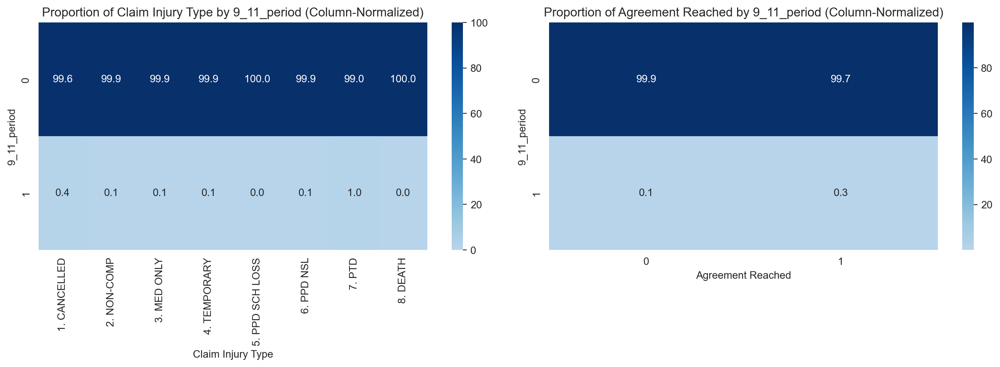

In [95]:
# Create the first crosstab for proportions of "Claim Injury Type" by "9_11_period"
nine_eleven_by_injury_type_proportion = pd.crosstab(df_dates['9_11_period'], df_dates['Claim Injury Type'], normalize='columns') * 100

# Create the second crosstab for proportions of "Agreement Reached" by "9_11_period"
nine_eleven_by_agreement_proportion = pd.crosstab(df_dates['9_11_period'], df_dates['Agreement Reached'], normalize='columns') * 100

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(nine_eleven_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('9_11_period')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Type by 9_11_period (Column-Normalized)')

sns.heatmap(nine_eleven_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('9_11_period')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached by 9_11_period (Column-Normalized)')

plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## Claim Injury Type (Target Variable)
    
</a>

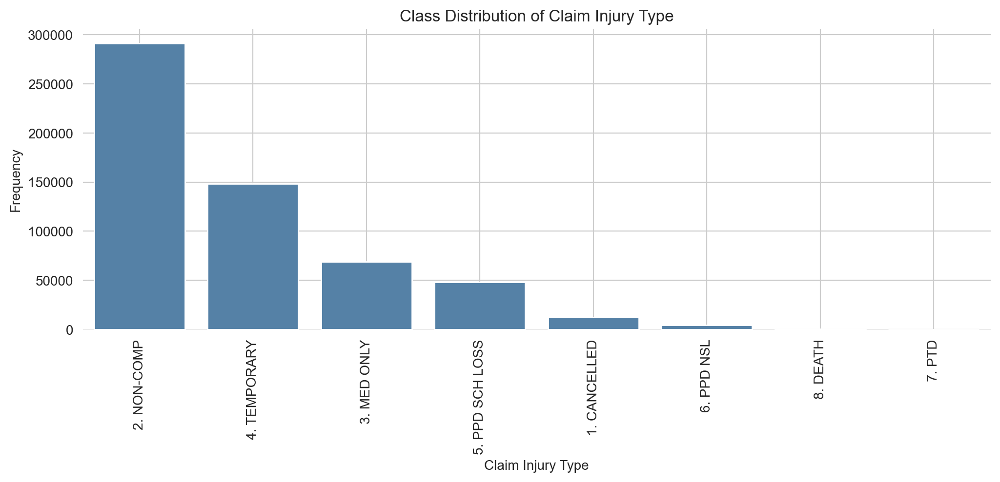

In [96]:
class_distribution = df_train['Claim Injury Type'].value_counts()      # calculate the class distribution
plt.figure(figsize=(12, 4))
sns.barplot(x=class_distribution.index, y=class_distribution.values, color='#4782B4')
plt.xlabel('Claim Injury Type')
plt.ylabel('Frequency')
plt.title('Class Distribution of Claim Injury Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.xticks(rotation=90)
plt.show()

In [97]:
ptd_df = df_dates[df_dates['Claim Injury Type'] == '7. PTD'] # quick check to see if patterns emerge on the minority class.
ptd_df.head()

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,c2_to_accident_delay,c2_to_accident_delay_category,assembly_delay,assembly_delay_category,c3_to_accident_delay,c3_to_accident_delay_category,Accident_day_of_week,Accident Month,Accident_Year,Accident_Year_Category,9_11_period
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5399383,2019-11-19,71,N,2020-01-09,Y,499.59,1948,2020-01-09,2020-01-26,SAFETY NATIONAL CASUALTY CORP,1A. PRIVATE,7. PTD,ERIE,N,BUFFALO,2021-08-12,F,18.0,62,HEALTH CARE AND SOCIAL ASSISTANCE,II,57,PUSHING OR PULLING,80,"ALL OTHER CUMULATIVE INJURY, NOC",42,LOWER BACK AREA,14217,0,1,old_adult,1,more_than_one,1,1,1,1,51.0,Over_time,51.0,Long_Delay,68.0,Medium_Delay,1.0,11.0,2019.0,2010-2019,0
5401460,2020-01-06,53,N,2020-01-10,Y,972.00,1966,2020-01-10,2020-03-05,NYC TRANSIT AUTHORITY,3A. SELF PUBLIC,7. PTD,KINGS,N,NYC,2020-03-24,F,4.0,48,TRANSPORTATION AND WAREHOUSING,IV,75,FALLING OR FLYING OBJECT,10,CONTUSION,18,SOFT TISSUE,11212,0,6,old_adult,1,more_than_one,1,1,1,1,4.0,In_time,4.0,Short_Delay,59.0,Medium_Delay,0.0,1.0,2020.0,2020-2029,0
5402532,2020-01-01,55,N,2020-01-13,Y,1666.70,1964,2020-01-13,2020-01-17,STATE INSURANCE FUND,2A. SIF,7. PTD,ALBANY,N,ALBANY,2020-09-04,M,7.0,62,HEALTH CARE AND SOCIAL ASSISTANCE,I,74,"FELLOW WORKER, PATIENT OR OTHER PERSON",10,CONTUSION,18,SOFT TISSUE,12110,0,1,old_adult,1,more_than_one,1,1,1,1,12.0,Over_time,12.0,Median_Delay,16.0,Short_Delay,2.0,1.0,2020.0,2020-2029,0
5401641,2019-12-31,58,N,2020-01-13,Y,547.60,1961,2020-01-13,2020-02-11,PHARMACISTS MUTUAL INS. CO.,1A. PRIVATE,7. PTD,DUTCHESS,N,ALBANY,2020-05-01,F,12.0,62,HEALTH CARE AND SOCIAL ASSISTANCE,II,80,OBJECT HANDLED BY OTHERS,90,MULTIPLE PHYSICAL INJURIES ONLY,10,MULTIPLE HEAD INJURY,12508,1,5,old_adult,1,more_than_one,1,1,1,1,13.0,Over_time,13.0,Median_Delay,42.0,Medium_Delay,1.0,12.0,2019.0,2010-2019,0
5403058,2019-10-15,58,N,2020-01-14,Y,2587.30,1961,2020-03-19,2020-01-02,STATE INSURANCE FUND,2A. SIF,7. PTD,BRONX,N,NYC,2020-04-16,M,3.0,23,CONSTRUCTION,IV,99,"OTHER - MISCELLANEOUS, NOC",74,CANCER,60,LUNGS,10461,0,1,old_adult,1,more_than_one,1,1,1,1,156.0,Over_time,91.0,Long_Delay,79.0,Medium_Delay,1.0,10.0,2019.0,2010-2019,0


<a class="anchor" id="3rd-bullet">

## Average Weekly Wage
    
</a>

In [98]:
df_dates["Average Weekly Wage"].value_counts()

Average Weekly Wage
0.00       335450
250.00       3193
600.00       2319
1765.00      1294
500.00       1264
            ...  
1409.93         1
1483.02         1
1885.51         1
2676.03         1
1008.86         1
Name: count, Length: 120024, dtype: int64

In [99]:
df_dates["Average Weekly Wage"].isnull().sum()

28651

The group decided to check what are the claims with an Average Weekly Wage of 0

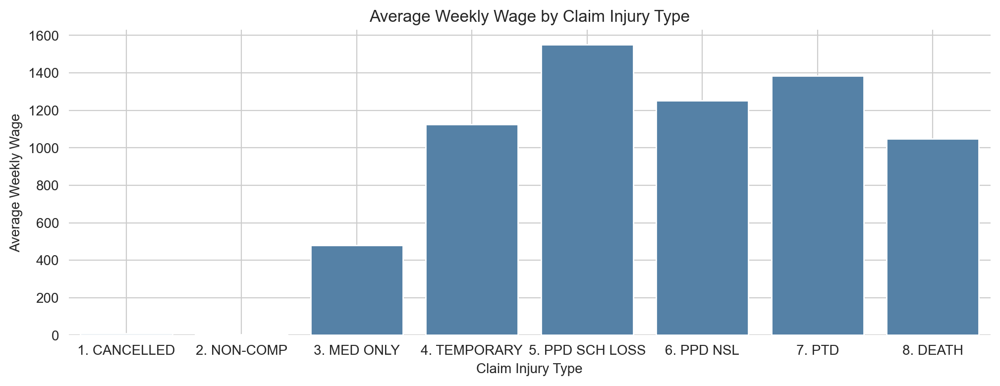

In [100]:
# Group by 'Claim Injury Type' and calculate the mean of 'Average Weekly Wage'

plt.figure(figsize=(12, 4))
sns.barplot(x=df_dates.groupby('Claim Injury Type')['Average Weekly Wage'].median().index, y=df_dates.groupby('Claim Injury Type')['Average Weekly Wage'].mean().values, color='#4782B4')
plt.xlabel('Claim Injury Type')
plt.ylabel('Average Weekly Wage')
plt.title('Average Weekly Wage by Claim Injury Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [101]:
df_dates[(df_dates["Claim Injury Type"] == "7. PTD")][["IME4_Category"]].value_counts()

IME4_Category
more_than_one    88
one               5
missing           4
Name: count, dtype: int64

In [102]:
df_dates[(df_dates["Claim Injury Type"] == "7. PTD") & (df_dates["IME4_Category"] == "missing")]

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,c2_to_accident_delay,c2_to_accident_delay_category,assembly_delay,assembly_delay_category,c3_to_accident_delay,c3_to_accident_delay_category,Accident_day_of_week,Accident Month,Accident_Year,Accident_Year_Category,9_11_period
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5506475,2020-03-30,31,N,2020-06-26,Y,816.72,1989,2020-06-26,2020-07-01,STATE INSURANCE FUND,2A. SIF,7. PTD,QUEENS,Y,NYC,2020-09-09,M,NaN,61,EDUCATIONAL SERVICES,IV,83,PANDEMIC,10,CONTUSION,60,LUNGS,11357,1,4,teen,0,missing,1,1,1,1,88.0,Over_time,88.0,Long_Delay,93.0,Medium_Delay,0.0,3.0,2020.0,2020-2029,0
5529461,2020-07-29,59,N,2020-08-03,Y,600.00,1960,2020-08-03,2020-08-04,STATE INSURANCE FUND,2A. SIF,7. PTD,SUFFOLK,N,HAUPPAUGE,2023-02-02,M,NaN,56,ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMEN...,IV,75,FALLING OR FLYING OBJECT,13,CRUSHING,10,MULTIPLE HEAD INJURY,11717,0,0,old_adult,0,missing,1,1,1,1,5.0,In_time,5.0,Short_Delay,6.0,Short_Delay,2.0,7.0,2020.0,2020-2029,0
5679833,2021-03-12,62,N,2021-03-15,Y,1158.80,1958,2021-03-15,2021-03-23,HARTFORD UNDERWRITERS INS CO,1A. PRIVATE,7. PTD,SARATOGA,N,ALBANY,2023-06-14,M,NaN,81,OTHER SERVICES (EXCEPT PUBLIC ADMINISTRATION),I,25,FROM DIFFERENT LEVEL (ELEVATION),10,CONTUSION,12,BRAIN,12019,0,4,old_adult,0,missing,1,1,1,1,3.0,In_time,3.0,Short_Delay,11.0,Short_Delay,4.0,3.0,2021.0,2020-2029,0
5728553,2021-04-30,22,N,2021-05-21,Y,825.00,1998,2021-05-21,2021-05-18,AMERICAN ZURICH INSURANCE CO,1A. PRIVATE,7. PTD,QUEENS,N,NYC,2022-07-27,M,NaN,23,CONSTRUCTION,IV,26,FROM LADDER OR SCAFFOLDING,28,FRACTURE,23,SPINAL CORD,11373,0,5,teen,0,missing,1,1,1,1,21.0,Over_time,21.0,Median_Delay,18.0,Short_Delay,4.0,4.0,2021.0,2020-2029,0


In [103]:
df_dates[(df_dates["Claim Injury Type"] == "6. PPD NSL") & (pd.isnull(df_dates["Average Weekly Wage"]))][["Hearing_Held"]].value_counts()

Hearing_Held
1               197
0                 2
Name: count, dtype: int64

In [104]:
df_dates[(df_dates["Average Weekly Wage"] > 1500)][["Claim Injury Type"]].value_counts()

Claim Injury Type
4. TEMPORARY         31337
5. PPD SCH LOSS      19326
3. MED ONLY           6513
6. PPD NSL            1210
2. NON-COMP            138
8. DEATH               106
7. PTD                  36
1. CANCELLED            13
Name: count, dtype: int64

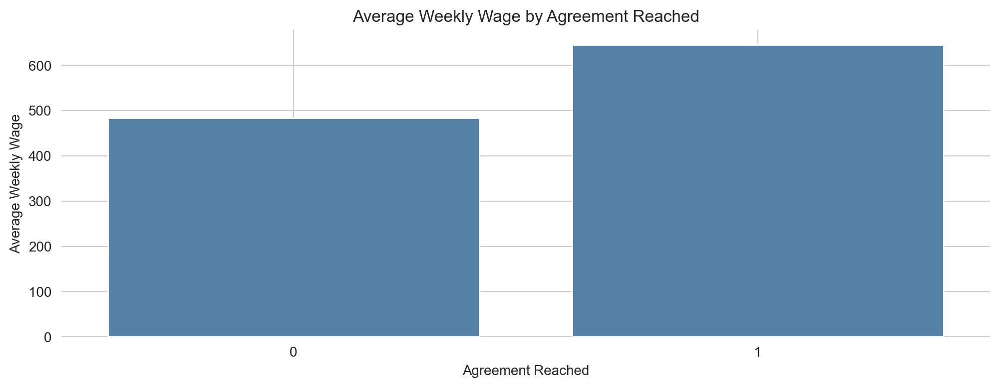

In [105]:
# Group by 'Claim Injury Type' and calculate the mean of 'Average Weekly Wage'

plt.figure(figsize=(12, 4))
sns.barplot(x=df_train.groupby('Agreement Reached')['Average Weekly Wage'].mean().index, y=df_train.groupby('Agreement Reached')['Average Weekly Wage'].mean().values, color='#4782B4')
plt.xlabel('Agreement Reached')
plt.ylabel('Average Weekly Wage')
plt.title('Average Weekly Wage by Agreement Reached')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [106]:
df_dates[df_dates['Average Weekly Wage'] == 0][["Claim Injury Type"]].value_counts()

Claim Injury Type
2. NON-COMP          275759
3. MED ONLY           39582
1. CANCELLED          11735
4. TEMPORARY           8236
8. DEATH                 92
6. PPD NSL               28
5. PPD SCH LOSS          18
Name: count, dtype: int64

In [107]:
# Function to categorize the wage using quartiles
def categorize_wage_quartiles(wage):
    if pd.isnull(wage):
        return 'Missing_Wage'
    elif wage == 0:
        return 'No_Wage'
    elif 0 < wage <= 1000:
        return 'low_wage'
    elif 1000 < wage <= 2000:
        return 'medium_wage'
    elif 2000 < wage <= 3000:
        return 'high_wage'
    else:
        return 'huge_wage'

df_dates['average_weekly_wage_category'] = df_dates['Average Weekly Wage'].apply(categorize_wage_quartiles)

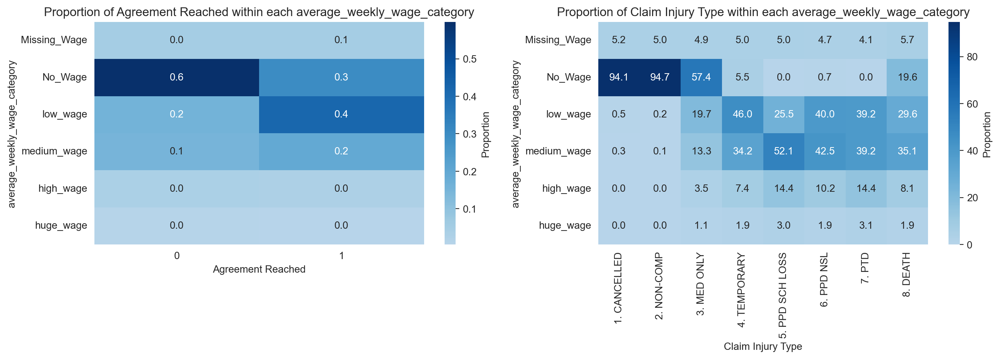

In [108]:
# Define a custom category order for average_weekly_wage_category
category_order = ['Missing_Wage', 'No_Wage', 'low_wage', 'medium_wage', 'high_wage', 'huge_wage']
df_dates['average_weekly_wage_category'] = pd.Categorical(df_dates['average_weekly_wage_category'], categories=category_order, ordered=True)

# Create the first crosstab for proportions of "Agreement Reached" by "average_weekly_wage_category"
df_pivot_agreement = pd.crosstab(df_dates['average_weekly_wage_category'], df_dates['Agreement Reached'], normalize='columns')

# Create the second crosstab for proportions of "Claim Injury Type" by "average_weekly_wage_category"
df_pivot_injury = pd.crosstab(df_dates['average_weekly_wage_category'], df_dates['Claim Injury Type'], normalize='columns') * 100

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(df_pivot_agreement, annot=True, fmt='.1f' ,cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[0])
axes[0].set_title('Proportion of Agreement Reached within each average_weekly_wage_category')
axes[0].set_xlabel('Agreement Reached')
axes[0].set_ylabel('average_weekly_wage_category')

sns.heatmap(df_pivot_injury, annot=True, fmt='.1f' ,cmap=truncated_blues, cbar_kws={'label': 'Proportion'}, ax=axes[1])
axes[1].set_title('Proportion of Claim Injury Type within each average_weekly_wage_category')
axes[1].set_xlabel('Claim Injury Type')
axes[1].set_ylabel('average_weekly_wage_category')

plt.tight_layout()
plt.show()

Cancelled and Non-Compensable Claims have an average weekly wage close to zero as expected because these categories involve injuries where no compensation was awarded and the claims were canceled.
- 94% of the claims of each two types of claim injury type have a wage of 0, as expected
- 57% MED ONLY claims injury type with zero wage 

As the severity of injuries increase, the average weekly wage also increases. The group observed that the cases involving permanent disabilities and scheduled losses, have the higher average weekly wage, possibly because the represent cases of permanent injuries, that result in long-term financial support



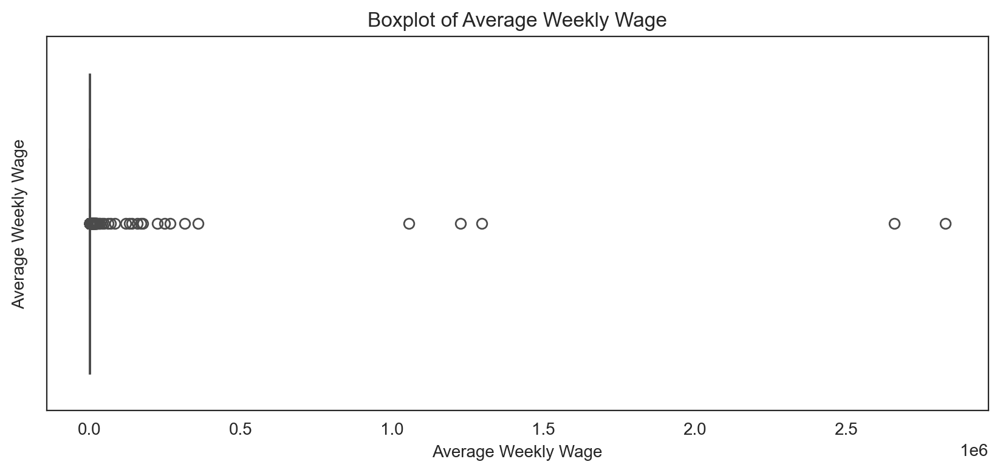

In [109]:
# boxplot of average weekly wage exlcuding values above 0
plt.figure(figsize=(10, 4))
sns.boxplot(data=df_dates[(df_dates['Average Weekly Wage'] > 0)], x='Average Weekly Wage', color="#4782B4")
plt.title('Boxplot of Average Weekly Wage')
plt.ylabel('Average Weekly Wage')
plt.show()

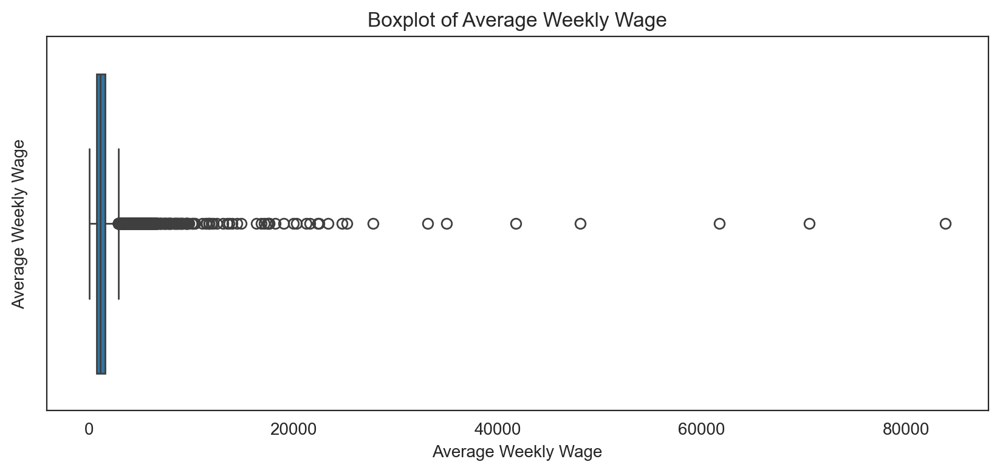

In [110]:
## boxplot of average weekly wage exlcuding values below 1000000 and above 0
df_explore = df_dates[(df_dates['Average Weekly Wage'] > 0) & (df_dates['Average Weekly Wage'] < 100000)]
plt.figure(figsize=(10, 4))
sns.boxplot(data=df_explore, x='Average Weekly Wage')
plt.title('Boxplot of Average Weekly Wage')
plt.ylabel('Average Weekly Wage')
plt.show()

<a class="anchor" id="3rd-bullet">

## Medical Fee Region
    
</a>

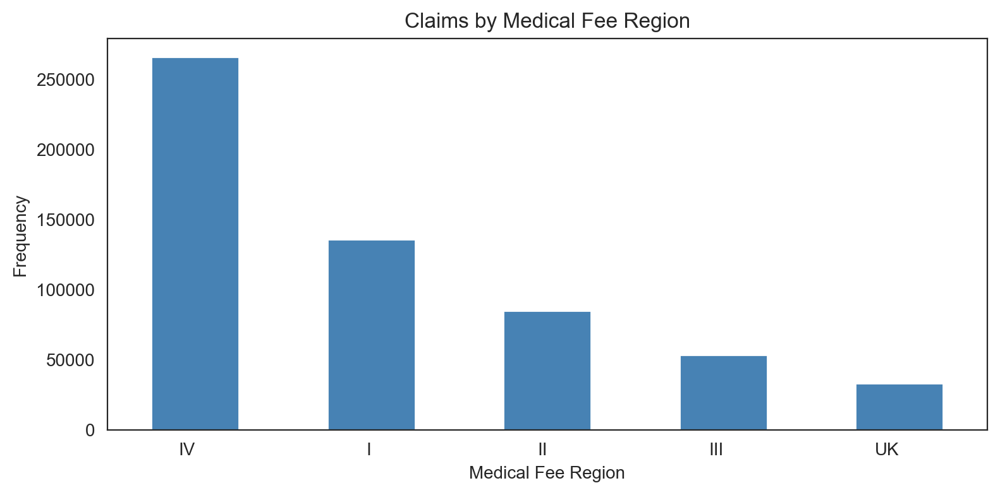

In [111]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
df_train['Medical Fee Region'].value_counts().plot(kind='bar', color='#4782B4', ax=ax)
ax.set_title('Claims by Medical Fee Region')
ax.set_ylabel('Frequency')
ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='right')
plt.tight_layout() # avoid overlapping labels
plt.show()

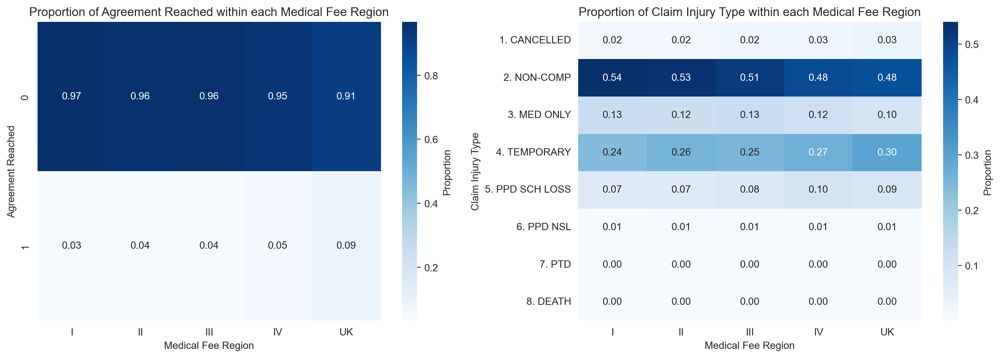

In [112]:
# Create the first crosstab for proportions of "Agreement Reached" by "Medical Fee Region"
df_pivot_agreement = pd.crosstab(df_dates['Agreement Reached'], df_dates['Medical Fee Region'], normalize='columns')

# Create the second crosstab for proportions of "Claim Injury Type" by "Medical Fee Region"
df_pivot_injury = pd.crosstab(df_dates['Claim Injury Type'], df_dates['Medical Fee Region'], normalize='columns')

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot the first heatmap for Agreement Reached
sns.heatmap(df_pivot_agreement, annot=True, fmt='.2f', cmap='Blues', cbar_kws={'label': 'Proportion'}, ax=axes[0])
axes[0].set_title('Proportion of Agreement Reached within each Medical Fee Region')
axes[0].set_xlabel('Medical Fee Region')
axes[0].set_ylabel('Agreement Reached')

# Plot the second heatmap for Claim Injury Type
sns.heatmap(df_pivot_injury, annot=True, fmt='.2f', cmap='Blues', cbar_kws={'label': 'Proportion'}, ax=axes[1])
axes[1].set_title('Proportion of Claim Injury Type within each Medical Fee Region')
axes[1].set_xlabel('Medical Fee Region')
axes[1].set_ylabel('Claim Injury Type')

plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## Alternative Dispute Resolution
    
</a>


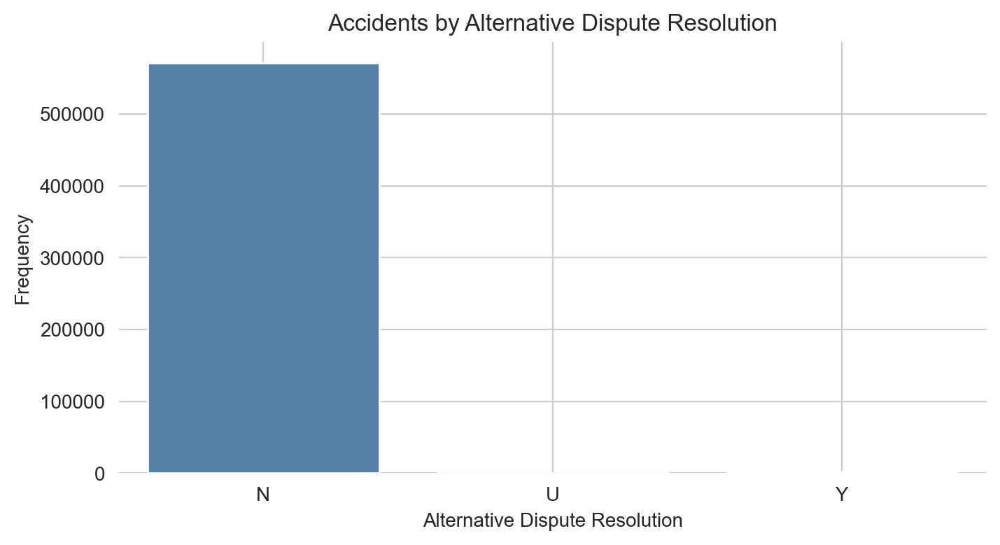

In [113]:
alter_dispute = df_train["Alternative Dispute Resolution"].value_counts().sort_index()
plt.figure(figsize=(8, 4))
sns.barplot(x=alter_dispute.index, y=alter_dispute.values, color='#4782B4')
plt.xlabel('Alternative Dispute Resolution')
plt.ylabel('Frequency')
plt.title('Accidents by Alternative Dispute Resolution')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

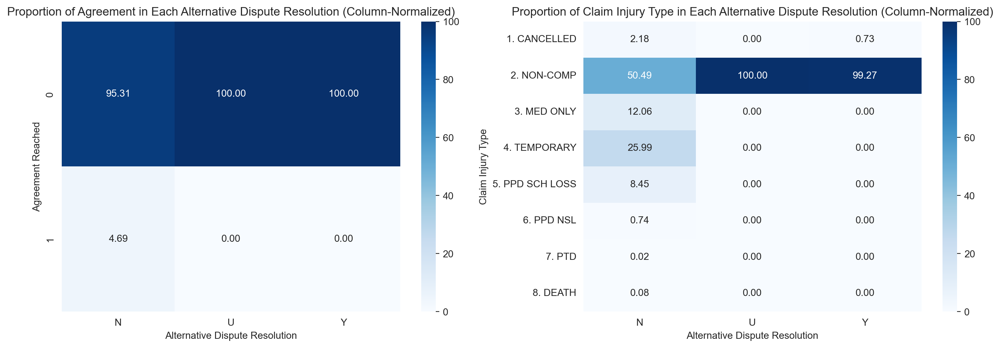

In [114]:
# Create the first crosstab for proportions of "Agreement Reached" by "Alternative Dispute Resolution"
dispute_by_agreement_proportion = pd.crosstab(df_dates['Agreement Reached'], df_dates['Alternative Dispute Resolution'], normalize='columns') * 100  

# Create the second crosstab for proportions of "Claim Injury Type" by "Alternative Dispute Resolution"
dispute_by_injury_type_proportion = pd.crosstab(df_dates['Claim Injury Type'], df_dates['Alternative Dispute Resolution'], normalize='columns') * 100  

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot the first heatmap for Agreement Reached
sns.heatmap(dispute_by_agreement_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[0])
axes[0].set_ylabel('Agreement Reached')
axes[0].set_xlabel('Alternative Dispute Resolution')
axes[0].set_title('Proportion of Agreement in Each Alternative Dispute Resolution (Column-Normalized)')

# Plot the second heatmap for Claim Injury Type
sns.heatmap(dispute_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[1])
axes[1].set_ylabel('Claim Injury Type')
axes[1].set_xlabel('Alternative Dispute Resolution')
axes[1].set_title('Proportion of Claim Injury Type in Each Alternative Dispute Resolution (Column-Normalized)')

# Adjust layout
plt.tight_layout()
plt.show()


**We see that when there was an Alternative Resolution the only Claim Types associated was 1st and 2nd (low severety)**

<a class="anchor" id="3rd-bullet">

## Attorney/Representative
    
</a>

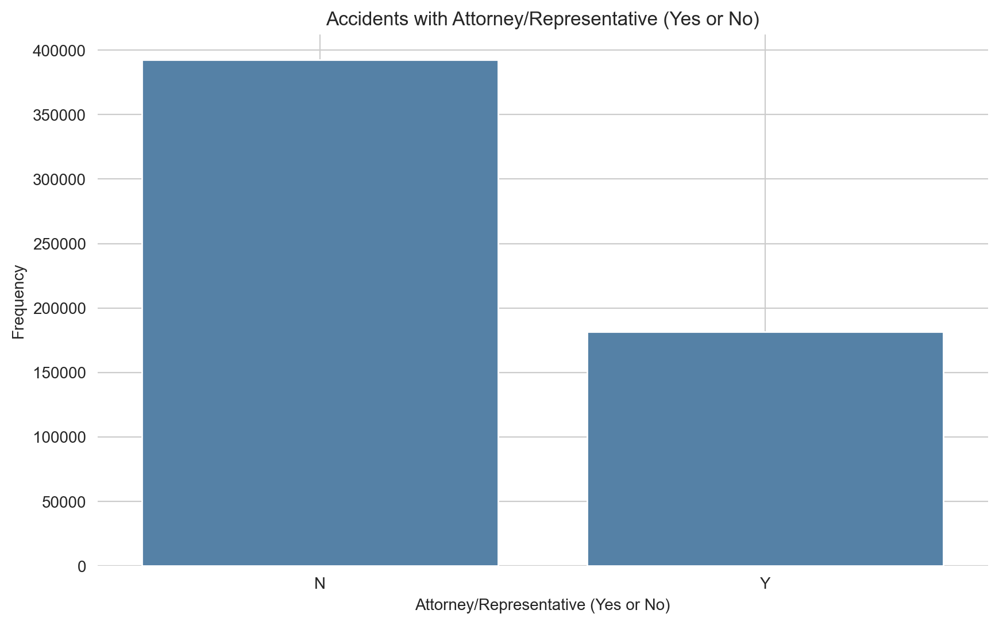

In [115]:
attorney_representative = df_dates['Attorney/Representative'].value_counts().sort_index()
plt.figure(figsize=(10, 6))
sns.barplot(x=attorney_representative.index, y=attorney_representative.values, color='#4782B4')
plt.xlabel('Attorney/Representative (Yes or No)')
plt.ylabel('Frequency')
plt.title('Accidents with Attorney/Representative (Yes or No)')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

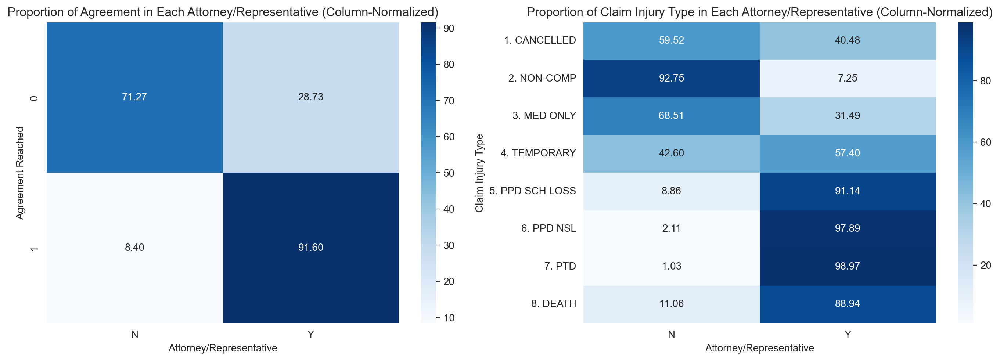

In [116]:
# Create the first crosstab for proportions of "Agreement Reached" by "Attorney/Representative"
dispute_by_agreement_proportion = pd.crosstab(df_dates['Agreement Reached'], df_dates['Attorney/Representative'], normalize='index') * 100 

# Create the second crosstab for proportions of "Claim Injury Type" by "Attorney/Representative"
dispute_by_injury_type_proportion = pd.crosstab(df_dates['Claim Injury Type'], df_dates['Attorney/Representative'], normalize='index') * 100  

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot the first heatmap for Agreement Reached
sns.heatmap(dispute_by_agreement_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[0])
axes[0].set_ylabel('Agreement Reached')
axes[0].set_xlabel('Attorney/Representative')
axes[0].set_title('Proportion of Agreement in Each Attorney/Representative (Column-Normalized)')

# Plot the second heatmap for Claim Injury Type
sns.heatmap(dispute_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[1])
axes[1].set_ylabel('Claim Injury Type')
axes[1].set_xlabel('Attorney/Representative')
axes[1].set_title('Proportion of Claim Injury Type in Each Attorney/Representative (Column-Normalized)')

# Adjust layout
plt.tight_layout()
plt.show()

We see that having an attorney is also more likely on medium/high severety cases

<a class="anchor" id="3rd-bullet">

## Gender
    
</a>

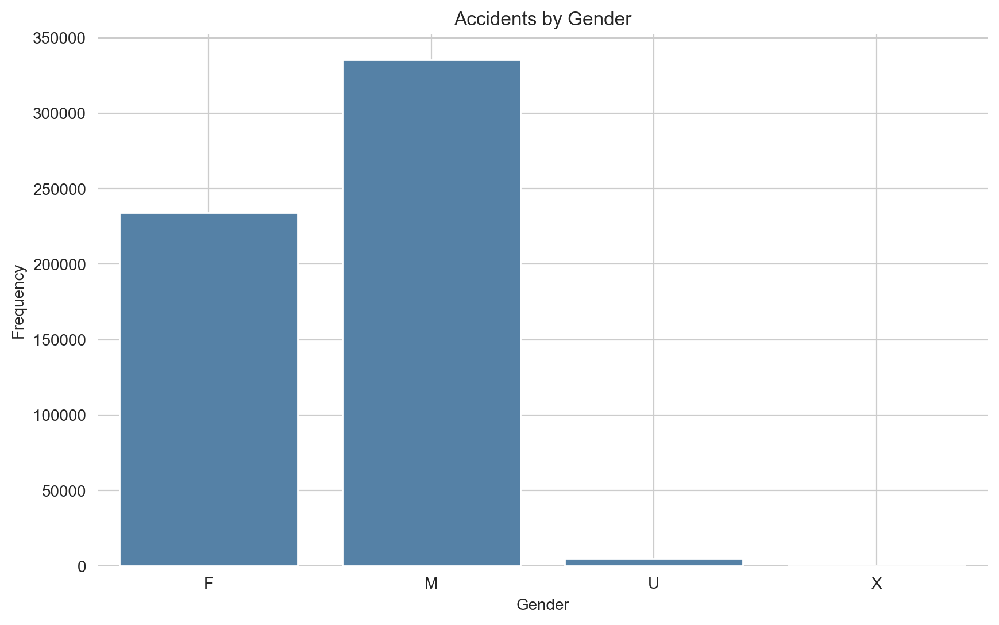

In [117]:
gender = df_dates['Gender'].value_counts().sort_index()
plt.figure(figsize=(10, 6))
sns.barplot(x=gender.index, y=gender.values, color='#4782B4')
plt.xlabel('Gender')
plt.ylabel('Frequency')
plt.title('Accidents by Gender')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

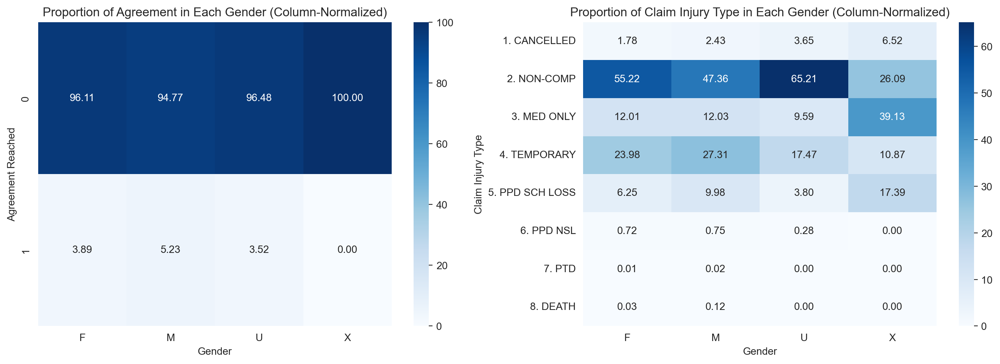

In [118]:
# Create the first crosstab for proportions of "Agreement Reached" by "Gender"
dispute_by_agreement_proportion = pd.crosstab(df_dates['Agreement Reached'], df_dates['Gender'], normalize='columns') * 100  

# Create the second crosstab for proportions of "Claim Injury Type" by "Gender"
dispute_by_injury_type_proportion = pd.crosstab(df_dates['Claim Injury Type'], df_dates['Gender'], normalize='columns') * 100  

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot the first heatmap for Agreement Reached
sns.heatmap(dispute_by_agreement_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[0])
axes[0].set_ylabel('Agreement Reached')
axes[0].set_xlabel('Gender')
axes[0].set_title('Proportion of Agreement in Each Gender (Column-Normalized)')

# Plot the second heatmap for Claim Injury Type
sns.heatmap(dispute_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.2f', ax=axes[1])
axes[1].set_ylabel('Claim Injury Type')
axes[1].set_xlabel('Gender')
axes[1].set_title('Proportion of Claim Injury Type in Each Gender (Column-Normalized)')

# Adjust layout
plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## District Name
    
</a>


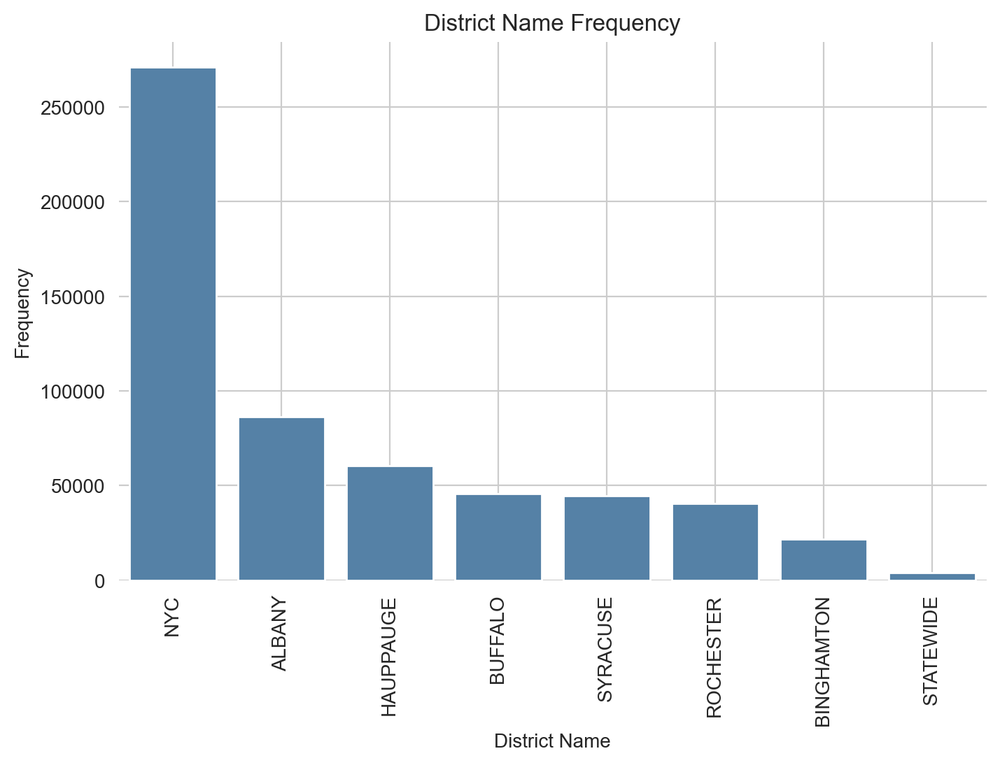

In [119]:
plt.figure(figsize=(8, 5))
sns.barplot(x=df_dates['District Name'].value_counts().sort_values(ascending=False).index, y=df_dates['District Name'].value_counts().sort_values(ascending=False).values, color='#4782B4')
plt.xlabel('District Name')
plt.ylabel('Frequency')
plt.title('District Name Frequency')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.xticks(rotation=90)
plt.show()

In [120]:
df_dates['District Name'].value_counts()

District Name
NYC           270779
ALBANY         86171
HAUPPAUGE      60536
BUFFALO        45605
SYRACUSE       44646
ROCHESTER      40449
BINGHAMTON     21864
STATEWIDE       3976
Name: count, dtype: int64

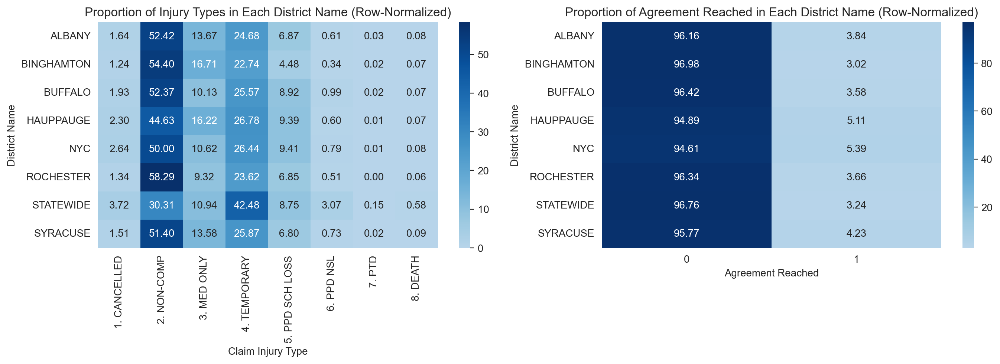

In [121]:
# Create the first crosstab for proportions of "Claim Injury Type" by "District Name"
district_name_by_injury_type_proportion = pd.crosstab(df_dates['District Name'], df_dates['Claim Injury Type'], normalize='index') * 100  

# Create the second crosstab for proportions of "Agreement Reached" by "District Name"
district_name_by_agreement_proportion = pd.crosstab(df_dates['District Name'], df_dates['Agreement Reached'], normalize='index') * 100  

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(district_name_by_injury_type_proportion, cmap=truncated_blues, annot=True, fmt='.2f', ax=axes[0])

axes[0].set_ylabel('District Name')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types in Each District Name (Row-Normalized)')

sns.heatmap(district_name_by_agreement_proportion, cmap=truncated_blues, annot=True, fmt='.2f', ax=axes[1])

axes[1].set_ylabel('District Name')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached in Each District Name (Row-Normalized)')

plt.tight_layout()
plt.show()

Statewide as a big importance on 4. Temporary

<a class="anchor" id="3rd-bullet">

## Carrier Name
    
</a>

Most frequent Carriers (Top 10)

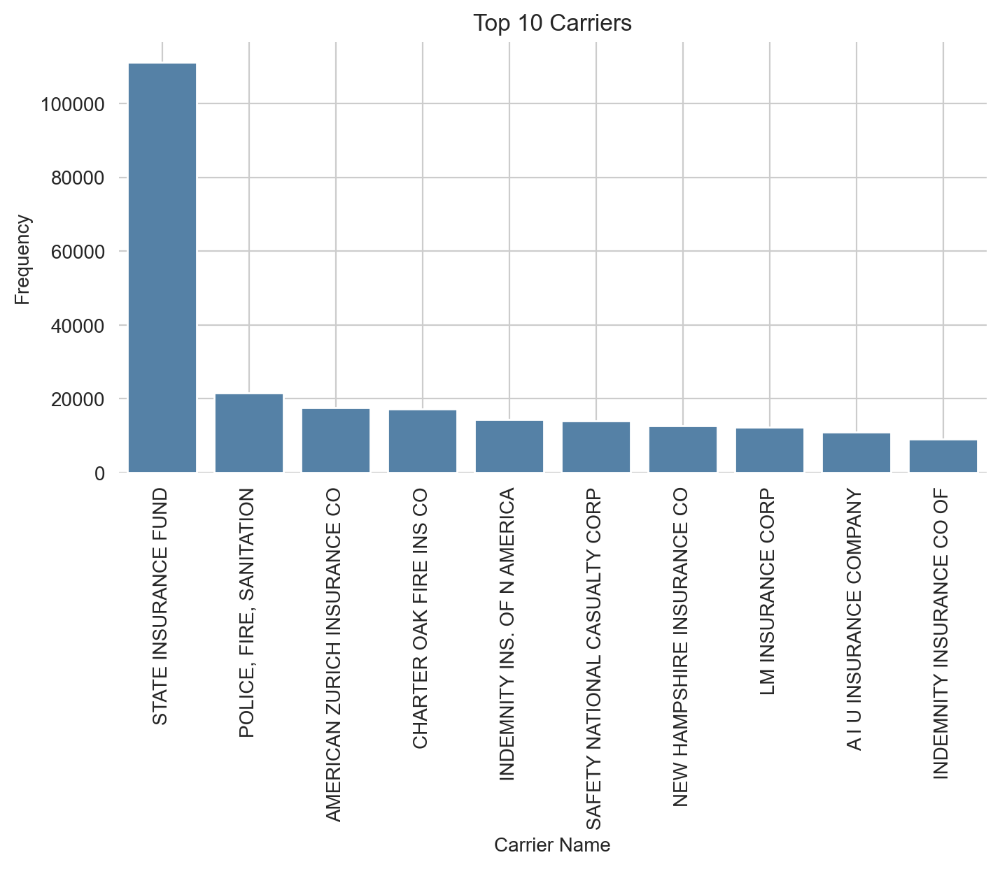

In [122]:
top_10_carriers = df_dates['Carrier Name'].value_counts().head(10)
plt.figure(figsize=(8, 4))
sns.barplot(x=top_10_carriers.index, y=top_10_carriers.values, color='#4782B4')
plt.xlabel('Carrier Name')
plt.ylabel('Frequency')
plt.title('Top 10 Carriers')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.xticks(rotation=90)
plt.show()

In [123]:
df_dates["Carrier Name"].value_counts()

Carrier Name
STATE INSURANCE FUND            111144
POLICE, FIRE, SANITATION         21602
AMERICAN ZURICH INSURANCE CO     17540
CHARTER OAK FIRE INS CO          17176
INDEMNITY INS. OF N AMERICA      14366
                                 ...  
LOWES HOME CENTERS INC               1
WEST BEND MUTUAL INSURANCE           1
LIVINGSTON-STEUBEN-                  1
NEW YORK MUTUAL CASUALTY             1
HERMON-DEKALB CENTRAL                1
Name: count, Length: 2046, dtype: int64

In [124]:
df_dates['Carrier Name'].value_counts().index[:10]

Index(['STATE INSURANCE FUND', 'POLICE, FIRE, SANITATION',
       'AMERICAN ZURICH INSURANCE CO', 'CHARTER OAK FIRE INS CO',
       'INDEMNITY INS. OF N AMERICA', 'SAFETY NATIONAL CASUALTY CORP',
       'NEW HAMPSHIRE INSURANCE CO', 'LM INSURANCE CORP',
       'A I U INSURANCE COMPANY', 'INDEMNITY INSURANCE CO OF'],
      dtype='object', name='Carrier Name')

In [125]:
# Group by 'Carrier Name' and check if all 'Agreement Reached' values are 1
carriers_with_100_agreement = df_dates.groupby('Carrier Name')['Agreement Reached'].apply(lambda x: (x == 1).all())

# Filter carriers with 100% agreement
carriers_with_100_agreement = carriers_with_100_agreement[carriers_with_100_agreement].index.tolist()

print("Carriers with 100% Agreement Reached:")
print(carriers_with_100_agreement)


Carriers with 100% Agreement Reached:
['AIRBORNE EXPRESS, INC.', 'CAROLINA FREIGHT CARRIERS', 'EXCELSIOR INSURANCE CO', 'GOLUB CORP', 'GREAT ATLANTIC & PACIFIC TEA', 'GREENE COUNTY', 'HEALTHSTAR NETWORK INC', 'HEALTHSTAR NETWORK INC.', 'L T V STEEL COMPANY,  INC.', 'LYNCOURT UNION FREE SCHOOL', 'MIDDLETOWN CITY OF', 'NY BUS OPERATORS COMP TRUST', 'NYS WCB (LIABLE CARRIER IS 06)', 'STEUBEN COUNTY SELF INS PLAN', 'UPSTATE NIAGA COOPERATIVES INC']


In [126]:
df_dates[df_dates["Carrier Name"] == "CAROLINA FREIGHT CARRIERS"].head(5)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,Age_Category,IME4_binary,IME4_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,c2_to_accident_delay,c2_to_accident_delay_category,assembly_delay,assembly_delay_category,c3_to_accident_delay,c3_to_accident_delay_category,Accident_day_of_week,Accident Month,Accident_Year,Accident_Year_Category,9_11_period,average_weekly_wage_category
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5902278,1988-10-12,0,N,2022-01-20,Y,0.0,0,2022-01-20,NaT,CAROLINA FREIGHT CARRIERS,4A. SELF PRIVATE,4. TEMPORARY,UNKNOWN,N,NYC,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,UK,<NA>,NaN,<NA>,NaN,65,INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLA...,07463,1,3,missing,0,missing,0,0,1,1,12153.0,Over_time,12153.0,Long_Delay,-9999.0,No_C3,2.0,10.0,1988.0,1980-1989,0,No_Wage
5902580,1991-04-03,0,N,2022-01-20,Y,0.0,0,2022-01-20,NaT,CAROLINA FREIGHT CARRIERS,4A. SELF PRIVATE,4. TEMPORARY,UNKNOWN,N,NYC,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,UK,<NA>,NaN,<NA>,NaN,65,INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLA...,07463,1,6,missing,0,missing,0,0,1,1,11250.0,Over_time,11250.0,Long_Delay,-9999.0,No_C3,2.0,4.0,1991.0,1990-1999,0,No_Wage
5902320,1988-06-09,0,N,2022-01-20,Y,0.0,0,2022-01-20,NaT,CAROLINA FREIGHT CARRIERS,4A. SELF PRIVATE,4. TEMPORARY,UNKNOWN,N,NYC,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,UK,<NA>,NaN,<NA>,NaN,65,INSUFFICIENT INFO TO PROPERLY IDENTIFY - UNCLA...,07463,1,1,missing,0,missing,0,0,1,1,12278.0,Over_time,12278.0,Long_Delay,-9999.0,No_C3,3.0,6.0,1988.0,1980-1989,0,No_Wage
5998734,1992-08-17,0,N,2022-05-24,Y,0.0,0,2022-05-24,NaT,CAROLINA FREIGHT CARRIERS,4A. SELF PRIVATE,4. TEMPORARY,KINGS,N,NYC,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,IV,<NA>,NaN,<NA>,NaN,66,NO PHYSICAL INJURY,10306,1,4,missing,0,missing,0,0,1,1,10872.0,Over_time,10872.0,Long_Delay,-9999.0,No_C3,0.0,8.0,1992.0,1990-1999,0,No_Wage
5998973,1989-09-12,0,N,2022-05-24,Y,0.0,<NA>,2022-05-24,NaT,CAROLINA FREIGHT CARRIERS,4A. SELF PRIVATE,4. TEMPORARY,KINGS,N,NYC,NaT,M,NaN,48,TRANSPORTATION AND WAREHOUSING,IV,<NA>,NaN,<NA>,NaN,66,NO PHYSICAL INJURY,10306,1,5,missing,0,missing,0,0,1,1,11942.0,Over_time,11942.0,Long_Delay,-9999.0,No_C3,1.0,9.0,1989.0,1980-1989,0,No_Wage


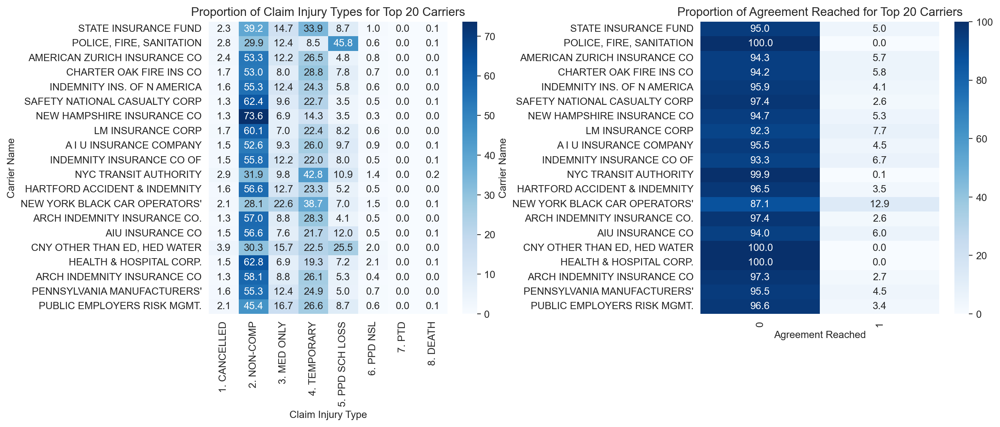

In [127]:
# Identify the top 20 carriers
top_20_carriers = df_dates['Carrier Name'].value_counts().index[:20]

# Calculate the crosstab for proportions of injuries by claim type
claim_injury_crosstab = pd.crosstab(df_dates['Carrier Name'], df_dates['Claim Injury Type'], normalize='index') * 100

# Filter the crosstab for the top 20 carriers
top_20_crosstab_injury = claim_injury_crosstab.loc[top_20_carriers]

# Calculate the crosstab for proportions of "Agreement Reached" by "Carrier Name"
agreement_crosstab = pd.crosstab(df_dates['Carrier Name'], df_dates['Agreement Reached'], normalize='index') * 100

# Filter the crosstab for the top 20 carriers
top_20_crosstab_agreement = agreement_crosstab.loc[top_20_carriers]

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.heatmap(top_20_crosstab_injury, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Carrier Name')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Types for Top 20 Carriers')
axes[0].tick_params(axis='x', rotation=90)

sns.heatmap(top_20_crosstab_agreement, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('Carrier Name')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached for Top 20 Carriers')
axes[1].tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()


In [128]:
df_dates[df_dates["Carrier Name"] == "*** CARRIER UNDETERMINED ***"]["Claim Injury Type"].value_counts()

Claim Injury Type
2. NON-COMP        1529
1. CANCELLED        188
4. TEMPORARY         44
3. MED ONLY          12
5. PPD SCH LOSS       1
Name: count, dtype: int64

<a class="anchor" id="3rd-bullet">

## Carrier Type
    
</a>

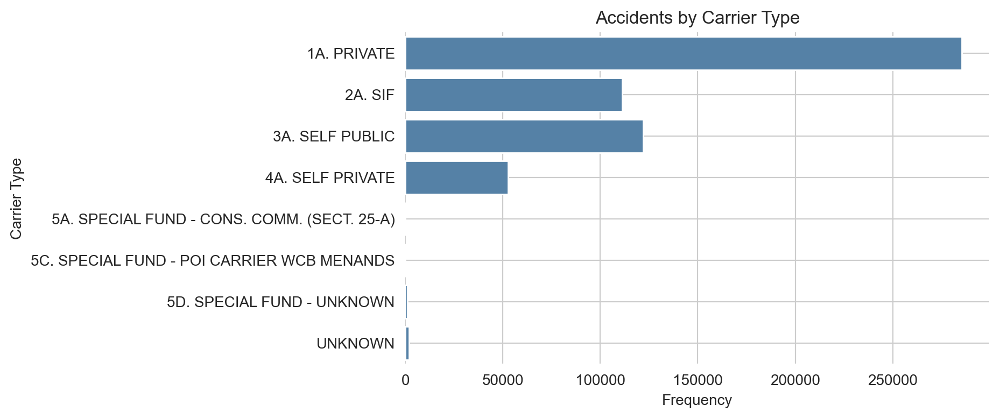

In [129]:
carrier_type = df_dates['Carrier Type'].value_counts().sort_index()      # check the frequencies of the accidents by carrier type
plt.figure(figsize=(7, 4))
sns.barplot(x=carrier_type.values, y=carrier_type.index, color='#4782B4')
plt.xlabel('Frequency')
plt.ylabel('Carrier Type')
plt.title('Accidents by Carrier Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [130]:
df_dates.loc[df_dates["Carrier Type"] == "UNKNOWN", "Carrier Name"].unique()

array(['*** CARRIER UNDETERMINED ***'], dtype=object)

The group decided to join all the Special Fund Carrier Types into one because the frequency of each one of them was very low

In [131]:
df_dates["Carrier Type"].value_counts()

Carrier Type
1A. PRIVATE                                    285368
3A. SELF PUBLIC                                121920
2A. SIF                                        111144
4A. SELF PRIVATE                                52788
UNKNOWN                                          1774
5D. SPECIAL FUND - UNKNOWN                       1023
5C. SPECIAL FUND - POI CARRIER WCB MENANDS          5
5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)         4
Name: count, dtype: int64

In [132]:
# Define the special fund carrier types
special_fund_types = [
    "5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
    "5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
    "5D. SPECIAL FUND - UNKNOWN"
]

# Replace the special fund carrier types with a single type
df_dates["Carrier Type"] = df_dates["Carrier Type"].replace(special_fund_types, "5. SPECIAL FUND")

# Verify the changes
df_dates["Carrier Type"].value_counts()

Carrier Type
1A. PRIVATE         285368
3A. SELF PUBLIC     121920
2A. SIF             111144
4A. SELF PRIVATE     52788
UNKNOWN               1774
5. SPECIAL FUND       1032
Name: count, dtype: int64

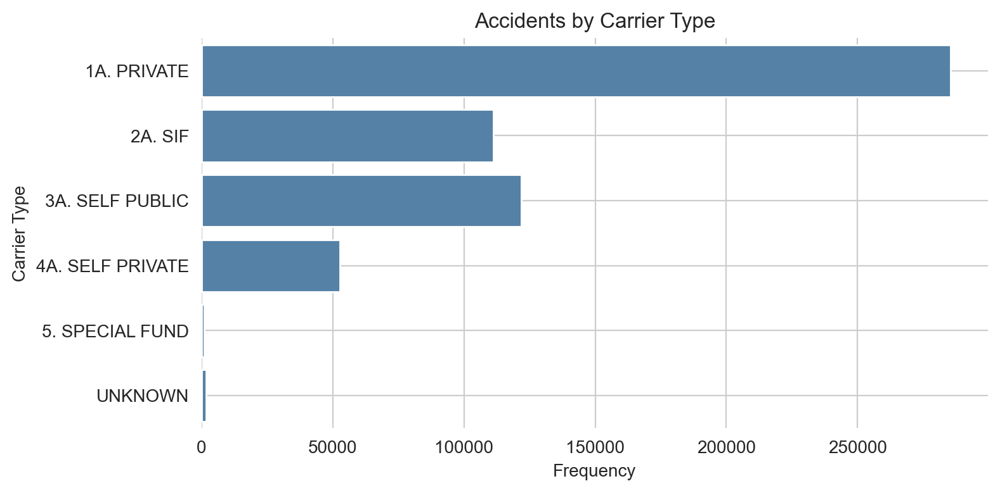

In [133]:
# Check the frequencies of the accidents by carrir type

plt.figure(figsize=(8, 4))
sns.barplot(x=df_dates['Carrier Type'].value_counts().sort_index().values, y=df_dates['Carrier Type'].value_counts().sort_index().index, color='#4782B4')
plt.xlabel('Frequency')
plt.ylabel('Carrier Type')
plt.title('Accidents by Carrier Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

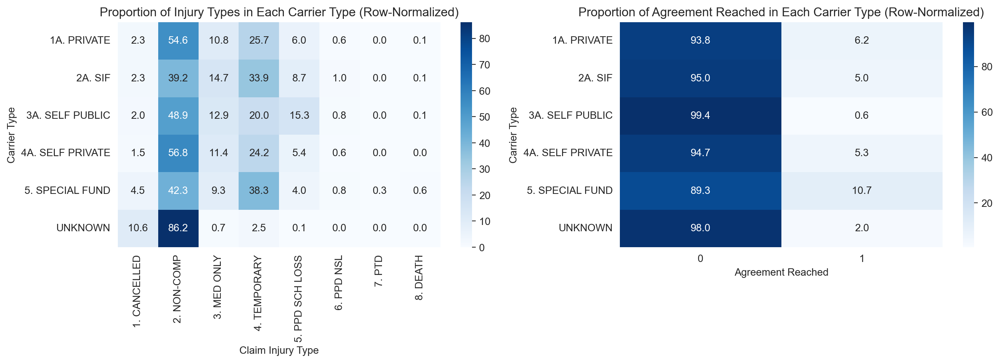

In [134]:
# Create the first crosstab for proportions of "Claim Injury Type" by "Carrier Type"
carrier_type_by_injury_type_proportion = pd.crosstab(df_dates['Carrier Type'], df_dates['Claim Injury Type'], normalize='index') * 100 

# Create the second crosstab for proportions of "Agreement Reached" by "Carrier Type"
carrier_type_by_agreement_proportion = pd.crosstab(df_dates['Carrier Type'], df_dates['Agreement Reached'], normalize='index') * 100  

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(carrier_type_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Carrier Type')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types in Each Carrier Type (Row-Normalized)')

sns.heatmap(carrier_type_by_agreement_proportion, cmap='Blues', annot=True, fmt='.1F', ax=axes[1])
axes[1].set_ylabel('Carrier Type')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached in Each Carrier Type (Row-Normalized)')

plt.tight_layout()
plt.show()

For severe claims, we see that people should have an Insurance Active

<a class="anchor" id="3rd-bullet">

## Multivariate Relationships (Carrier Type)
    
</a>

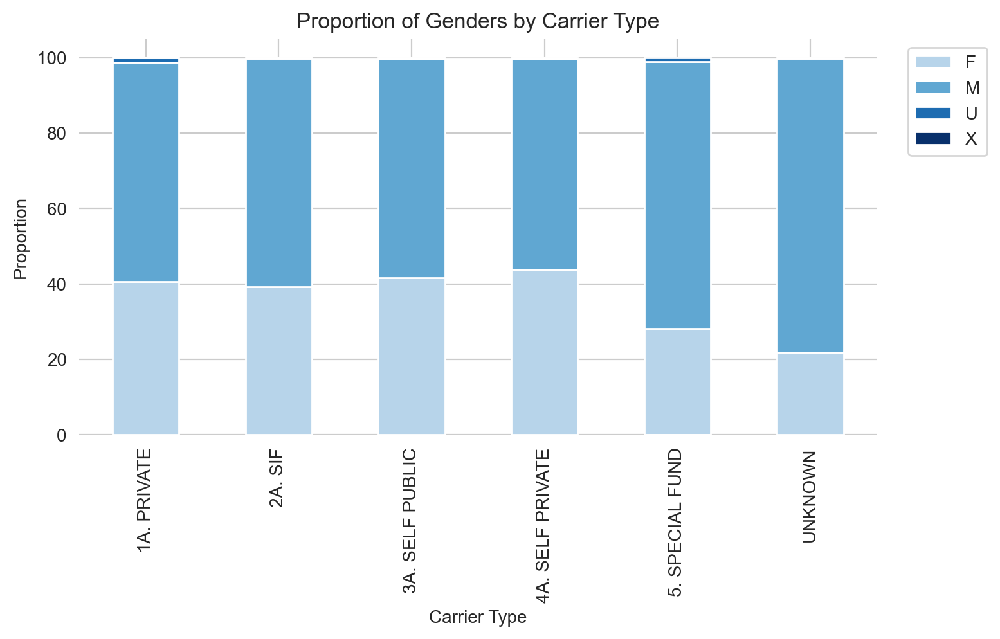

In [135]:
gender_proportion_carrier = pd.crosstab(df_dates['Carrier Type'], df_dates['Gender'], normalize='index') * 100
fig, ax = plt.subplots(figsize=(8, 4))  # Increased figure size
gender_proportion_carrier.plot(kind='bar', stacked=True, colormap=truncated_blues, ax=ax)
plt.xlabel('Carrier Type')
plt.ylabel('Proportion')
plt.title('Proportion of Genders by Carrier Type')
plt.grid(True)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.show()

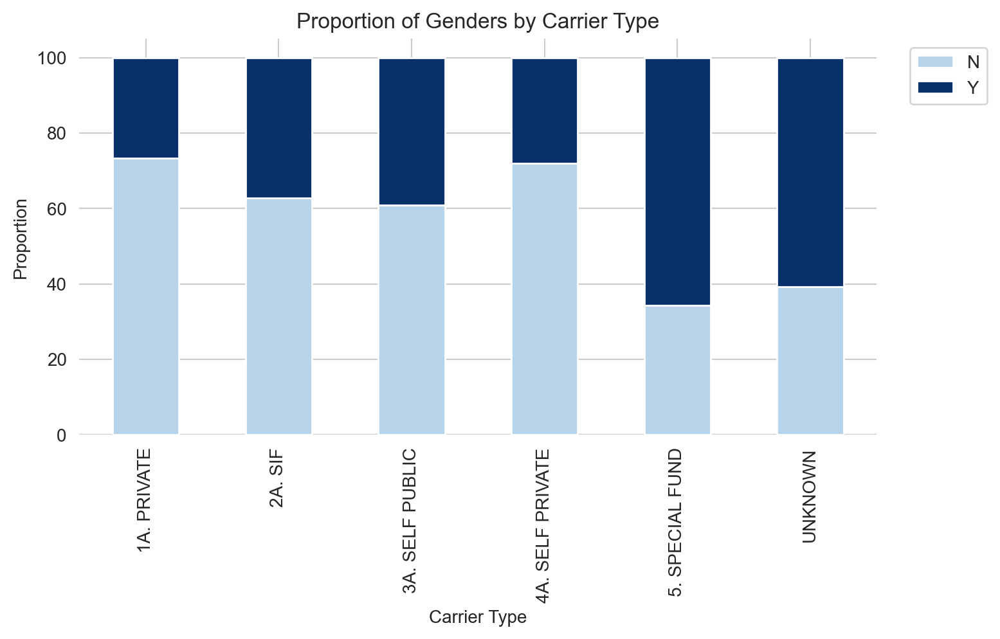

In [136]:
gender_proportion_carrier = pd.crosstab(df_dates['Carrier Type'], df_dates['Attorney/Representative'], normalize='index') * 100
fig, ax = plt.subplots(figsize=(8, 4))  # Increased figure size
gender_proportion_carrier.plot(kind='bar', stacked=True, colormap=truncated_blues, ax=ax)
plt.xlabel('Carrier Type')
plt.ylabel('Proportion')
plt.title('Proportion of Genders by Carrier Type')
plt.grid(True)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.show()

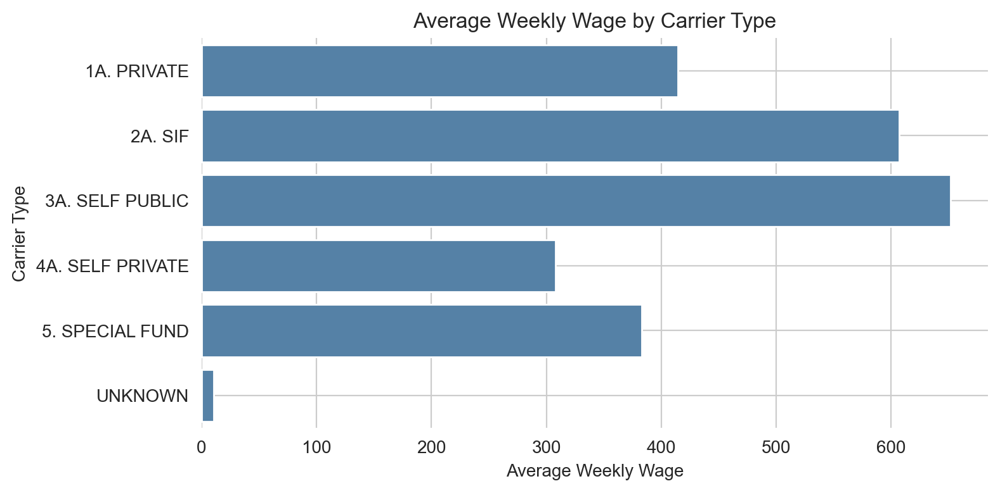

In [137]:
# Group by 'Carrier Type' and calculate the mean of 'Average Weekly Wage'
avg_weekly_wage_by_carrier_type = df_dates.groupby('Carrier Type')['Average Weekly Wage'].mean()

# Plot the data
plt.figure(figsize=(8, 4))
sns.barplot(x=avg_weekly_wage_by_carrier_type.values, y=avg_weekly_wage_by_carrier_type.index, color='#4782B4')
plt.xlabel('Average Weekly Wage')
plt.ylabel('Carrier Type')
plt.title('Average Weekly Wage by Carrier Type')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

<a class="anchor" id="3rd-bullet">

## County of Injury
    
</a>

In [138]:
df_dates["County of Injury"].value_counts()

County of Injury
SUFFOLK       60430
QUEENS        58333
KINGS         53207
NASSAU        43580
BRONX         39618
              ...  
WYOMING         760
MONTGOMERY      613
SCHOHARIE       558
YATES           396
HAMILTON        134
Name: count, Length: 63, dtype: int64

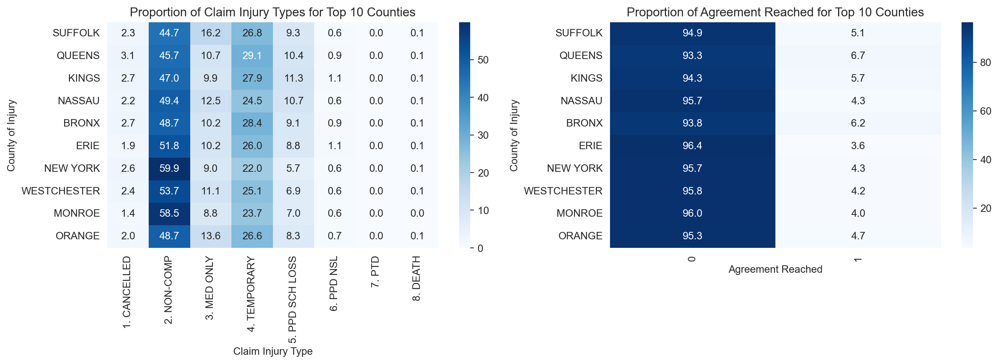

In [139]:
# Identify the top 10 counties
top_10_counties = df_dates['County of Injury'].value_counts().index[:10]

# Calculate the crosstab for proportions of injuries by claim type
claim_injury_county_crosstab = pd.crosstab(df_dates['County of Injury'], df_dates['Claim Injury Type'], normalize='index') * 100

# Filter the crosstab for the top 10 counties
top_10_crosstab_injury = claim_injury_county_crosstab.loc[top_10_counties]

# Calculate the crosstab for proportions of injuries by agreement reached
agreement_county_crosstab = pd.crosstab(df_dates['County of Injury'], df_dates['Agreement Reached'], normalize='index') * 100

top_10_crosstab_agreement = agreement_county_crosstab.loc[top_10_counties]

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(top_10_crosstab_injury, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('County of Injury')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Types for Top 10 Counties')
axes[0].tick_params(axis='x', rotation=90)

sns.heatmap(top_10_crosstab_agreement, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('County of Injury')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached for Top 10 Counties')
axes[1].tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()


In [140]:
# Check the frequencies of the accidents by carrir type
county_injury = df_dates['County of Injury'].value_counts().sort_index()
top5_county_injury = df_dates['County of Injury'].value_counts().nlargest(5)
top5_county_data = df_dates[df_dates['County of Injury'].isin(top5_county_injury.index)]
least5_county_injury = df_dates['County of Injury'].value_counts().nsmallest(5)
least5_county_data = df_dates[df_dates['County of Injury'].isin(least5_county_injury.index)]

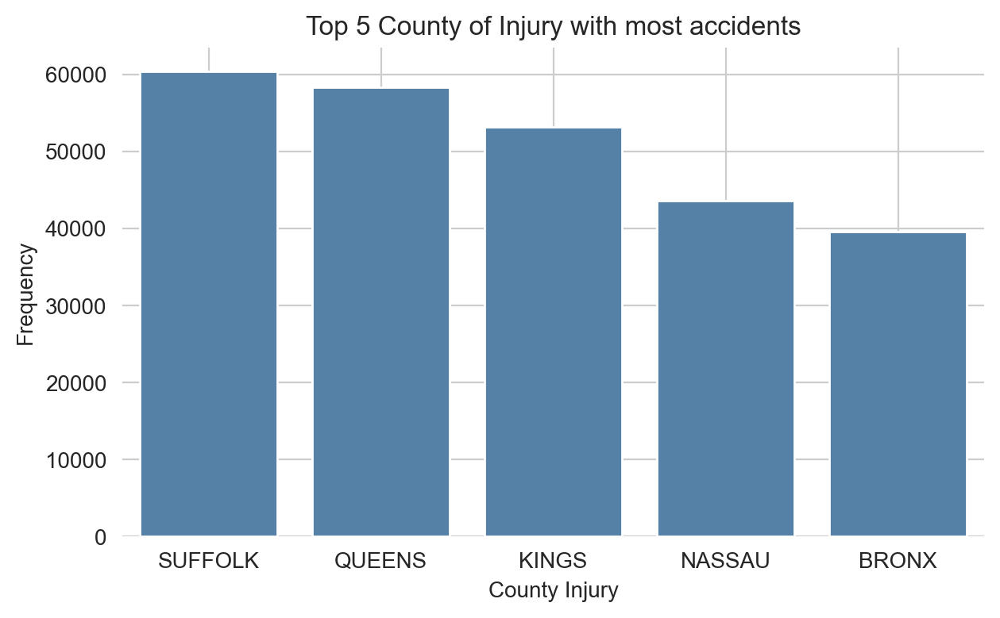

In [141]:
plt.figure(figsize=(7, 4))
sns.barplot(x=top5_county_injury.index, y=top5_county_injury.values, color='#4782B4')
plt.ylabel('Frequency')
plt.xlabel('County Injury')
plt.title('Top 5 County of Injury with most accidents')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

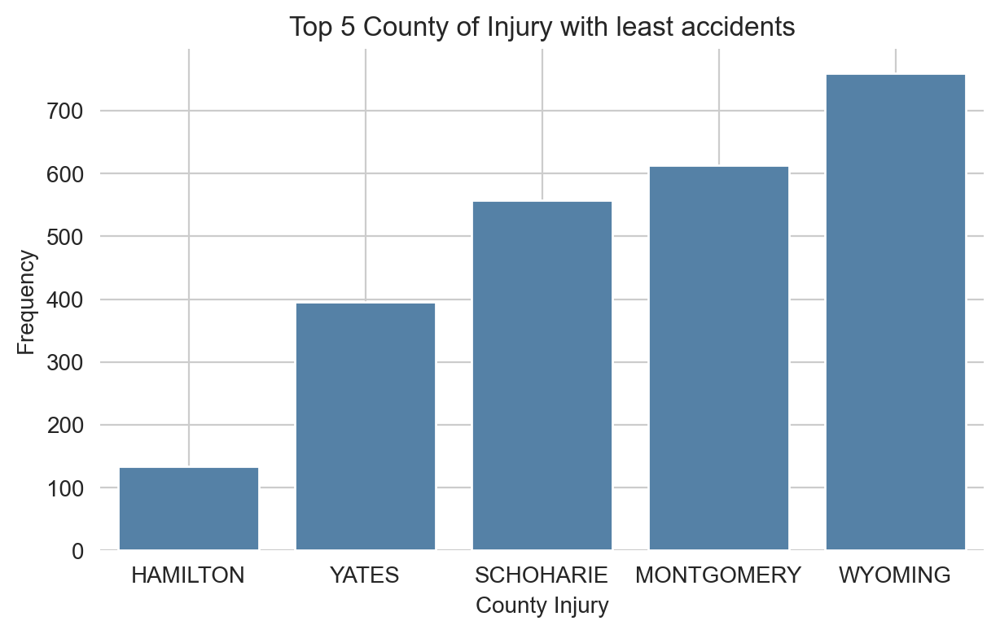

In [142]:
plt.figure(figsize=(7, 4))
sns.barplot(x=least5_county_injury.index, y=least5_county_injury.values, color='#4782B4')
plt.ylabel('Frequency')
plt.xlabel('County Injury')
plt.title('Top 5 County of Injury with least accidents')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

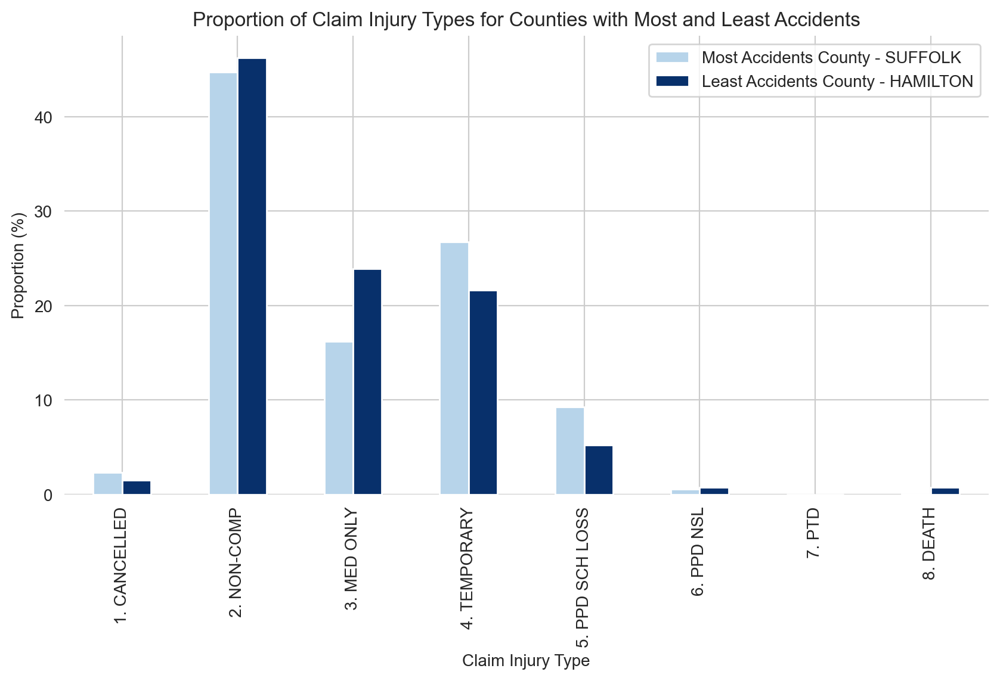

In [143]:
most_accidents_county = top5_county_injury.idxmax()
least_accidents_county = least5_county_injury.idxmin()
most_accidents_data = df_dates[df_dates['County of Injury'] == most_accidents_county]
least_accidents_data = df_dates[df_dates['County of Injury'] == least_accidents_county]
most_accidents_proportion = most_accidents_data['Claim Injury Type'].value_counts(normalize=True) * 100
least_accidents_proportion = least_accidents_data['Claim Injury Type'].value_counts(normalize=True) * 100

# combine the proportions into a DataFrame
proportions_df = pd.DataFrame({
    'Most Accidents County - SUFFOLK': most_accidents_proportion,
    'Least Accidents County - HAMILTON': least_accidents_proportion
}).fillna(0)

# Plot the data
proportions_df.plot(kind='bar', figsize=(10, 5), colormap=truncated_blues)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion (%)')
plt.title('Proportion of Claim Injury Types for Counties with Most and Least Accidents')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [144]:
df_dates["County of Injury"].unique()

array(['ST. LAWRENCE', 'WYOMING', 'ORANGE', 'DUTCHESS', 'SUFFOLK',
       'ONONDAGA', 'RICHMOND', 'MONROE', 'KINGS', 'NEW YORK', 'QUEENS',
       'WESTCHESTER', 'GREENE', 'NASSAU', 'ALBANY', 'ERIE', 'BRONX',
       'CAYUGA', 'NIAGARA', 'LIVINGSTON', 'WASHINGTON', 'MADISON',
       'WARREN', 'SENECA', 'GENESEE', 'SARATOGA', 'CHAUTAUQUA',
       'COLUMBIA', 'RENSSELAER', 'CATTARAUGUS', 'ROCKLAND', 'SCHUYLER',
       'BROOME', 'ULSTER', 'CLINTON', 'ONEIDA', 'UNKNOWN', 'MONTGOMERY',
       'ONTARIO', 'SCHENECTADY', 'CHEMUNG', 'YATES', 'HERKIMER',
       'ALLEGANY', 'TIOGA', 'FULTON', 'DELAWARE', 'TOMPKINS', 'PUTNAM',
       'OSWEGO', 'LEWIS', 'ESSEX', 'OTSEGO', 'CORTLAND', 'ORLEANS',
       'SULLIVAN', 'CHENANGO', 'FRANKLIN', 'WAYNE', 'JEFFERSON',
       'STEUBEN', 'SCHOHARIE', 'HAMILTON'], dtype=object)

We also define groups for counties based on https://www.ny.gov/counties to see if that would help: <br>
Anyway, we kept both columns (initial andm new)

In [145]:
Adirondacks = ['CLINTON', 'ESSEX', 'FRANKLIN', 'HAMILTON', 'LEWIS', 'WARREN']
Capital_Saratoga = ['ALBANY', 'FULTON', 'RENSSELAER', 'SARATOGA', 'SCHENECTADY', 'WASHINGTON']
Catskills = ['DELAWARE', 'GREENE', 'SULLIVAN']
Central_New_York = ['BROOME', 'CHENANGO', 'HERKIMER', 'MADISON', 'MONTGOMERY', 'ONEIDA', 'OTSEGO', 'SCHOHARIE']
Chautauqua = ["ALLEGANY", 'CATTARAUGUS', 'CHAUTAUQUA']
Finger_Lakes = ['CAYUGA', 'CHEMUNG', 'CORTLAND', 'LIVINGSTON', 'MONROE', 'ONONDAGA', 'ONTARIO', 'SCHUYLER', 'SENECA', 'STEUBEN', 'TIOGA', 'TOMPKINS', 'WAYNE', 'YATES']
Greater_Niagara = ['ERIE', 'GENESEE', 'NIAGARA', 'ORLEANS', 'WYOMING']
Hudson_Valley = ['COLUMBIA', 'DUTCHESS', 'ORANGE', 'PUTNAM', 'ROCKLAND', 'ULSTER', 'WESTCHESTER']
Long_Island = ['NASSAU', 'SUFFOLK']
New_York_City = ['BRONX',    'KINGS', 'NEW YORK', 'QUEENS', 'RICHMOND']
Thousand_Islands_Seaway = ['JEFFERSON', 'OSWEGO', 'ST. LAWRENCE']
Unknown = ['UNKNOWN']

In [146]:
# Define the region groups
region_groups = {
    'Adirondacks': ['CLINTON', 'ESSEX', 'FRANKLIN', 'HAMILTON', 'LEWIS', 'WARREN'],
    'Capital_Saratoga': ['ALBANY', 'FULTON', 'RENSSELAER', 'SARATOGA', 'SCHENECTADY', 'WASHINGTON'],
    'Catskills': ['DELAWARE', 'GREENE', 'SULLIVAN'],
    'Central_New_York': ['BROOME', 'CHENANGO', 'HERKIMER', 'MADISON', 'MONTGOMERY', 'ONEIDA', 'OTSEGO', 'SCHOHARIE'],
    'Chautauqua': ['ALLEGANY', 'CATTARAUGUS', 'CHAUTAUQUA'],
    'Finger_Lakes': ['CAYUGA', 'CHEMUNG', 'CORTLAND', 'LIVINGSTON', 'MONROE', 'ONONDAGA', 'ONTARIO', 'SCHUYLER', 'SENECA', 'STEUBEN', 'TIOGA', 'TOMPKINS', 'WAYNE', 'YATES'],
    'Greater_Niagara': ['ERIE', 'GENESEE', 'NIAGARA', 'ORLEANS', 'WYOMING'],
    'Hudson_Valley': ['COLUMBIA', 'DUTCHESS', 'ORANGE', 'PUTNAM', 'ROCKLAND', 'ULSTER', 'WESTCHESTER'],
    'Long_Island': ['NASSAU', 'SUFFOLK'],
    'New_York_City': ['BRONX', 'KINGS', 'NEW YORK', 'QUEENS', 'RICHMOND'],
    'Thousand_Islands_Seaway': ['JEFFERSON', 'OSWEGO', 'ST. LAWRENCE'],
    'Unknown': ['UNKNOWN']
}

# Create a reverse mapping dictionary
county_to_region = {county: region for region, counties in region_groups.items() for county in counties}

# Function to map county to region
def map_county_to_region(county):
    return county_to_region.get(county.upper(), 'Unknown')

# Apply the function to create a new column for the region category
df_dates['county_zone'] = df_dates['County of Injury'].apply(map_county_to_region)
df_dates['county_zone'].value_counts()

county_zone
New_York_City              195173
Long_Island                104010
Hudson_Valley               75156
Finger_Lakes                63164
Greater_Niagara             43114
Capital_Saratoga            33972
Central_New_York            23393
Thousand_Islands_Seaway     10334
Adirondacks                  9260
Chautauqua                   8754
Catskills                    6499
Unknown                      1197
Name: count, dtype: int64

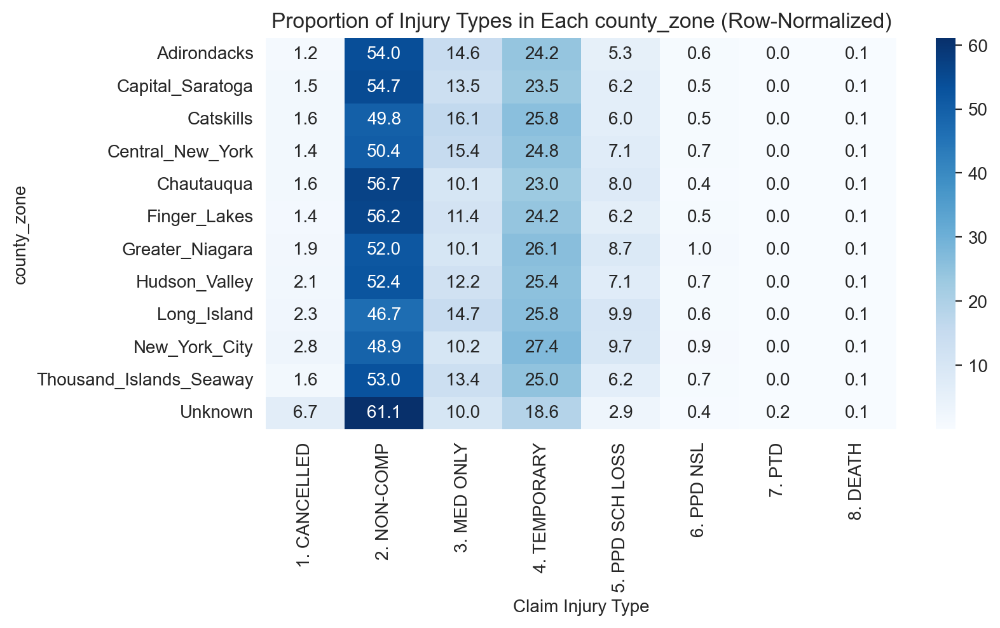

In [147]:
# Create a crosstab for proportions of injuries by cause and injury type, normalized by rows
county_zone_final_by_injury_type_proportion = pd.crosstab(df_dates['county_zone'], df_dates['Claim Injury Type'], normalize='index') * 100  # Normalize by rows so each cause sums to 1

plt.figure(figsize=(8, 4))

# Create the heatmap
sns.heatmap(county_zone_final_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f')

plt.ylabel('county_zone')
plt.xlabel('Claim Injury Type')
plt.title('Proportion of Injury Types in Each county_zone (Row-Normalized)')
plt.show()

<a class="anchor" id="3rd-bullet">

## Body Part
    
</a>

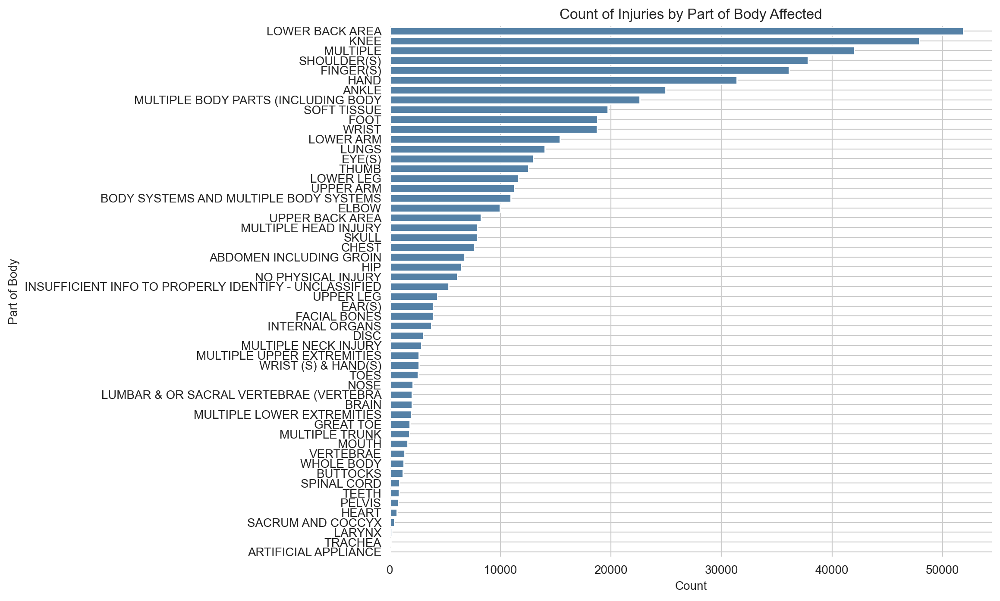

In [148]:
# Count the occurrences of each part of the body affected
body_part_counts = df_dates['WCIO Part Of Body Description'].value_counts()

# Plot the data
plt.figure(figsize=(9, 8))
sns.barplot(x=body_part_counts.values, y=body_part_counts.index, color='#4782B4')
plt.xlabel('Count')
plt.ylabel('Part of Body')
plt.title('Count of Injuries by Part of Body Affected')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

<a class="anchor" id="3rd-bullet">

## Body Part Groups
    
</a>

The group decided to create a copy of the dataset to explore the WCIO variables categorized

In [149]:
df_wcio_grouped = df_train.copy()

In [150]:
df_wcio_grouped[pd.isnull(df_wcio_grouped["WCIO Part Of Body Description"])][["Claim Injury Type"]].value_counts()

Claim Injury Type
2. NON-COMP          8779
1. CANCELLED         6776
4. TEMPORARY          885
3. MED ONLY           391
5. PPD SCH LOSS       163
6. PPD NSL             70
8. DEATH               17
7. PTD                  1
Name: count, dtype: int64

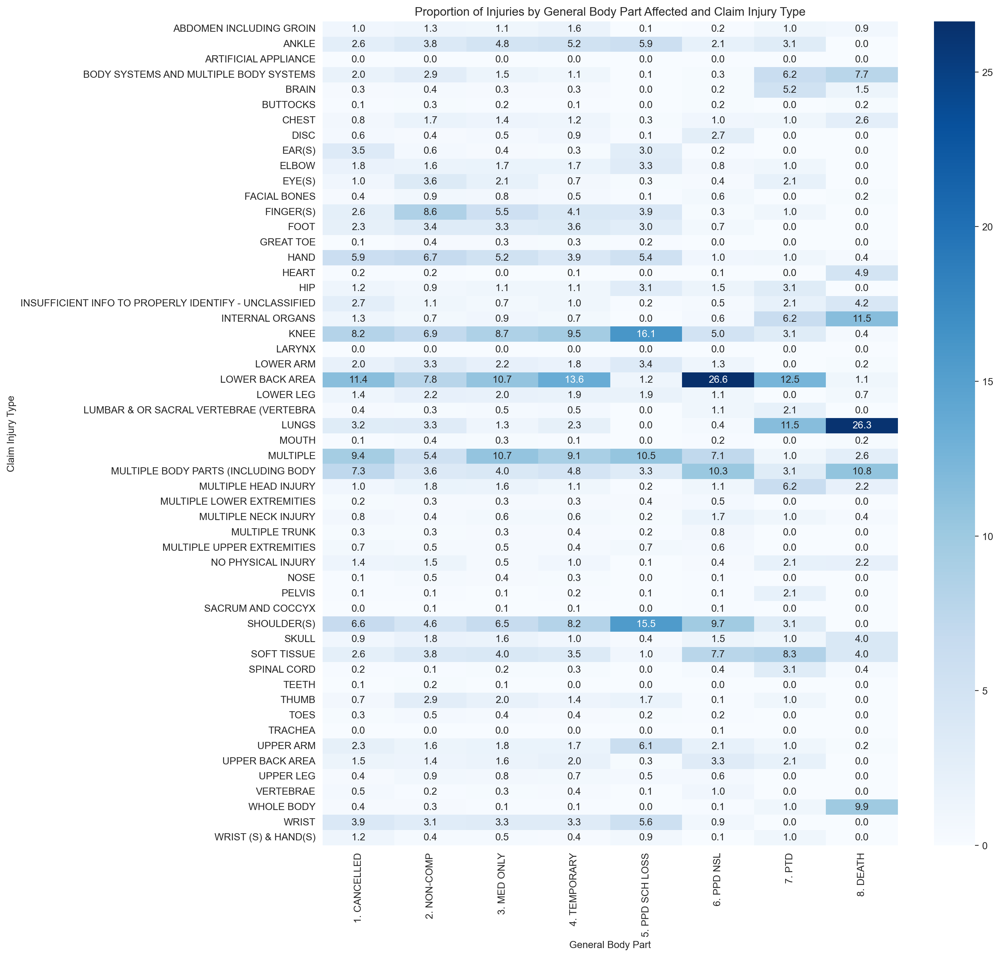

In [151]:
#body_part_by_injury_type = pd.crosstab(df_train['Claim Injury Type'], df_train['general_body_part'])
body_part_initial_by_injury_type_proportion = pd.crosstab(df_wcio_grouped['WCIO Part Of Body Description'], df_wcio_grouped['Claim Injury Type'], normalize='columns') * 100
plt.figure(figsize=(13, 15))
sns.heatmap(body_part_initial_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f')
plt.xlabel('General Body Part')
plt.ylabel('Claim Injury Type')
plt.title('Proportion of Injuries by General Body Part Affected and Claim Injury Type')
plt.show()

In [152]:
df_wcio_grouped["WCIO Part Of Body Code"].unique()

<IntegerArray>
[  62,   38,   10,   36,   60,   14,   55,   53,   37,   42,   61,   54,   51,
   52,   17,   34,   23,   35,   18,   31,   25,   56,   32,   30,   90,   91,
   20,   44,   39,   13,   50,   43,   33,   -9,   22,   41,   11,   57,   19,
 <NA>,   16,   66,   40,   99,   65,   46,   15,   58,   48,   49,   21,   63,
   12,   45,   64,   24,   47,   26]
Length: 58, dtype: Int64

In [153]:
df_wcio_grouped[df_wcio_grouped["WCIO Part Of Body Code"] == 42][["WCIO Part Of Body Code", 'WCIO Part Of Body Description']]

,WCIO Part Of Body Code,WCIO Part Of Body Description
Claim Identifier,,
5393838,42,LOWER BACK AREA
5393888,42,LOWER BACK AREA
5394129,42,LOWER BACK AREA
5394112,42,LOWER BACK AREA
5393823,42,LOWER BACK AREA
...,...,...
6164439,42,LOWER BACK AREA
6165390,42,LOWER BACK AREA
6164934,42,LOWER BACK AREA


In [154]:
def categorize_body_part_code(code):
    if 10 <= code <= 19:
        return 1  # Head
    elif 20 <= code <= 29:
        return 2  # Neck
    elif 30 <= code <= 39:
        return 3  # Upper Extremities
    elif (40 <= code <= 49) or (60 <= code <= 63) or code == 51:
        return 4  # Trunk
    elif 50 <= code <= 59:
        return 5  # Lower Extremities
    elif code == 91:
        return 6  # Body Systems
    elif code == 64:
        return 7 # ARTIFICIAL APPLIANCE
    elif code == 65:
        return 8 # INSUFFICIENT INFO
    elif code == 66:
        return 9 # NO PHYSICAL INJURY
    elif 67 <= code <= 99 or code == -9:
        return 10  # Multiple Body Parts
    else:
        return 11 # Not_applied
    
def categorize_body_part_description(code):
    if 10 <= code <= 19:
        return 'Head'
    elif 20 <= code <= 29:
        return 'Neck'
    elif 30 <= code <= 39:
        return 'Upper Extremities'
    elif (40 <= code <= 49) or (60 <= code <= 63) or code == 51:
        return 'Trunk'
    elif 50 <= code <= 59:
        return 'Lower Extremities'
    elif code == 91:
        return 'Body Systems'
    elif code == 64:
        return 'ARTIFICIAL APPLIANCE'
    elif code == 65:
        return 'INSUFFICIENT INFO'
    elif code == 66:
        return 'NO PHYSICAL INJURY'
    elif 67 <= code <= 99 or code == -9:
        return 'Multiple Body Parts'
    else:
        return 'Not_applied'

df_wcio_grouped['general_body_part_code'] = df_wcio_grouped['WCIO Part Of Body Code'].apply(categorize_body_part_code)
df_wcio_grouped['general_body_part'] = df_wcio_grouped['WCIO Part Of Body Code'].apply(categorize_body_part_description)

df_wcio_grouped[['WCIO Part Of Body Code', 'general_body_part_code', 'general_body_part']].head()

,WCIO Part Of Body Code,general_body_part_code,general_body_part
Claim Identifier,,,
5393875,62,4,Trunk
5393091,38,3,Upper Extremities
5393889,10,1,Head
5393887,36,3,Upper Extremities
5393863,38,3,Upper Extremities


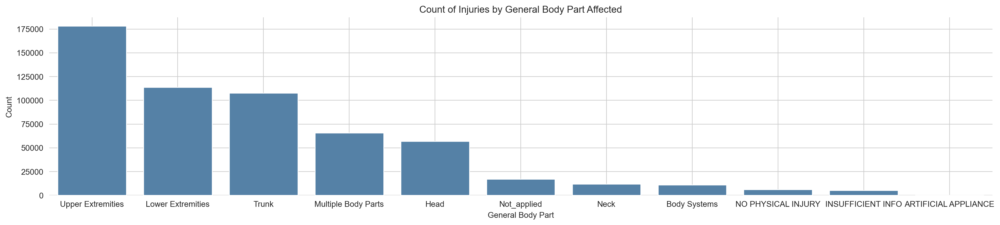

In [155]:
general_body_part_counts = df_wcio_grouped['general_body_part'].value_counts().sort_index()
general_body_part_counts.sort_values(ascending=False, inplace=True)
plt.figure(figsize=(21, 4))
sns.barplot(x=general_body_part_counts.index, y=general_body_part_counts.values, color='#4782B4')
plt.xlabel('General Body Part')
plt.ylabel('Count')
plt.title('Count of Injuries by General Body Part Affected')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

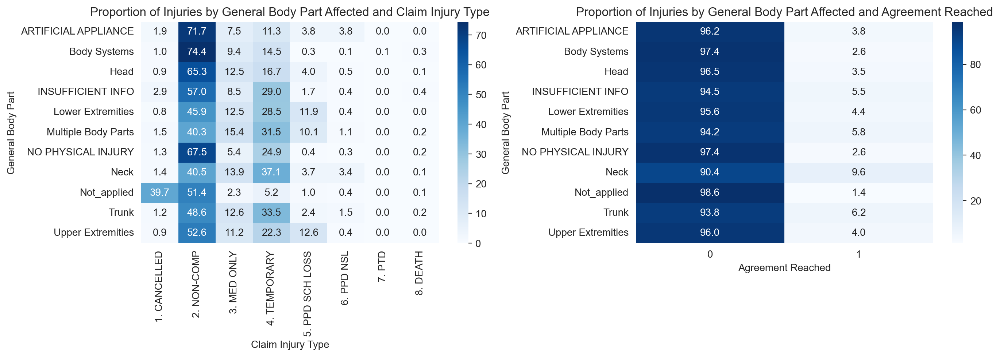

In [156]:
# Create the first crosstab for proportions of "Claim Injury Type" by "General Body Part"
body_part_by_injury_type_proportion = pd.crosstab(
    df_wcio_grouped['general_body_part'], 
    df_wcio_grouped['Claim Injury Type'], 
    normalize='index') * 100  # Normalize by columns so each cause sums to 1

# Create the second crosstab for proportions of "Agreement Reached" by "General Body Part"
body_part_by_agreement_proportion = pd.crosstab(
    df_wcio_grouped['general_body_part'], 
    df_wcio_grouped['Agreement Reached'], 
    normalize='index') * 100  # Normalize by columns so each cause sums to 1

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(body_part_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('General Body Part')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injuries by General Body Part Affected and Claim Injury Type')

sns.heatmap(body_part_by_agreement_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('General Body Part')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Injuries by General Body Part Affected and Agreement Reached')

plt.tight_layout()
plt.show()

<a class="anchor" id="3rd-bullet">

## Cause of Injury Groups
    
</a>

In [157]:
cause_injury_code_descriptions = df_wcio_grouped.groupby('WCIO Cause of Injury Code')['WCIO Cause of Injury Description'].unique()

# Convert the result to a DataFrame for better readability
cause_injury_code_descriptions_df = cause_injury_code_descriptions.reset_index()
cause_injury_code_descriptions_df.columns = ['WCIO Cause of Injury Code', 'WCIO Cause of Injury Descriptions']

cause_injury_code_descriptions_df

,WCIO Cause of Injury Code,WCIO Cause of Injury Descriptions
0,1,[CHEMICALS]
1,2,[HOT OBJECTS OR SUBSTANCES]
2,3,[TEMPERATURE EXTREMES]
3,4,[FIRE OR FLAME]
4,5,[STEAM OR HOT FLUIDS]
...,...,...
72,95,"[RUBBED OR ABRADED, NOC]"
73,96,[TERRORISM]
74,97,[REPETITIVE MOTION]
75,98,"[CUMULATIVE, NOC]"


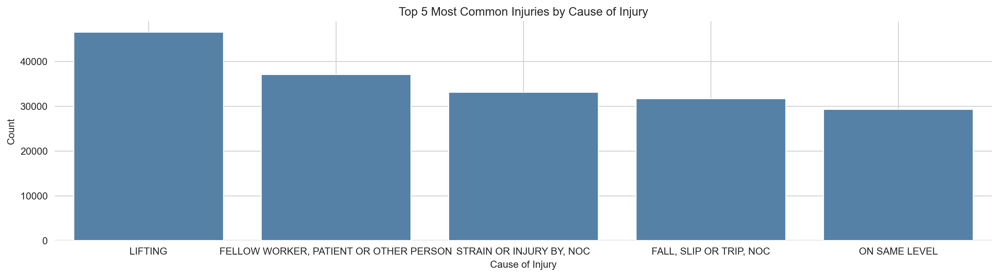

In [158]:
# Get the top 5 most common causes of injury
cause_injury_counts = df_wcio_grouped['WCIO Cause of Injury Description'].value_counts()
top5_cause_injury = cause_injury_counts.nlargest(5)

# Plot the data
plt.figure(figsize=(17, 4))
sns.barplot(y=top5_cause_injury.values, x=top5_cause_injury.index, color='#4782B4')
plt.ylabel('Count')
plt.xlabel('Cause of Injury')
plt.title('Top 5 Most Common Injuries by Cause of Injury')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

In [159]:
df_wcio_grouped['WCIO Cause of Injury Code'].unique()

<IntegerArray>
[  27,   97,   79,   16,   31,   19,   99,   81,   75,    1,   45,   56,   53,
   29,   60,   50,   25,   57,   87,   74,    5,   68,   32,   82,   89,   17,
   28,   33,   26,   30,   54,   66,   77,   95,   58,   12,    2,   84,   55,
   13, <NA>,    4,   98,   18,   70,   10,   11,   15,   46,   69,   80,    6,
   90,    9,   59,   67,   52,   85,   78,   93,   61,   65,    3,   76,   48,
   94,   20,   96,   83,    7,   88,   86,    8,   41,   91,   14,   40,   47]
Length: 78, dtype: Int64

In [160]:
df_wcio_grouped[df_wcio_grouped["WCIO Cause of Injury Code"] == 88][["WCIO Cause of Injury Code", 'Claim Injury Type']]

,WCIO Cause of Injury Code,Claim Injury Type
Claim Identifier,,
5403728,88,2. NON-COMP
5460878,88,4. TEMPORARY
5461026,88,4. TEMPORARY
5461958,88,2. NON-COMP
5461362,88,2. NON-COMP
...,...,...
6161885,88,2. NON-COMP
6164809,88,2. NON-COMP
6164448,88,2. NON-COMP


In [161]:
df_wcio_grouped[df_wcio_grouped["WCIO Cause of Injury Description"] == 'REPETITIVE MOTION'].groupby('Claim Injury Type')[["WCIO Cause of Injury Code", 'Claim Injury Type']].value_counts()

Claim Injury Type  WCIO Cause of Injury Code
1. CANCELLED       97                            516
                   94                             34
2. NON-COMP        97                           4612
                   94                            295
3. MED ONLY        97                           1577
                   94                             78
4. TEMPORARY       97                           2742
                   94                            189
5. PPD SCH LOSS    97                           2224
                   94                            106
6. PPD NSL         97                             63
                   94                              3
8. DEATH           97                              1
Name: count, dtype: int64

In [162]:
def categorize_cause_injury_code(code):
    if code == 86:
        return 1  # Fires and Explosions
    elif (12 <= code <= 13) or (16 <= code <= 20) or (68 <= code <= 70) or (74 <= code <= 76) or (78 <= code <= 81) or code == 87 or code == 95:
        return 2  # Contact with Objects and Equipment
    elif 25 <= code <= 33:
        return 3  # Fall, Slip or Trip Injury
    elif 40 <= code <= 50:
        return 4  # Transportation Incidents
    elif (1 <= code <= 11) or (14 <= code <= 15) or code == 52 or code == 82 or code == 84 :
        return 5  # Exposure to Harmful Substances or Environments
    elif (53 <= code <= 67) or code == 97 or code == 77 or code == 94:
        return 6  # OVEREXERTION AND BODILY REACTION
    elif code == 85 or (89 <= code <= 90) or code == 93:
        return 7  # Violence and Other Injuries by Persons or Animals
    elif code == 98:
        return 8 # Cumulative
    elif code == 88:
        return 9  # Natural Disasters
    elif code == 83 or code == 91:
        return 10  # Pandemic
    elif code == 96:
        return 11  # Terrorism
    elif code == 99:
        return 12 # MISCELLANEOUS
    else:
        return 13 # Not_applied     
    
def categorize_cause_injury_description(code):
    if code == 86:
        return 'Fires and Explosions'
    elif (12 <= code <= 13) or (16 <= code <= 20) or (68 <= code <= 70) or (74 <= code <= 76) or (78 <= code <= 81) or code == 87 or code == 95:
        return 'Contact with Objects and Equipment'
    elif 25 <= code <= 33:
        return 'Fall, Slip or Trip Injury'
    elif 40 <= code <= 50:
        return 'Transportation Incidents'
    elif (1 <= code <= 11) or (14 <= code <= 15) or code == 52 or code == 82 or code == 84:
        return 'Exposure to Harmful Substances or Environments'
    elif (53 <= code <= 67) or code == 97 or code == 77 or code == 94:
        return 'Overexertion and Bodily Reaction'
    elif code == 85 or (89 <= code <= 90) or code == 93:
        return 'Violence and Other Injuries by Persons or Animals'
    elif code == 98:
        return 'Cumulative'
    elif code == 88:
        return 'Natural Disasters'
    elif code == 83 or code == 91:
        return 'Pandemic'
    elif code == 96:
        return 'Terrorism'
    elif code == 99:
        return 'Miscellaneous'
    else:
        return "Not_applied"     
    

df_wcio_grouped['general_cause_injury_code'] = df_wcio_grouped['WCIO Cause of Injury Code'].apply(categorize_cause_injury_code)
df_wcio_grouped['general_cause_injury'] = df_wcio_grouped['WCIO Cause of Injury Code'].apply(categorize_cause_injury_description)

df_wcio_grouped[['WCIO Cause of Injury Code', 'general_cause_injury_code', 'general_cause_injury']].head()

,WCIO Cause of Injury Code,general_cause_injury_code,general_cause_injury
Claim Identifier,,,
5393875,27,3,"Fall, Slip or Trip Injury"
5393091,97,6,Overexertion and Bodily Reaction
5393889,79,2,Contact with Objects and Equipment
5393887,16,2,Contact with Objects and Equipment
5393863,31,3,"Fall, Slip or Trip Injury"


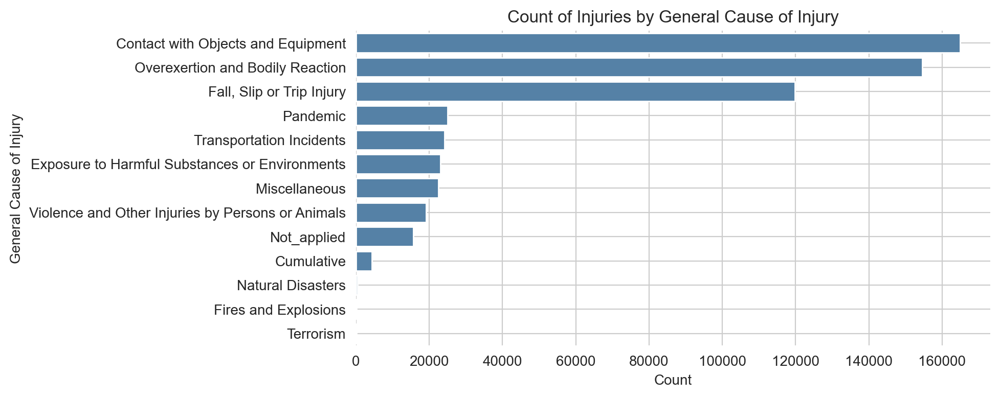

In [163]:
general_cause_injury_counts = df_wcio_grouped['general_cause_injury'].value_counts().sort_index()
general_cause_injury_counts .sort_values(ascending=False, inplace=True)
plt.figure(figsize=(8, 4))
sns.barplot(y=general_cause_injury_counts.index, x=general_cause_injury_counts.values, color='#4782B4')
plt.ylabel('General Cause of Injury')
plt.xlabel('Count')
plt.title('Count of Injuries by General Cause of Injury')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

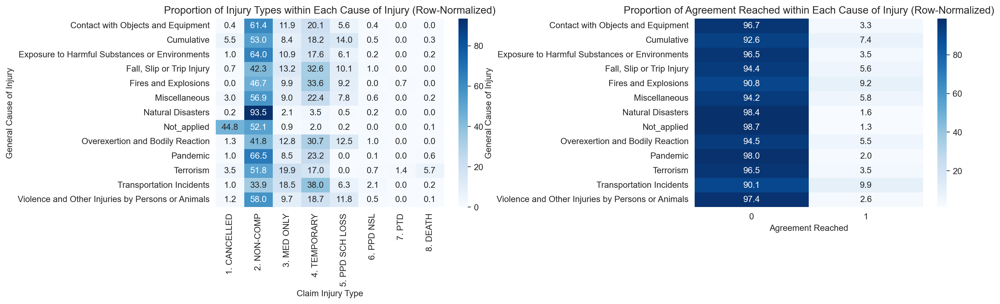

In [164]:
# Create the first crosstab for proportions of "Claim Injury Type" by "General Cause of Injury"
causeinjury_by_injury_type_proportion = pd.crosstab(
    df_wcio_grouped['general_cause_injury'], 
    df_wcio_grouped['Claim Injury Type'], 
    normalize='index') * 100  # Normalize by rows so each cause sums to 1

# Create the second crosstab for proportions of "Agreement Reached" by "General Cause of Injury"
causeinjury_by_agreement_proportion = pd.crosstab(
    df_wcio_grouped['general_cause_injury'], 
    df_wcio_grouped['Agreement Reached'], 
    normalize='index') * 100  # Normalize by rows so each cause sums to 1

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 5))

sns.heatmap(causeinjury_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('General Cause of Injury')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types within Each Cause of Injury (Row-Normalized)')

sns.heatmap(causeinjury_by_agreement_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('General Cause of Injury')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached within Each Cause of Injury (Row-Normalized)')

plt.tight_layout()
plt.show()


<a class="anchor" id="3rd-bullet">

## Industry
    
</a>

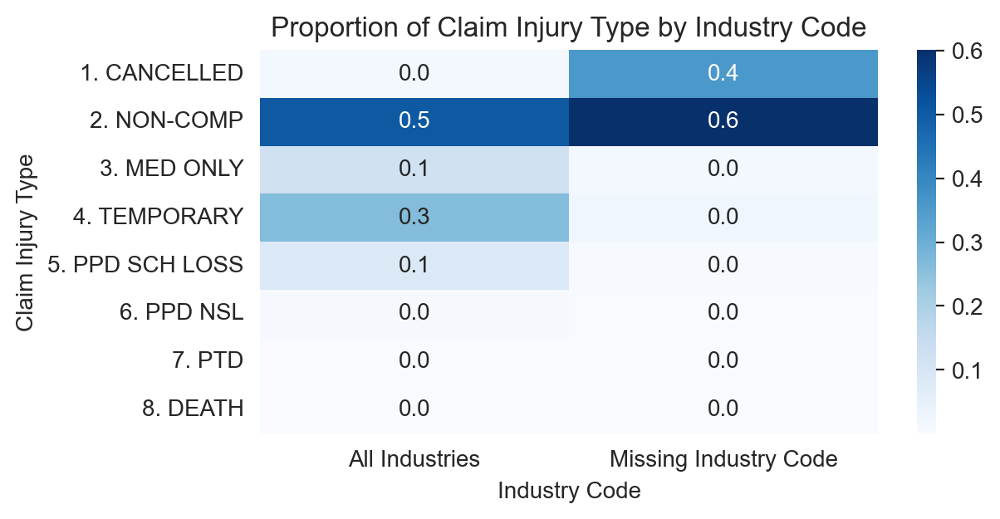

In [165]:
# Create a DataFrame for plotting
distribution_df = pd.DataFrame({
    'All Industries': df_wcio_grouped[df_wcio_grouped['Industry Code'].notnull()]['Claim Injury Type'].value_counts(),
    'Missing Industry Code': df_wcio_grouped[df_wcio_grouped['Industry Code'].isnull()]['Claim Injury Type'].value_counts()
})

# Normalize the data to get proportions for each industry type
distribution_df = distribution_df.div(distribution_df.sum(axis=0), axis=1)

# Create a heatmap
plt.figure(figsize=(6, 3))
sns.heatmap(distribution_df, annot=True, fmt=".1f", cmap='Blues', cbar=True)
plt.title('Proportion of Claim Injury Type by Industry Code')
plt.xlabel('Industry Code')
plt.ylabel('Claim Injury Type')
plt.show()


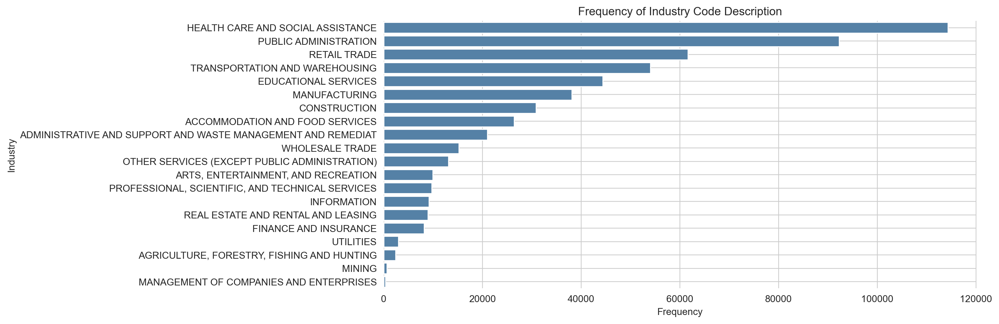

In [166]:
df_wcio_grouped['Industry Code Description'].value_counts()
plt.figure(figsize=(11, 5))
sns.barplot(x=df_wcio_grouped['Industry Code Description'].value_counts().values, y=df_wcio_grouped['Industry Code Description'].value_counts().index, color='#4782B4')
plt.xlabel('Frequency')
plt.ylabel('Industry')
plt.title('Frequency of Industry Code Description')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

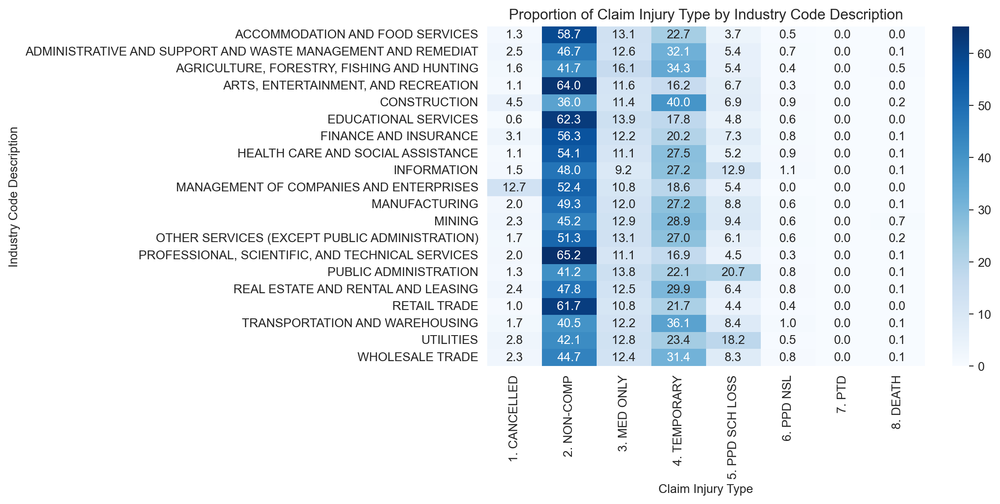

In [167]:
industry_by_claim_injury_proportion = pd.crosstab(df_wcio_grouped['Industry Code Description'], df_wcio_grouped['Claim Injury Type'], normalize='index') * 100
plt.figure(figsize=(8, 5))
sns.heatmap(industry_by_claim_injury_proportion, cmap='Blues', annot=True, fmt='.1f')
plt.xlabel('Claim Injury Type')
plt.ylabel('Industry Code Description')
plt.title('Proportion of Claim Injury Type by Industry Code Description')
plt.show()

<a class="anchor" id="3rd-bullet">

## Industry Code Groups
    
</a>

In [168]:
df_wcio_grouped['Industry Code'].unique()

<IntegerArray>
[  44,   23,   56,   62,   72,   61,   51,   31,   48,   45,   42,   53,   52,
   49,   81,   92,   33,   54,   32,   71, <NA>,   22,   11,   21,   55]
Length: 25, dtype: Int64

In [169]:
df_wcio_grouped[df_wcio_grouped['Industry Code'] == 51][["Industry Code", 'Industry Code Description', "Claim Injury Type"]]

,Industry Code,Industry Code Description,Claim Injury Type
Claim Identifier,,,
5394187,51,INFORMATION,2. NON-COMP
5393956,51,INFORMATION,2. NON-COMP
5394008,51,INFORMATION,2. NON-COMP
5393982,51,INFORMATION,2. NON-COMP
5394086,51,INFORMATION,2. NON-COMP
...,...,...,...
6165329,51,INFORMATION,4. TEMPORARY
6165335,51,INFORMATION,2. NON-COMP
6165275,51,INFORMATION,4. TEMPORARY


In [170]:
# OR function if it´s easier to read: 

def categorize_industry_code_final(code):
    if code == 11:
        return 1  # AGRICULTURE, FORESTRY, FISHING AND HUNTING
    elif 23 <= code <= 24:
        return 2  # Construction
    elif 30 <= code <= 33:
        return 3  # Manufacturing
    elif 42 <= code <= 45:
        return 4  # Trade
    elif 48 <= code <= 49:
        return 5  # Transporting and Warehousing
    elif code == 62:
        return 6  # HEALTH CARE AND SOCIAL ASSISTANCE
    elif 50 <= code <= 81 or code == 22:
        return 7  # Services
    elif code == 92:
        return 8  # Public Sector
    elif code == 21:
        return 9  # MINING
    else:
        return 10 # Unknown - could be unemployed
    
def categorize_industry_description_final(code):
    if code == 11:
        return "AGRICULTURE, FORESTRY, FISHING AND HUNTING"
    elif 23 <= code <= 24:
        return "Construction"
    elif 30 <= code <= 33:
        return "Manufacturing"
    elif 42 <= code <= 45:
        return "Trade"
    elif 48 <= code <= 49:
        return "Transporting and Warehousing"
    elif code == 62:
        return "HEALTH CARE AND SOCIAL ASSISTANCE"
    elif 50 <= code <= 81 or code == 22:
        return "Services"
    elif code == 92:
        return "Public Sector"
    elif code == 21:
        return 'MINING'
    else:
        return 'Unknown'

df_wcio_grouped['general_industry_code'] = df_wcio_grouped['Industry Code'].apply(categorize_industry_code_final)
df_wcio_grouped['general_industry_description'] = df_wcio_grouped['Industry Code'].apply(categorize_industry_description_final)

df_wcio_grouped[['Industry Code', 'Industry Code Description', 'general_industry_code', 'general_industry_description']].head()

,Industry Code,Industry Code Description,general_industry_code,general_industry_description
Claim Identifier,,,,
5393875,44,RETAIL TRADE,4,Trade
5393091,23,CONSTRUCTION,2,Construction
5393889,56,ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMEN...,7,Services
5393887,62,HEALTH CARE AND SOCIAL ASSISTANCE,6,HEALTH CARE AND SOCIAL ASSISTANCE
5393863,44,RETAIL TRADE,4,Trade


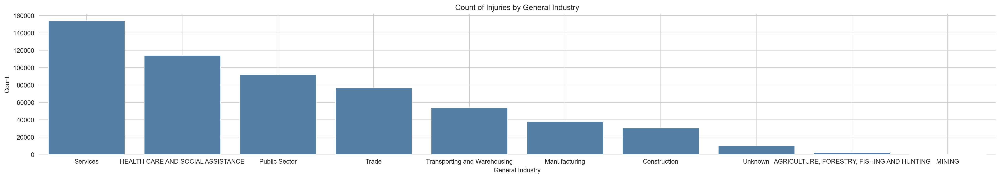

In [171]:
general_industry_counts = df_wcio_grouped['general_industry_description'].value_counts().sort_index()
general_industry_counts.sort_values(ascending=False, inplace=True)
plt.figure(figsize=(27, 4))
sns.barplot(x=general_industry_counts.index, y=general_industry_counts.values, color='#4782B4')
plt.xlabel('General Industry')
plt.ylabel('Count')
plt.title('Count of Injuries by General Industry')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

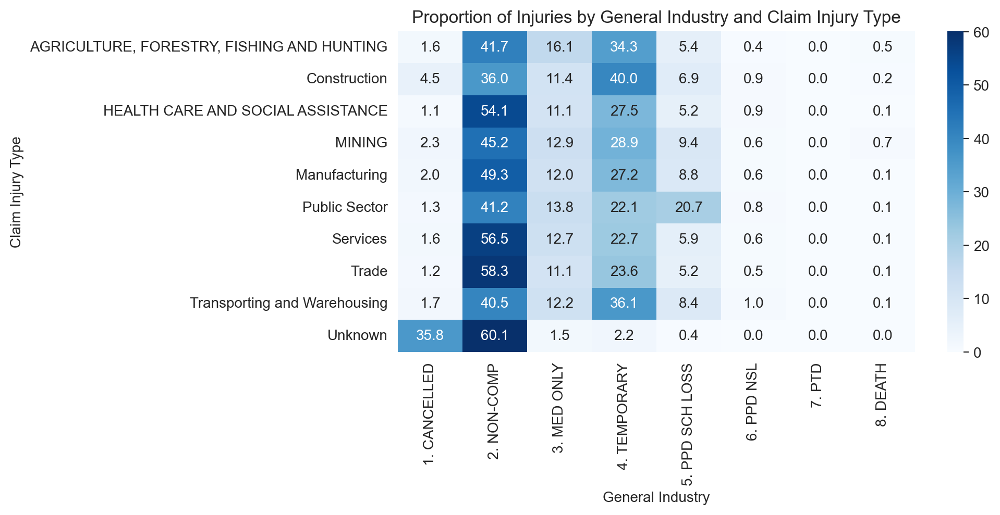

In [172]:
claim_injury_by_general_industry_propotion = pd.crosstab(df_wcio_grouped['Claim Injury Type'], df_wcio_grouped['general_industry_description'], normalize='columns') * 100
plt.figure(figsize=(8, 4))
sns.heatmap(claim_injury_by_general_industry_propotion.T, cmap='Blues', annot=True, fmt='.1f')
plt.xlabel('General Industry')
plt.ylabel('Claim Injury Type')
plt.title('Proportion of Injuries by General Industry and Claim Injury Type')
plt.show()

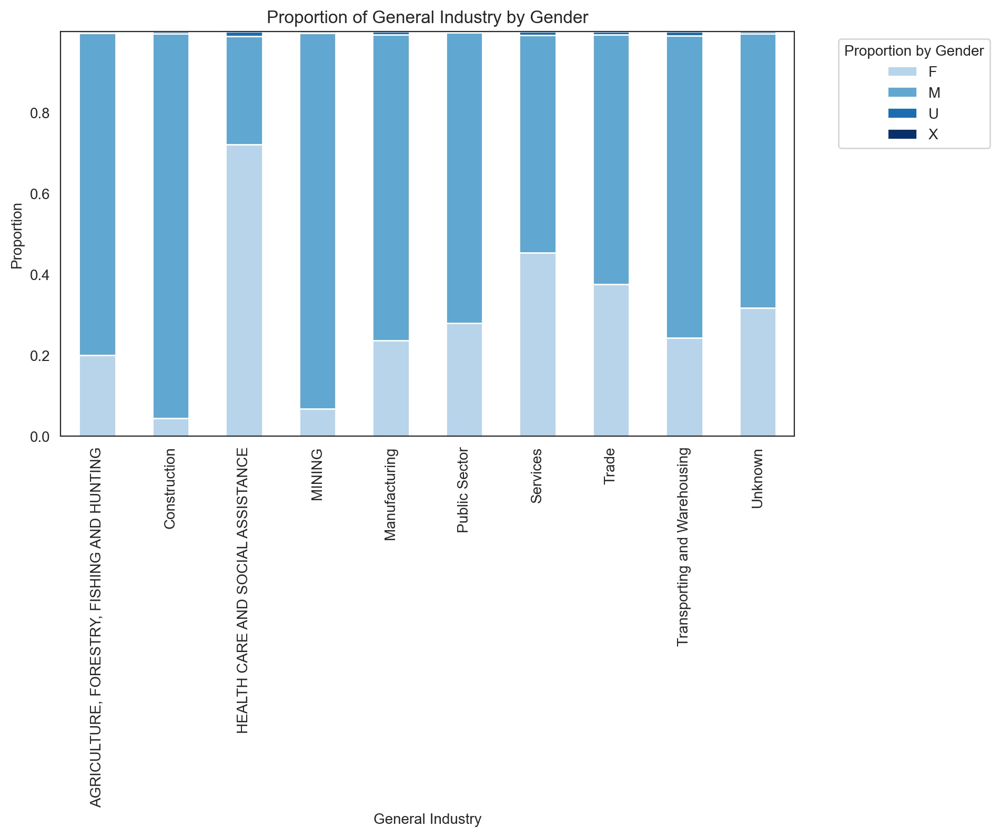

In [173]:
industry_by_gender = df_wcio_grouped.groupby(["general_industry_description", "Gender"]).size().unstack()
industry_by_gender = industry_by_gender.div(industry_by_gender.sum(axis=1), axis=0)

industry_by_gender.plot(kind='bar', stacked=True, figsize=(9, 5), colormap=truncated_blues)
plt.title('Proportion of General Industry by Gender')
plt.ylabel('Proportion')
plt.xlabel('General Industry')
plt.legend(title='Proportion by Gender', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

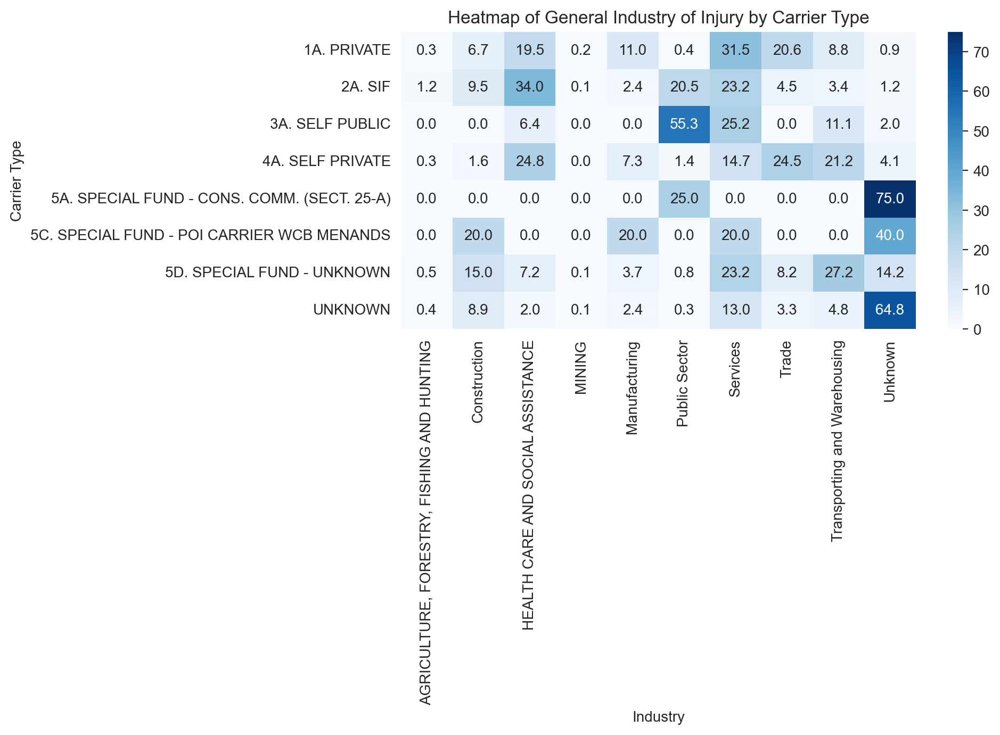

In [174]:
industry_by_carrier = pd.crosstab(df_wcio_grouped['Carrier Type'], df_wcio_grouped['general_industry_description'], normalize='index') * 100
plt.figure(figsize=(10, 7))
sns.heatmap(industry_by_carrier, cmap='Blues', annot=True, fmt='.1f')

plt.title('Heatmap of General Industry of Injury by Carrier Type')
plt.ylabel('Carrier Type')
plt.xlabel('Industry')
plt.tight_layout()
plt.show()

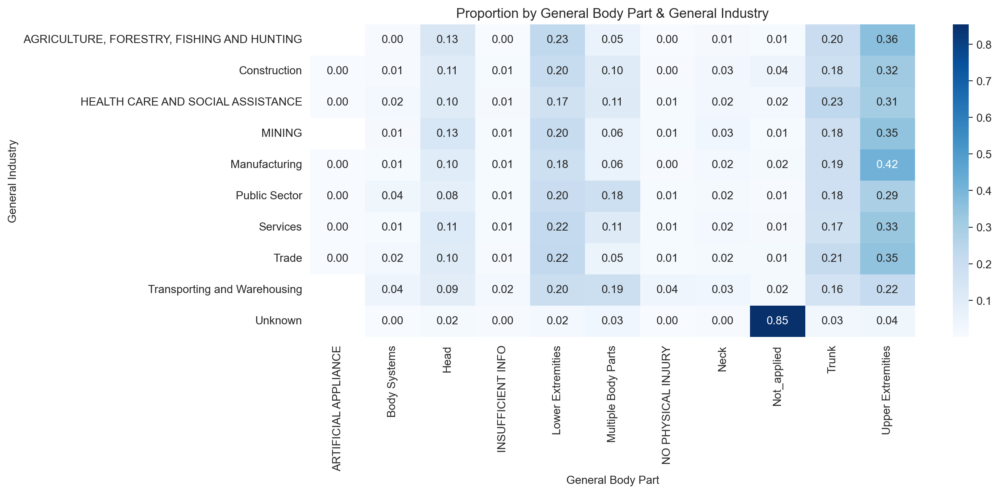

In [175]:
# Group by general industry description and general body part, then calculate the size
general_body_part_by_general_industry = df_wcio_grouped.groupby(["general_industry_description", "general_body_part"]).size().unstack()

# Normalize the data to get proportions
general_body_part_by_general_industry = general_body_part_by_general_industry.div(general_body_part_by_general_industry.sum(axis=1), axis=0)

# Create the heatmap
plt.figure(figsize=(12, 5))
sns.heatmap(general_body_part_by_general_industry, cmap='Blues', annot=True, fmt='.2f')

# Add labels and title
plt.title('Proportion by General Body Part & General Industry')
plt.ylabel('General Industry')
plt.xlabel('General Body Part')
plt.show()


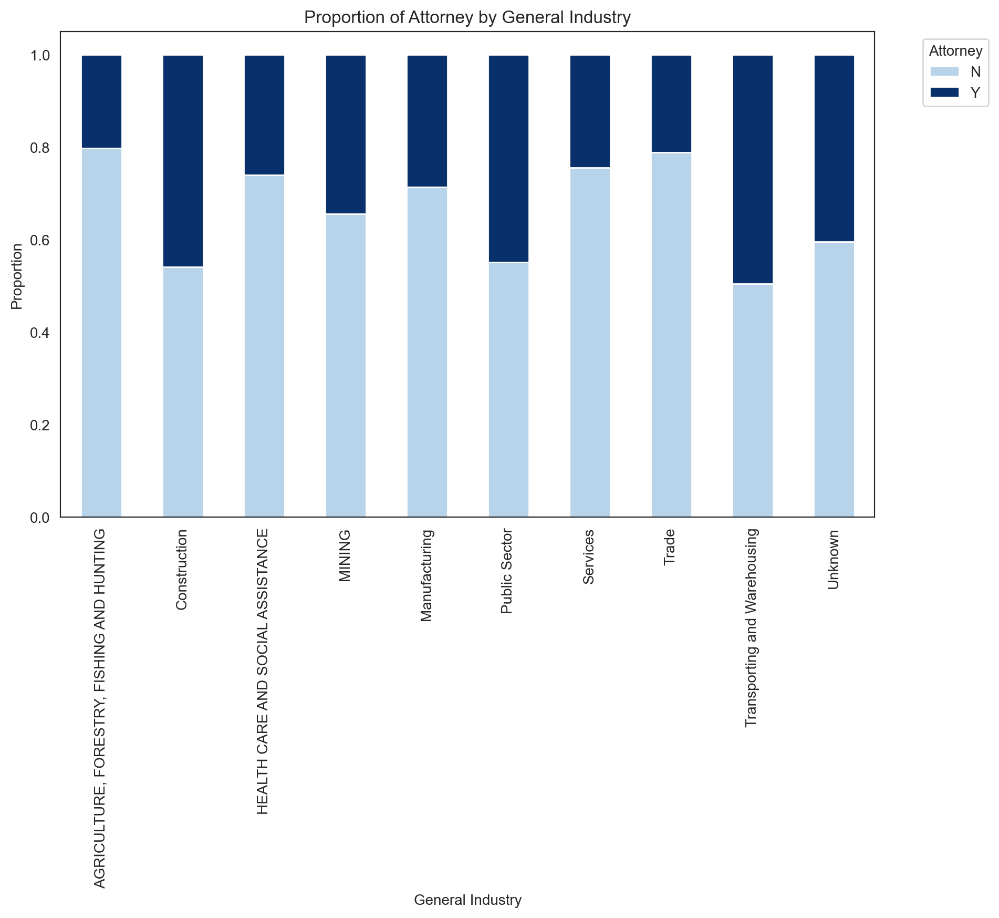

In [176]:
attorney_by_general_industry = df_wcio_grouped.groupby(["general_industry_description", "Attorney/Representative"]).size().unstack()
attorney_by_general_industry = attorney_by_general_industry.div(attorney_by_general_industry.sum(axis=1), axis=0)

attorney_by_general_industry.plot(kind='bar', stacked=True, figsize=(10, 6), colormap=truncated_blues)
plt.title('Proportion of Attorney by General Industry')
plt.ylabel('Proportion')
plt.xlabel('General Industry')
plt.legend(title='Attorney', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

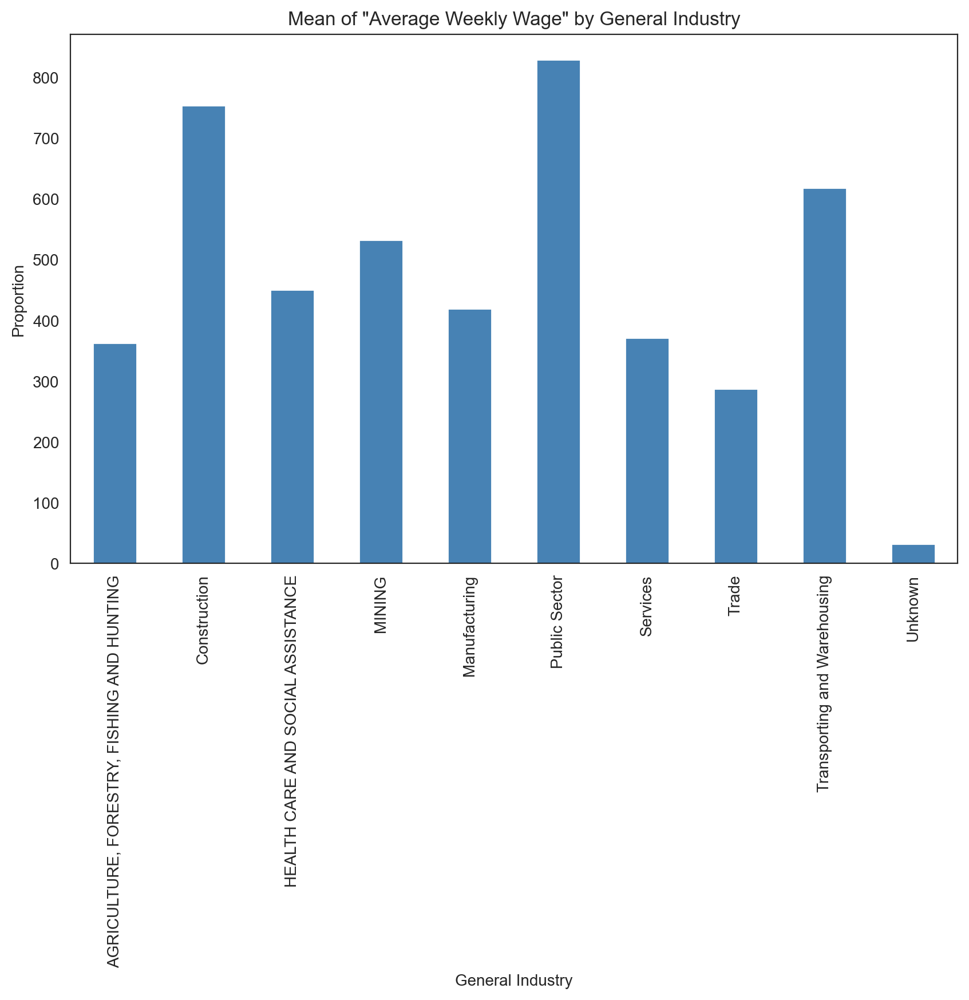

In [177]:
avg_weekly_wage_by_general_industry = df_wcio_grouped.groupby("general_industry_description")["Average Weekly Wage"].mean()

avg_weekly_wage_by_general_industry.plot(kind='bar', stacked=True, figsize=(10, 6), color='#4782B4')
plt.title('Mean of "Average Weekly Wage" by General Industry')
plt.ylabel('Proportion')
plt.xlabel('General Industry')
plt.show()

<a class="anchor" id="3rd-bullet">

## Nature of Injury Groups
    
</a>

In [178]:
df_wcio_grouped[df_wcio_grouped["WCIO Nature of Injury Code"] == 19][["WCIO Nature of Injury Code", 'WCIO Nature of Injury Description', 'Claim Injury Type',"WCIO Cause of Injury Description"]]

,WCIO Nature of Injury Code,WCIO Nature of Injury Description,Claim Injury Type,WCIO Cause of Injury Description
Claim Identifier,,,,
5395348,19,ELECTRIC SHOCK,2. NON-COMP,"OTHER - MISCELLANEOUS, NOC"
5395459,19,ELECTRIC SHOCK,4. TEMPORARY,MOVING PART OF MACHINE
5395134,19,ELECTRIC SHOCK,2. NON-COMP,"STRUCK OR INJURED, NOC"
5397191,19,ELECTRIC SHOCK,2. NON-COMP,LIFTING
5397898,19,ELECTRIC SHOCK,2. NON-COMP,ELECTRICAL CURRENT
...,...,...,...,...
6158891,19,ELECTRIC SHOCK,2. NON-COMP,ELECTRICAL CURRENT
6159443,19,ELECTRIC SHOCK,2. NON-COMP,ELECTRICAL CURRENT
6161157,19,ELECTRIC SHOCK,3. MED ONLY,ELECTRICAL CURRENT


In [179]:
def categorize_nature_injury_code_final(code):
    # DISEASES AND DISORDERS OF BODY SYSTEMS
    if code in [3, 16, 41, 55, 58, 60, 61, 62, 63, 64, 65, 68, 71, 72, 78, 80]:   # Mapping based on codes from your list
        return 1  # DISEASES AND DISORDERS OF BODY SYSTEMS

    # Traumatic Injuries and Disorders
    elif code in [2, 4, 7, 10, 13, 19, 22, 25, 28, 32, 34, 40, 42, 43, 46, 47, 49, 52, 53, 54, 59, 67, 70]:  # Codes for traumatic injuries
        return 2  # Traumatic Injuries and Disorders
    
    # EXPOSURE TO HARMFUL SUBSTANCES OR ENVIRONMENTS 
    elif code in [30, 31, 38]:  # Codes for harmful substances
        return 3  # EXPOSURE TO HARMFUL SUBSTANCES OR ENVIRONMENTS

    # INFECTIOUS AND PARASITIC DISEASES  
    elif code in [36, 66, 73, 79, 83]:  # Codes for infectous diseases
        return 4  # INFECTIOUS AND PARASITIC DISEASES 

    # SYMPTOMS, SIGNS, AND ILL-DEFINED CONDITIONS 
    elif code in [37]:  # Codes for ill-defined conditions
        return 5  # SYMPTOMS, SIGNS, AND ILL-DEFINED CONDITIONS
    
    # OTHER DISEASES, CONDITIONS, AND DISORDERS
    elif code in [69, 75, 76, 77]:
        return 6  # OTHER DISEASES, CONDITIONS, AND DISORDERS 
    
    # NEOPLASMS, TUMORS, AND CANCERS
    elif code in [74]:
        return 7  # NEOPLASMS, TUMORS, AND CANCERS

    # MULTIPLE DISEASES, CONDITIONS, AND DISORDERS 
    elif code in [90, 91]:
        return 8  # MULTIPLE DISEASES, CONDITIONS, AND DISORDERS 
    
    elif code == 1:
        return 9 # No Psysical Injury
    
    else:
        return 10  # Unclassified or Not applied

def categorize_nature_injury_description_final(code):
    # DISEASES AND DISORDERS OF BODY SYSTEMS
    if code in [3, 16, 41, 55, 58, 60, 61, 62, 63, 64, 65, 68, 71, 72, 78, 80]:   # Mapping based on codes from your list
        return 'DISEASES AND DISORDERS OF BODY SYSTEMS'

    # Traumatic Injuries and Disorders
    elif code in [2, 4, 7, 10, 13, 19, 22, 25, 28, 32, 34, 40, 42, 43, 46, 47, 49, 52, 53, 54, 59, 67, 70]:  # Codes for traumatic injuries
        return 'Traumatic Injuries and Disorders'
    
    # EXPOSURE TO HARMFUL SUBSTANCES OR ENVIRONMENTS 
    elif code in [30, 31, 38]:  # Codes for harmful substances
        return 'EXPOSURE TO HARMFUL SUBSTANCES OR ENVIRONMENTS'

    # INFECTIOUS AND PARASITIC DISEASES  
    elif code in [36, 66, 73, 79, 83]:  # Codes for infectous diseases
        return 'INFECTIOUS AND PARASITIC DISEASES'

    # SYMPTOMS, SIGNS, AND ILL-DEFINED CONDITIONS 
    elif code in [37]:  # Codes for ill-defined conditions
        return 'SYMPTOMS, SIGNS, AND ILL-DEFINED CONDITIONS'
    
    # OTHER DISEASES, CONDITIONS, AND DISORDERS
    elif code in [69, 75, 76, 77]:
        return 'OTHER DISEASES, CONDITIONS, AND DISORDERS' 
    
    # NEOPLASMS, TUMORS, AND CANCERS
    elif code in [74]:
        return 'NEOPLASMS, TUMORS, AND CANCERS'

    # MULTIPLE DISEASES, CONDITIONS, AND DISORDERS 
    elif code in [90, 91]:
        return 'MULTIPLE DISEASES, CONDITIONS, AND DISORDERS'
    
    elif code == 1:
        return 'No Psysical Injury'
    
    else:
        return 'Not_applied'  # Unclassified or unknown

# Applying the categorization functions to your DataFrame
df_wcio_grouped['general_nature_injury_code'] = df_wcio_grouped['WCIO Nature of Injury Code'].apply(categorize_nature_injury_code_final)
df_wcio_grouped['general_nature_injury'] = df_wcio_grouped['WCIO Nature of Injury Code'].apply(categorize_nature_injury_description_final)

# Displaying the result
df_wcio_grouped[['WCIO Nature of Injury Code', 'general_nature_injury_code', 'general_nature_injury']].head()

,WCIO Nature of Injury Code,general_nature_injury_code,general_nature_injury
Claim Identifier,,,
5393875,10,2,Traumatic Injuries and Disorders
5393091,49,2,Traumatic Injuries and Disorders
5393889,7,2,Traumatic Injuries and Disorders
5393887,43,2,Traumatic Injuries and Disorders
5393863,10,2,Traumatic Injuries and Disorders


In [180]:
df_wcio_grouped[df_wcio_grouped['WCIO Nature of Injury Description'] == "HEPATITIS C"]

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,general_body_part_code,general_body_part,general_cause_injury_code,general_cause_injury,general_industry_code,general_industry_description,general_nature_injury_code,general_nature_injury
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5579801,2020-08-20,42,N,2020-10-15,Y,0.0,1977,2020-10-15,NaT,PUBLIC EMPLOYERS RISK MGMT.,3A. SELF PUBLIC,3. MED ONLY,CAYUGA,N,SYRACUSE,NaT,M,NaN,92,PUBLIC ADMINISTRATION,I,79,OBJECT BEING LIFTED OR HANDLED,79,HEPATITIS C,66,NO PHYSICAL INJURY,13045,0,6,9,NO PHYSICAL INJURY,2,Contact with Objects and Equipment,8,Public Sector,4,INFECTIOUS AND PARASITIC DISEASES
5662467,2021-02-15,45,N,2021-02-19,N,0.0,1975,2021-02-19,NaT,STATE INSURANCE FUND,2A. SIF,2. NON-COMP,ERIE,N,BUFFALO,NaT,M,NaN,81,OTHER SERVICES (EXCEPT PUBLIC ADMINISTRATION),I,99,"OTHER - MISCELLANEOUS, NOC",79,HEPATITIS C,91,BODY SYSTEMS AND MULTIPLE BODY SYSTEMS,14006,0,3,6,Body Systems,12,Miscellaneous,7,Services,4,INFECTIOUS AND PARASITIC DISEASES
5799330,2021-08-06,39,N,2021-08-27,N,0.0,1982,2021-08-27,NaT,NASSAU HEALTH CARE CORP.,3A. SELF PUBLIC,2. NON-COMP,NASSAU,N,NYC,NaT,F,NaN,62,HEALTH CARE AND SOCIAL ASSISTANCE,IV,74,"FELLOW WORKER, PATIENT OR OTHER PERSON",79,HEPATITIS C,18,SOFT TISSUE,11590,0,0,1,Head,2,Contact with Objects and Equipment,6,HEALTH CARE AND SOCIAL ASSISTANCE,4,INFECTIOUS AND PARASITIC DISEASES
5995791,2022-05-18,57,N,2022-05-20,N,0.0,1965,2022-05-20,NaT,AIU INSURANCE CO,1A. PRIVATE,2. NON-COMP,SUFFOLK,Y,HAUPPAUGE,NaT,F,NaN,44,RETAIL TRADE,IV,83,PANDEMIC,79,HEPATITIS C,60,LUNGS,11790,0,6,4,Trunk,10,Pandemic,4,Trade,4,INFECTIOUS AND PARASITIC DISEASES


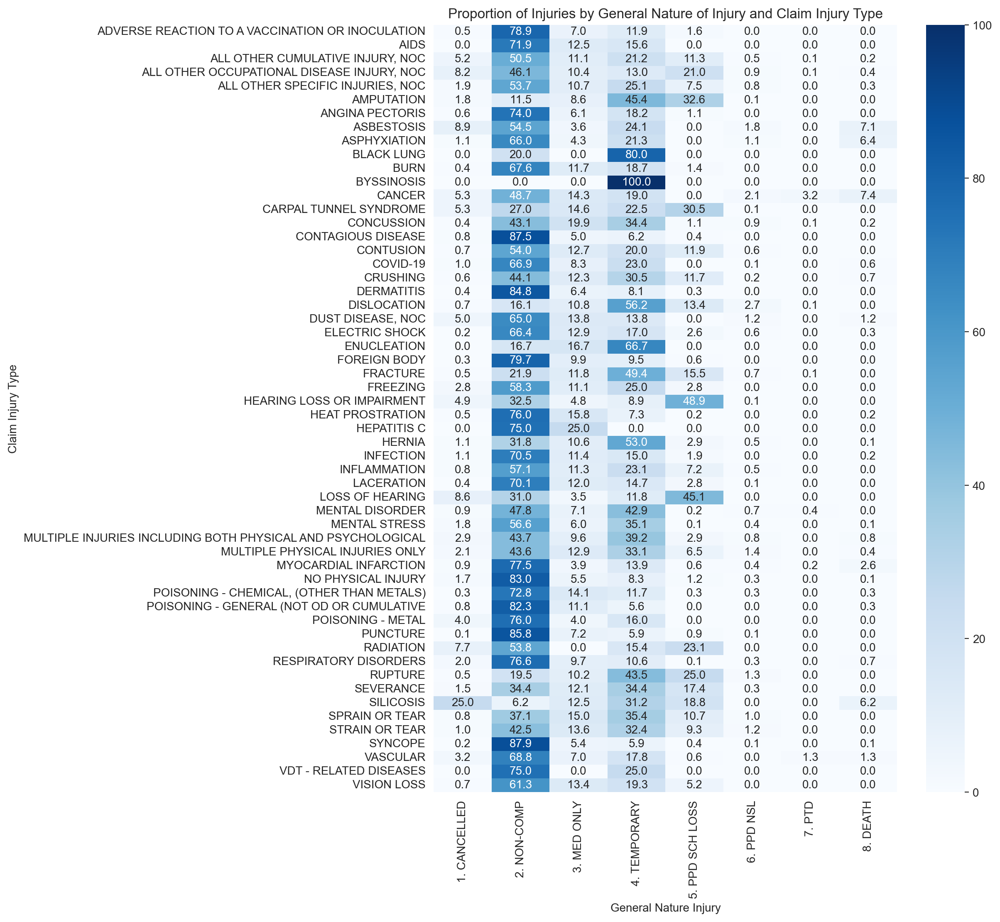

In [181]:
# Create a crosstab for 'Claim Injury Type' and 'general_nature_injury'
all_nature_by_injury_type_proportion = pd.crosstab(df_wcio_grouped['Claim Injury Type'], df_wcio_grouped['WCIO Nature of Injury Description'], normalize='columns') * 100

# Transpose the crosstab to have 'Nature of Injury' on the X-axis
all_nature_by_injury_type_proportion = all_nature_by_injury_type_proportion.T

# Plot the heatmap
plt.figure(figsize=(9, 12))
sns.heatmap(all_nature_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f')
plt.xlabel('General Nature Injury')
plt.ylabel('Claim Injury Type')
plt.title('Proportion of Injuries by General Nature of Injury and Claim Injury Type')
plt.show()

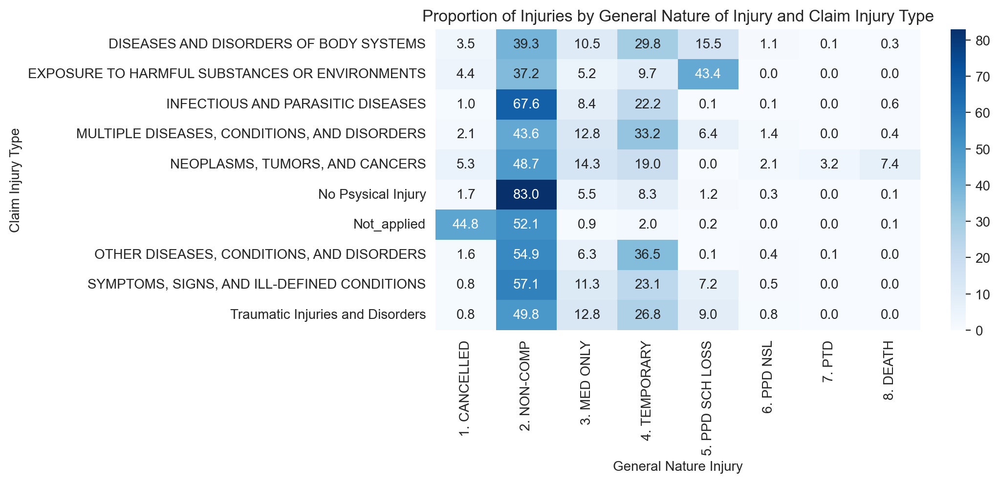

In [182]:
# Create a crosstab for 'Claim Injury Type' and 'general_nature_injury'
nature_by_injury_type_proportion = pd.crosstab(df_wcio_grouped['Claim Injury Type'], df_wcio_grouped['general_nature_injury'], normalize='columns') * 100

# Transpose the crosstab to have 'Nature of Injury' on the X-axis
nature_by_injury_type_proportion = nature_by_injury_type_proportion.T

# Plot the heatmap
plt.figure(figsize=(8, 4))
sns.heatmap(nature_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f')
plt.xlabel('General Nature Injury')
plt.ylabel('Claim Injury Type')
plt.title('Proportion of Injuries by General Nature of Injury and Claim Injury Type')
plt.show()


<a class="anchor" id="3rd-bullet">

## Covid-19
    
</a>


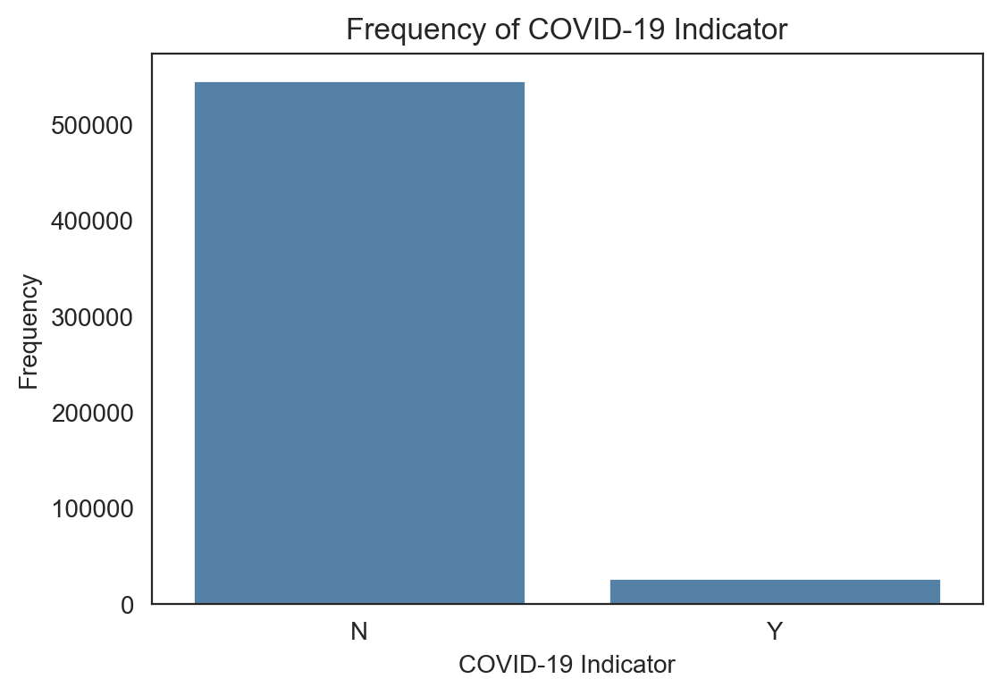

In [183]:
freq_covid = df_dates["COVID-19 Indicator"].value_counts().index
plt.figure(figsize=(6, 4))
sns.countplot(data=df_dates, x='COVID-19 Indicator', order=freq_covid, color='#4782B4')
plt.title('Frequency of COVID-19 Indicator')
plt.xlabel('COVID-19 Indicator')
plt.ylabel('Frequency')
plt.show()


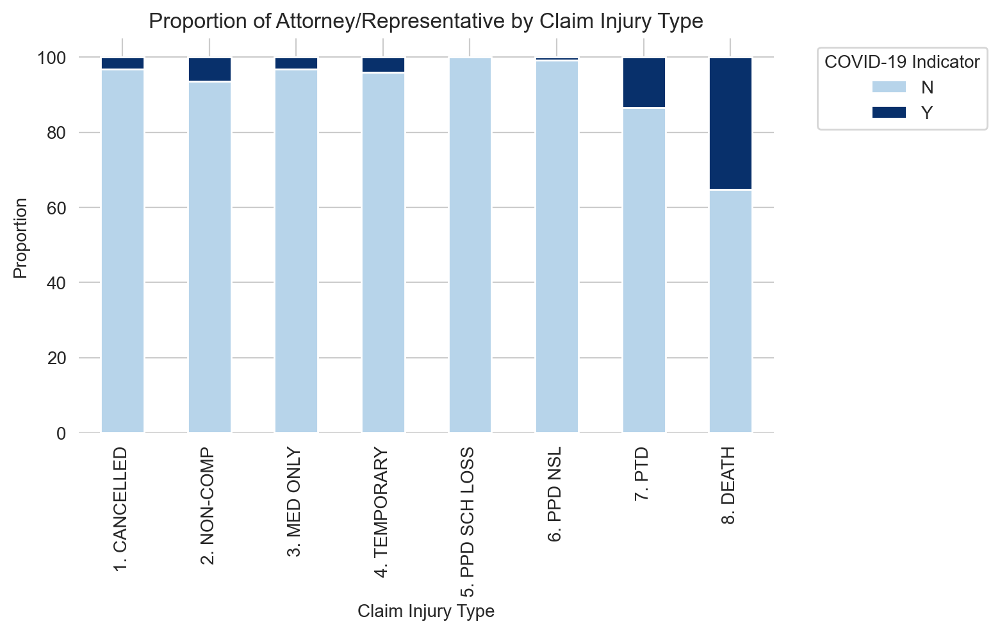

In [184]:
covid_by_injury_proportion = pd.crosstab(df_train['Claim Injury Type'], df_train['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(7, 4))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

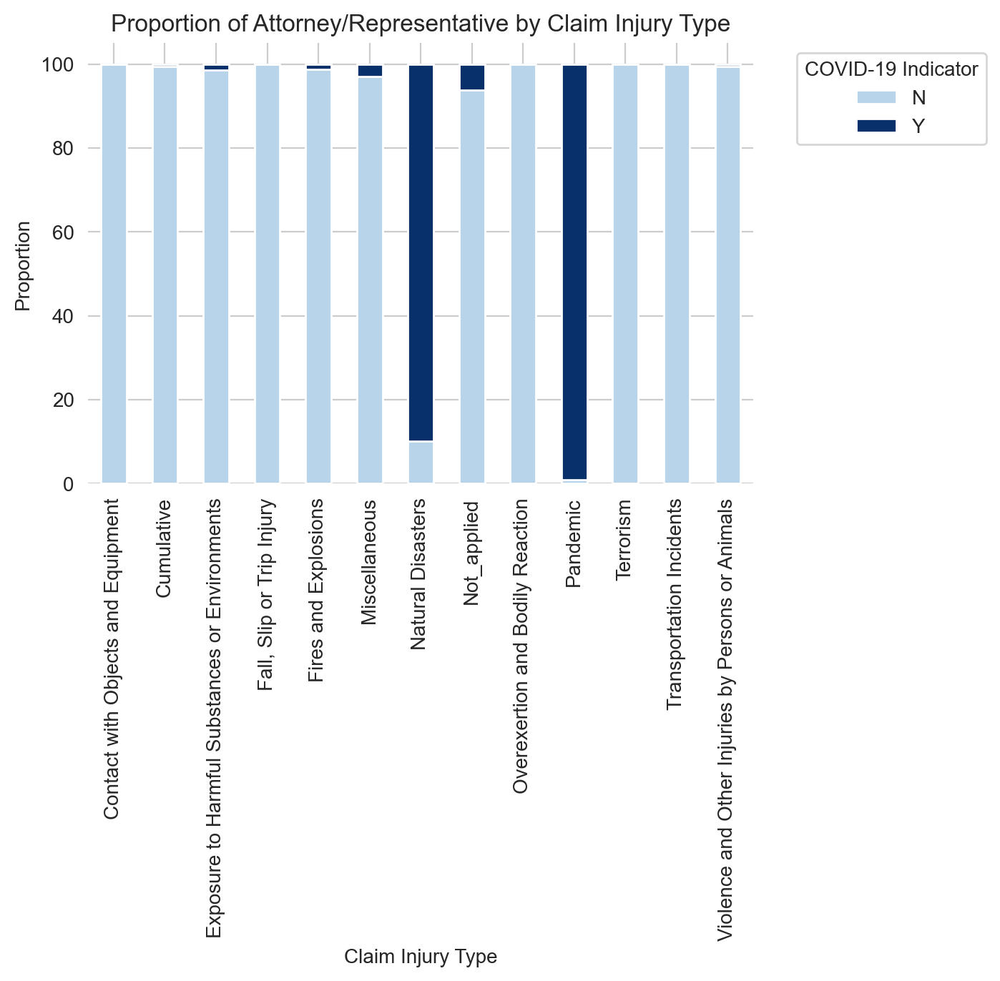

In [185]:
# Calculate the proportion
covid_by_injury_proportion = pd.crosstab(df_wcio_grouped['general_cause_injury'], df_wcio_grouped['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(6, 4))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

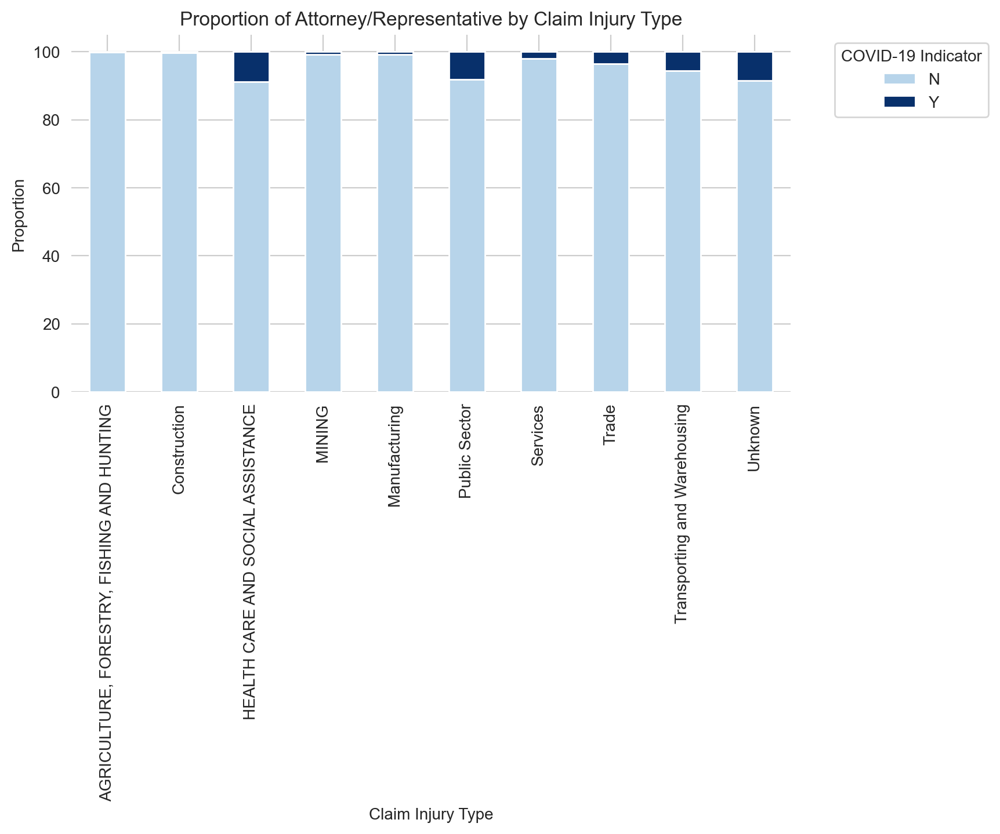

In [186]:
# Calculate the proportion
covid_by_injury_proportion = pd.crosstab(df_wcio_grouped['general_industry_description'], df_wcio_grouped['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(8, 4))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

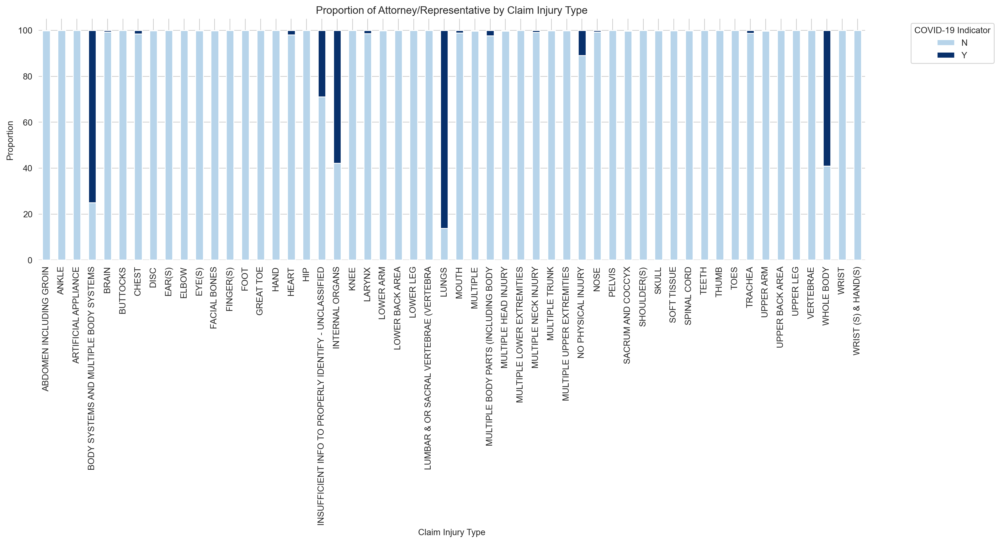

In [187]:
# Calculate the proportion
covid_by_injury_proportion = pd.crosstab(df_wcio_grouped['WCIO Part Of Body Description'], df_wcio_grouped['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(17, 5))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

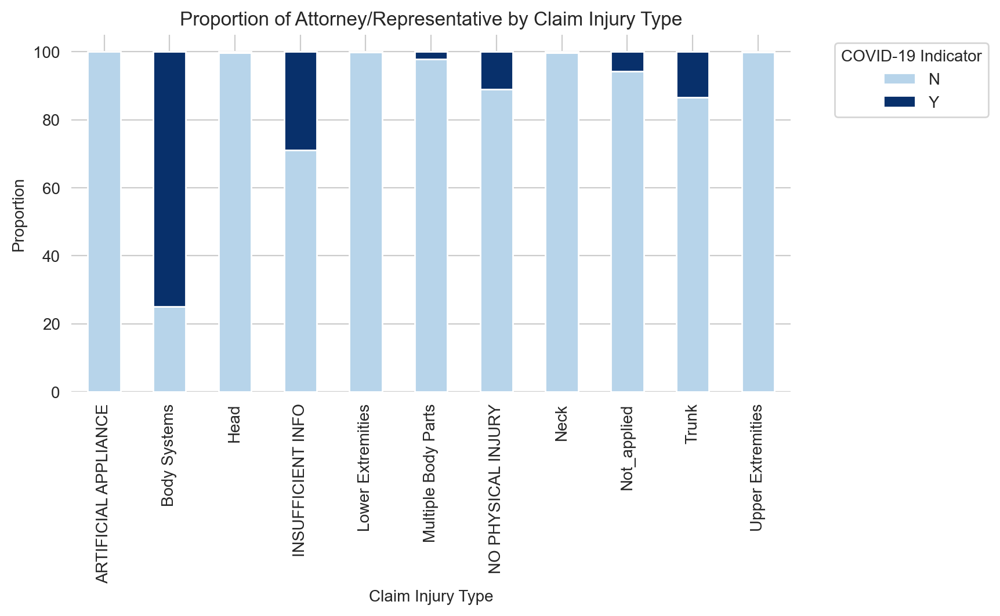

In [188]:
# Calculate the proportion
covid_by_injury_proportion = pd.crosstab(df_wcio_grouped['general_body_part'], df_wcio_grouped['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(8, 4))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

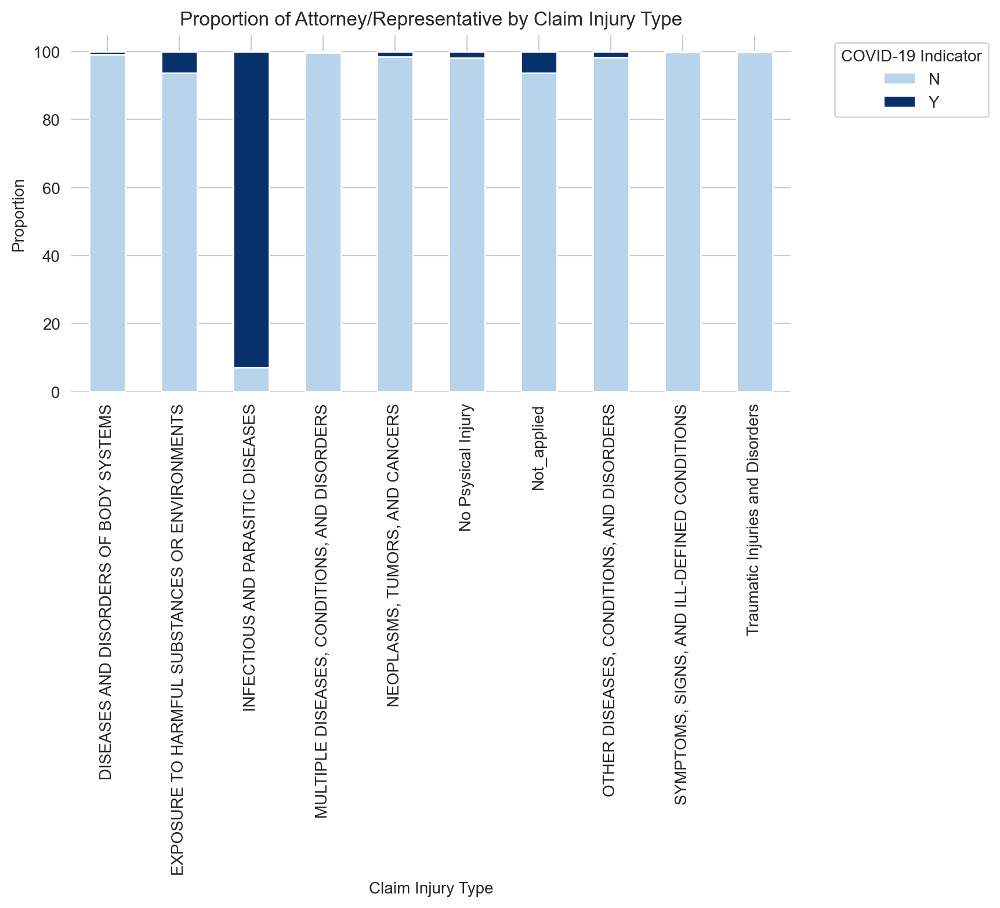

In [189]:
# Calculate the proportion
covid_by_injury_proportion = pd.crosstab(df_wcio_grouped['general_nature_injury'], df_wcio_grouped['COVID-19 Indicator'], normalize='index') * 100

fig, ax = plt.subplots(figsize=(8, 4))  # Increased figure size

covid_by_injury_proportion.plot(kind='bar', stacked=True, colormap=truncated_blues, ax = ax)
plt.xlabel('Claim Injury Type')
plt.ylabel('Proportion')
plt.title('Proportion of Attorney/Representative by Claim Injury Type')
plt.legend(title='COVID-19 Indicator', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.show()

<a class="anchor" id="3rd-bullet">

## Number of Dependents
    
</a>

In [190]:
df_wcio_grouped["Number of Dependents"].value_counts()

Number of Dependents
6    82653
3    82299
5    82075
4    81904
1    81823
0    81665
2    81607
Name: count, dtype: Int64

In [191]:
df_wcio_grouped['dependents_binary'] = df_wcio_grouped['Number of Dependents'].apply(lambda x: 1 if x > 0 else 0)

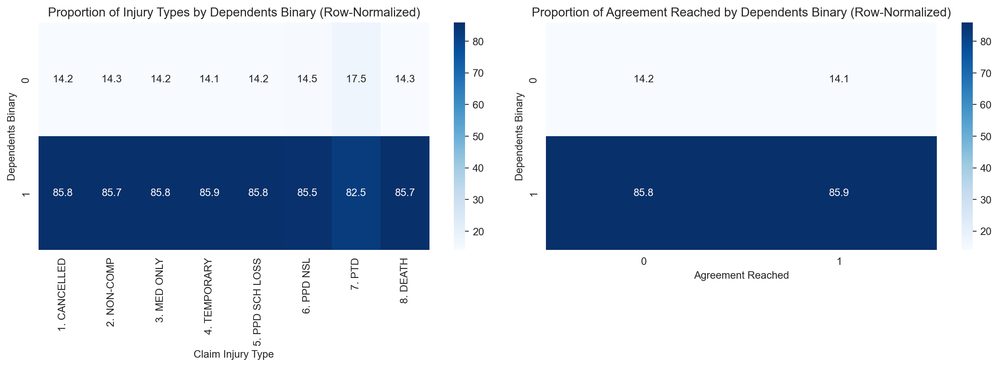

In [192]:
# Create the first crosstab for proportions of "Claim Injury Type" by "dependents_binary"
dependents_binary_by_injury_type_proportion = pd.crosstab(
    df_wcio_grouped['dependents_binary'], 
    df_wcio_grouped['Claim Injury Type'], 
    normalize='columns') * 100  # Normalize by rows so each cause sums to 1

# Create the second crosstab for proportions of "Agreement Reached" by "dependents_binary"
dependents_binary_by_agreement_proportion = pd.crosstab(
    df_wcio_grouped['dependents_binary'], 
    df_wcio_grouped['Agreement Reached'], 
    normalize='columns') * 100  # Normalize by rows so each cause sums to 1

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.heatmap(dependents_binary_by_injury_type_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Dependents Binary')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Injury Types by Dependents Binary (Row-Normalized)')

sns.heatmap(dependents_binary_by_agreement_proportion, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('Dependents Binary')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached by Dependents Binary (Row-Normalized)')

plt.tight_layout()
plt.show()


<a class="anchor" id="3rd-bullet">

## Zip Code and County of Injury Categorization
    
</a>

Based on NYS Counties, we mapped the ZIP Codes to deal with the High Cardinality, reducing substantially the number of unique labels to 62.

In [193]:
zip_match = pd.read_csv("Zip_Codes.csv", delimiter=';')
zip_match.head(3)

,Zip Code,County
0,ZIP Code 00501,Suffolk
1,ZIP Code 00544,Suffolk
2,ZIP Code 06390,Suffolk


In [194]:
# Create a new column with only the numeric part of the Zip Code
zip_match['Zip Code Numbers'] = zip_match['Zip Code'].str.replace(r'\D', '', regex=True)
zip_match.head(2)

,Zip Code,County,Zip Code Numbers
0,ZIP Code 00501,Suffolk,00501
1,ZIP Code 00544,Suffolk,00544


In [195]:
zip_match['Zip Code Numbers'].dtype

dtype('O')

In [196]:
df_wcio_grouped["Zip Code"].dtype

dtype('O')

In [197]:
# Merge df_wcio_grouped with zip_match on the Zip Code columns

df_wcio_grouped = df_wcio_grouped.reset_index()

df_wcio_grouped = df_wcio_grouped.merge(zip_match[['Zip Code Numbers', 'County']], 
                                        left_on='Zip Code', 
                                        right_on='Zip Code Numbers', 
                                        how='left').reset_index()

df_wcio_grouped = df_wcio_grouped.set_index('Claim Identifier')
df_wcio_grouped.drop(columns=["index"], inplace=True)
df_wcio_grouped.head(2)


,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents,general_body_part_code,general_body_part,general_cause_injury_code,general_cause_injury,general_industry_code,general_industry_description,general_nature_injury_code,general_nature_injury,dependents_binary,Zip Code Numbers,County
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5393875,2019-12-30,31,N,2020-01-01,N,0.00,1988,2019-12-31,NaT,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,2. NON-COMP,ST. LAWRENCE,N,SYRACUSE,NaT,M,NaN,44,RETAIL TRADE,I,27,FROM LIQUID OR GREASE SPILLS,10,CONTUSION,62,BUTTOCKS,13662,0,1,4,Trunk,3,"Fall, Slip or Trip Injury",4,Trade,2,Traumatic Injuries and Disorders,1,13662,Saint Lawrence
5393091,2019-08-30,46,N,2020-01-01,Y,1745.93,1973,2020-01-01,2020-01-14,ZURICH AMERICAN INSURANCE CO,1A. PRIVATE,4. TEMPORARY,WYOMING,N,ROCHESTER,2020-02-21,F,4.0,23,CONSTRUCTION,I,97,REPETITIVE MOTION,49,SPRAIN OR TEAR,38,SHOULDER(S),14569,1,4,3,Upper Extremities,6,Overexertion and Bodily Reaction,2,Construction,2,Traumatic Injuries and Disorders,1,14569,Wyoming


In [198]:
# Replace missing values in 'County' with 'Unknown', but keep initial NaNs
df_wcio_grouped['Home_county'] = df_wcio_grouped.apply(
    lambda row: 'Unknown' if pd.isna(row['County']) and not pd.isna(row['Zip Code']) else row['County'], axis=1)

In [199]:
df_wcio_grouped[["Zip Code", "County of Injury", 'Zip Code Numbers', 'Home_county']].head(2)

,Zip Code,County of Injury,Zip Code Numbers,Home_county
Claim Identifier,,,,
5393875,13662,ST. LAWRENCE,13662,Saint Lawrence
5393091,14569,WYOMING,14569,Wyoming


In [200]:
df_wcio_grouped.drop(columns=['Zip Code','Zip Code Numbers', 'County'], inplace=True)

In [201]:
df_wcio_grouped['Home_county'].unique()

array(['Saint Lawrence', 'Wyoming', 'Ulster', 'Dutchess', 'Suffolk',
       'Onondaga', 'Richmond', 'Monroe', 'Kings', 'Orange', 'Unknown',
       'Queens', 'Westchester', 'Nassau', 'Albany', 'Erie', 'Bronx',
       'Otsego', 'Cayuga', 'Niagara', 'Livingston', 'Washington',
       'Madison', 'Warren', 'New York', 'Schenectady', 'Seneca', nan,
       'Saratoga', 'Chautauqua', 'Columbia', 'Rensselaer', 'Putnam',
       'Cattaraugus', 'Rockland', 'Schuyler', 'Broome', 'Clinton',
       'Oneida', 'Steuben', 'Montgomery', 'Ontario', 'Sullivan',
       'Chemung', 'Yates', 'Allegany', 'Tioga', 'Genesee', 'Wayne',
       'Herkimer', 'Greene', 'Delaware', 'Tompkins', 'Oswego', 'Lewis',
       'Essex', 'Chenango', 'Franklin', 'Orleans', 'Jefferson', 'Fulton',
       'Cortland', 'Schoharie', 'Hamilton'], dtype=object)

In [202]:
# Replace missing values in 'Home_county' with 'Unknown'
df_wcio_grouped['Home_county'] = df_wcio_grouped['Home_county'].fillna('Unknown')
print(df_wcio_grouped['Home_county'].isna().sum())  # Should print 0 if all missing values are replaced

0


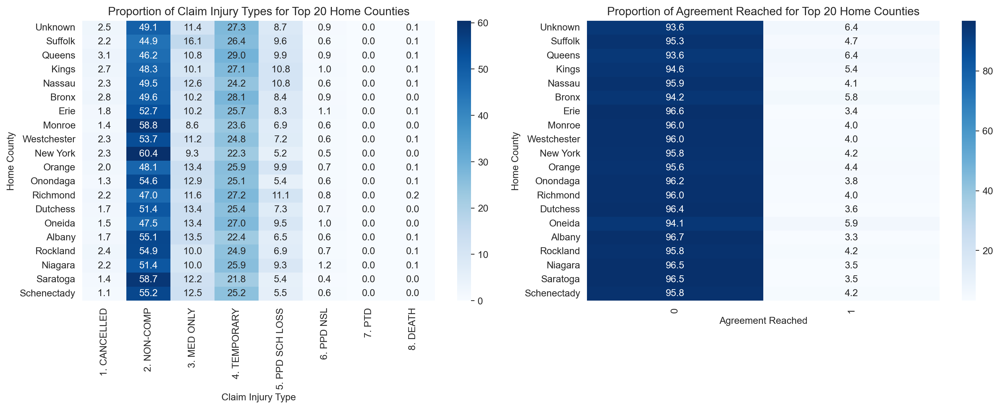

In [203]:
# Identify the top 20 home counties
top_20_counties_home = df_wcio_grouped['Home_county'].value_counts().index[:20]

# Calculate the crosstab for proportions of injuries by claim type
claim_injury_county_crosstab = pd.crosstab(df_wcio_grouped['Home_county'], df_wcio_grouped['Claim Injury Type'], normalize='index') * 100

# Filter the crosstab for the top 20 home counties
top_20_crosstab_injury = claim_injury_county_crosstab.loc[top_20_counties_home]

# Calculate the crosstab for proportions of injuries by agreement reached
agreement_county_crosstab = pd.crosstab(df_wcio_grouped['Home_county'], df_wcio_grouped['Agreement Reached'], normalize='index') * 100

# Filter the crosstab for the top 20 home counties
top_20_crosstab_agreement = agreement_county_crosstab.loc[top_20_counties_home]

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

sns.heatmap(top_20_crosstab_injury, cmap='Blues', annot=True, fmt='.1f', ax=axes[0])
axes[0].set_ylabel('Home County')
axes[0].set_xlabel('Claim Injury Type')
axes[0].set_title('Proportion of Claim Injury Types for Top 20 Home Counties')
axes[0].tick_params(axis='x', rotation=90)

sns.heatmap(top_20_crosstab_agreement, cmap='Blues', annot=True, fmt='.1f', ax=axes[1])
axes[1].set_ylabel('Home County')
axes[1].set_xlabel('Agreement Reached')
axes[1].set_title('Proportion of Agreement Reached for Top 20 Home Counties')
axes[1].tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()

<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 5. Data Cleaning
    

    
</div>

<a class="anchor" id="3rd-bullet">

## Initial settings
    
</a>

In [204]:
df_toclean = df_train.copy() # make copy of original

In [205]:
df_toclean.head(3)

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Injury Type,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Agreement Reached,Number of Dependents
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5393875,2019-12-30,31,N,2020-01-01,N,0.00,1988,2019-12-31,NaT,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,2. NON-COMP,ST. LAWRENCE,N,SYRACUSE,NaT,M,NaN,44,RETAIL TRADE,I,27,FROM LIQUID OR GREASE SPILLS,10,CONTUSION,62,BUTTOCKS,13662,0,1
5393091,2019-08-30,46,N,2020-01-01,Y,1745.93,1973,2020-01-01,2020-01-14,ZURICH AMERICAN INSURANCE CO,1A. PRIVATE,4. TEMPORARY,WYOMING,N,ROCHESTER,2020-02-21,F,4.0,23,CONSTRUCTION,I,97,REPETITIVE MOTION,49,SPRAIN OR TEAR,38,SHOULDER(S),14569,1,4
5393889,2019-12-06,40,N,2020-01-01,N,1434.80,1979,2020-01-01,NaT,INDEMNITY INSURANCE CO OF,1A. PRIVATE,4. TEMPORARY,ORANGE,N,ALBANY,NaT,M,NaN,56,ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMEN...,II,79,OBJECT BEING LIFTED OR HANDLED,7,CONCUSSION,10,MULTIPLE HEAD INJURY,12589,0,6


In [206]:
df_toclean["Agreement Reached"].dtype

Int64Dtype()

Drop Both Target variables and maintain for now only binary one in order to predict it.

In [207]:
# Split the data into features and target
X = df_toclean.drop(columns=['Agreement Reached', 'Claim Injury Type'], axis=1) 
y = df_toclean['Agreement Reached'].astype(int) # Turn the target variable into numeric

In [208]:
y.value_counts()

Agreement Reached
0    547239
1     26787
Name: count, dtype: int64

Split the the dataset into train (75%) and validation (25%)

In [209]:
X_train, X_val, y_train_binary, y_val_binary = train_test_split(X,y, test_size = 0.25, 
                                                  random_state = 42, 
                                                  stratify = y,       # stratify to keep the same proportion of classes in the train and validation sets
                                                  shuffle = True)

Prepare the test dataset at the same time

In [210]:
## split the test dataset into X_test and y_test which y_test is the columns who needs to be created as empty
X_test = pd.read_csv('test_data.csv')
y_test_binary = pd.DataFrame(columns = ['Agreement Reached'])

In [211]:
# set the claim identifier as index in the test dataset
X_test.set_index('Claim Identifier', inplace=True)

Drop irrelevant columns and change datatypes in the test dataset

In [212]:
columns_to_drop =["OIICS Nature of Injury Description"]
for c in columns_to_drop:
    X_test = X_test.drop([c], axis=1)

# Changing the data type of the columns : "Accident Date", "Assembly Date", "C-2 Date" to datetime
columns_to_date_time=["Accident Date", "Assembly Date", "C-2 Date", "C-3 Date", "First Hearing Date"]
for i in columns_to_date_time:
    X_test[i] = pd.to_datetime(X_test[i], errors='coerce') #coerce will force an out-of-bounds date to NaT, in case of any error 

# Changing the data type of the columns : "Age at Injury", "Birth Year", "Industry Code", "WCIO Cause of Injury Code", "WCIO Nature of Injury Code", "Number of Dependents" to numeric
lista=["Age at Injury", "Birth Year", "Number of Dependents", "WCIO Part Of Body Code", "WCIO Nature of Injury Code", "WCIO Cause of Injury Code", "Industry Code"]
for i in lista:
    X_test[i] = pd.to_numeric(X_test[i], errors='coerce').astype('Int64')

<a class="anchor" id="3rd-bullet">

## Missing Values
    
</a>

### Birth Year

In [213]:
len(X_train[X_train['Age at Injury'] == 0])

4137

In [214]:
## when 'Age at Injury' is 0 and 'Birth Year' is also 0 we replace 0 with NaN in Age at Injury
X_train.loc[(X_train['Age at Injury'] == 0) & (X_train['Birth Year'] == 0), 'Age at Injury'] = np.nan
X_val.loc[(X_val['Age at Injury'] == 0) & (X_val['Birth Year'] == 0), 'Age at Injury'] = np.nan
X_test.loc[(X_test['Age at Injury'] == 0) & (X_test['Birth Year'] == 0), 'Age at Injury'] = np.nan

## when 'Age at Injury' is 0 but 'Birth Year' is not 0 we calculate the age based on the 'Birth Year'
X_train.loc[(X_train['Age at Injury'] == 0) & (X_train['Birth Year'] != 0), 'Age at Injury'] = X_train['Accident Date'].dt.year - X_train['Birth Year']
X_val.loc[(X_val['Age at Injury'] == 0) & (X_val['Birth Year'] != 0), 'Age at Injury'] = X_val['Accident Date'].dt.year - X_val['Birth Year']
X_test.loc[(X_test['Age at Injury'] == 0) & (X_test['Birth Year'] != 0), 'Age at Injury'] = X_test['Accident Date'].dt.year - X_test['Birth Year']

In [215]:
# Replace Age at Injury with the median if Age at Injury is Nan
median_age = X_train['Age at Injury'].median()
X_train.loc[X_train['Age at Injury'].isna(), 'Age at Injury'] = median_age
X_val.loc[X_val['Age at Injury'].isna(), 'Age at Injury'] = median_age
X_test.loc[X_test['Age at Injury'].isna(), 'Age at Injury'] = median_age

# Replace Age at Injury with the median if Age at Injury is 0 and Birth Year is Nan
X_train.loc[(X_train['Age at Injury'] == 0) & (X_train['Birth Year'].isna()), 'Age at Injury'] = median_age
X_val.loc[(X_val['Age at Injury'] == 0) & (X_val['Birth Year'].isna()), 'Age at Injury'] = median_age
X_test.loc[(X_test['Age at Injury'] == 0) & (X_test['Birth Year'].isna()), 'Age at Injury'] = median_age

#drop the birth year column because we already have the age at injury column - we can calculate the birth year from the age at injury
X_train.drop(columns=['Birth Year'], inplace=True)
X_val.drop(columns=['Birth Year'], inplace=True)
X_test.drop(columns=['Birth Year'], inplace=True)

Define a function to categorize to reduce the distribution of age and keep both features to further choose the best performer in feature selection.


In [216]:
def categorize_age_group(x):
    if 1 <= x <= 15: # to work after replace the zero ages with the median (the ones we don´t have birth year)
        return 0
    elif 16 <= x <= 35:
        return 1
    elif 36 <= x <= 57:
        return 2
    elif 58 <= x <= 76:
        return 3
    else:
        return 4

X_train['Age_Category'] = X_train['Age at Injury'].apply(categorize_age_group)
X_val['Age_Category'] = X_val['Age at Injury'].apply(categorize_age_group)
X_test['Age_Category'] = X_test['Age at Injury'].apply(categorize_age_group)

On original "Age at Injury" will try to deal with outliers after seen on EDA that people above 90 doesn´t really behave in a special way...

In [217]:
# Calculate Q1 and Q3 for 'Age at Injury' where values are greater than 0
q1 = X_train['Age at Injury'].quantile(0.25)
q3 = X_train['Age at Injury'].quantile(0.75)

print("Q1 (25th percentile):", q1)
print("Q3 (75th percentile):", q3)

# Calculate IQR and upper bound
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr
print("Upper bound:", upper_bound)

# Cap values above the upper bound in 'Age at Injury'
X_train['Age at Injury'] = X_train['Age at Injury'].apply(lambda x: min(x, upper_bound))
X_val['Age at Injury'] = X_val['Age at Injury'].apply(lambda x: min(x, upper_bound))
X_test['Age at Injury'] = X_test['Age at Injury'].apply(lambda x: min(x, upper_bound))

# Verify maximum value in capped 'Age at Injury' in training set
print("Max value in 'Age at Injury' after capping:", X_train['Age at Injury'].max())

Q1 (25th percentile): 31.0
Q3 (75th percentile): 54.0
Upper bound: 88.5
Max value in 'Age at Injury' after capping: 88.5


In [218]:
X_train['Age_Category'].value_counts()

Age_Category
2    207936
1    152468
3     68409
4      1529
0       177
Name: count, dtype: int64

<a class="anchor" id="3rd-bullet">

## Dates
    
</a>

### C-2, C-3, Hearing and Accident Dates - Creat Binary columns

In [219]:
X_train['Hearing_Held'] = X_train['First Hearing Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_val['Hearing_Held'] = X_val['First Hearing Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_test['Hearing_Held'] = X_test['First Hearing Date'].apply(lambda x: 1 if pd.notnull(x) else 0)

X_train['C3_Received'] = X_train['C-3 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_val['C3_Received'] = X_val['C-3 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_test['C3_Received'] = X_test['C-3 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)

X_train['C2_Received'] = X_train['C-2 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_val['C2_Received'] = X_val['C-2 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_test['C2_Received'] = X_test['C-2 Date'].apply(lambda x: 1 if pd.notnull(x) else 0)

X_train['Accident_date_present'] = X_train['Accident Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_val['Accident_date_present'] = X_val['Accident Date'].apply(lambda x: 1 if pd.notnull(x) else 0)
X_test['Accident_date_present'] = X_test['Accident Date'].apply(lambda x: 1 if pd.notnull(x) else 0)

X_train.drop(columns=["First Hearing Date"], inplace=True)
X_val.drop(columns=["First Hearing Date"], inplace=True)
X_test.drop(columns=["First Hearing Date"], inplace=True)

### Getting months and years from accident and year from assembly dates

Regarding year from assembly and accident dates, be careful for data leakage due to not having 2024 in train data:

In [220]:
# Calculate the mode for the day of week, month and year
mode_month = X_train['Accident Date'].dt.month.mode()[0]
mode_year = X_train['Accident Date'].dt.year.mode()[0]
mode_DOW = X_train['Accident Date'].dt.dayofweek.mode()[0]
mode_day = X_train['Accident Date'].dt.day.mode()[0]

# Extract the month from 'Accident Date' and fill missing values with the mode month
X_train['Accident_Month'] = X_train['Accident Date'].dt.month.fillna(mode_month).astype(int)
X_val['Accident_Month'] = X_val['Accident Date'].dt.month.fillna(mode_month).astype(int)
X_test['Accident_Month'] = X_test['Accident Date'].dt.month.fillna(mode_month).astype(int)

# Extract the year from 'Accident Date' and fill missing values with the mode year
X_train['Accident_Year'] = X_train['Accident Date'].dt.year.fillna(mode_year).astype(int)
X_val['Accident_Year'] = X_val['Accident Date'].dt.year.fillna(mode_year).astype(int)
X_test['Accident_Year'] = X_test['Accident Date'].dt.year.fillna(mode_year).astype(int)

X_train['Accident_DOW'] = X_train['Accident Date'].dt.dayofweek.fillna(mode_DOW).astype(int)
X_val['Accident_DOW'] = X_val['Accident Date'].dt.dayofweek.fillna(mode_DOW).astype(int)
X_test['Accident_DOW'] = X_test['Accident Date'].dt.dayofweek.fillna(mode_DOW).astype(int)

X_train['Accident_Day'] = X_train['Accident Date'].dt.day.fillna(mode_day).astype(int)
X_val['Accident_Day'] = X_val['Accident Date'].dt.day.fillna(mode_day).astype(int)
X_test['Accident_Day'] = X_test['Accident Date'].dt.day.fillna(mode_day).astype(int)

# Extract year for 'Assembly Date' as it may be important regarding new policies
X_train['Assembly_year'] = X_train['Assembly Date'].dt.year.astype(int)
X_val['Assembly_year'] = X_val['Assembly Date'].dt.year.astype(int)
X_test['Assembly_year'] = X_test['Assembly Date'].dt.year.astype(int)

# Display value counts for 'Accident_Month' in the training set
print(X_train['Accident_DOW'].value_counts())

Accident_DOW
1    77863
2    74616
0    72585
3    72567
4    66885
5    35177
6    30826
Name: count, dtype: int64


### Relation between Accident Date and Assembly Delay

In [221]:
# Calculate quartiles for categorization

X_train['assembly_delay'] = (X_train['Assembly Date'] - X_train['Accident Date']).dt.days

print(X_train[X_train['assembly_delay'] > 0]['assembly_delay'].quantile(0.25))
print(X_train[X_train['assembly_delay'] > 0]['assembly_delay'].median())
print(X_train[X_train['assembly_delay'] > 0]['assembly_delay'].quantile(0.75))

5.0
10.0
25.0


In [222]:
# Calculate the difference between Assembly Date and Accident Date
X_train['assembly_delay'] = (X_train['Assembly Date'] - X_train['Accident Date']).dt.days
X_val['assembly_delay'] = (X_val['Assembly Date'] - X_val['Accident Date']).dt.days
X_test['assembly_delay'] = (X_test['Assembly Date'] - X_test['Accident Date']).dt.days

# Handle negative values
X_train.loc[pd.isnull(X_train['assembly_delay']), 'assembly_delay'] = -999 # placeholder
X_val.loc[pd.isnull(X_val['assembly_delay']), 'assembly_delay'] = -999 # placeholder
X_test.loc[pd.isnull(X_test['assembly_delay']), 'assembly_delay'] = -999 # placeholder

# Calculate quartiles for categorization
q1 = X_train[X_train['assembly_delay'] > 0]['assembly_delay'].quantile(0.25)
q2 = X_train[X_train['assembly_delay'] > 0]['assembly_delay'].median()
q3 = X_train[X_train['assembly_delay'] > 0]['assembly_delay'].quantile(0.75)

# Function to categorize assembly_delay using quartiles
def categorize_assembly_delay(delay):
    if delay == -999:
        return 'No_accident_date'
    elif delay < 0:
        return 'Cumulative'
    elif 0 <= delay <= q1:
        return 'Short_Delay'
    elif q1 < delay <= q3:
        return 'Median_Delay'
    else:
        return 'Long_Delay'

# Apply the function to the dataset
X_train['assembly_delay_category'] = X_train['assembly_delay'].apply(categorize_assembly_delay)
X_val['assembly_delay_category'] = X_val['assembly_delay'].apply(categorize_assembly_delay)
X_test['assembly_delay_category'] = X_test['assembly_delay'].apply(categorize_assembly_delay)

In [223]:
X_train['assembly_delay_category'].value_counts()

assembly_delay_category
Median_Delay        202769
Short_Delay         120002
Long_Delay          103881
No_accident_date      2794
Cumulative            1073
Name: count, dtype: int64

second way to define this - assume negative values as absolute: we will maintain both features to choose the best.

In [224]:
# we deal with the inconsistencie of negative values (assembly before accident) by making it Absolute value.

X_train['assembly_delay'] = (X_train['Assembly Date'] - X_train['Accident Date']).dt.days.astype('Int64').abs() # delay between Accident Date and Assembly Date
X_val['assembly_delay'] = (X_val['Assembly Date'] - X_val['Accident Date']).dt.days.astype('Int64').abs()
X_test['assembly_delay'] = (X_test['Assembly Date'] - X_test['Accident Date']).dt.days.astype('Int64').abs()

median_assembly_delay = X_train['assembly_delay'].median()
X_train['assembly_delay'] = X_train['assembly_delay'].fillna(median_assembly_delay)
X_val['assembly_delay'] = X_val['assembly_delay'].fillna(median_assembly_delay)
X_test['assembly_delay'] = X_test['assembly_delay'].fillna(median_assembly_delay)

X_train['assembly_delay'].value_counts()
print(X_train['assembly_delay'].isna().sum()) 
print(X_val['assembly_delay'].isna().sum()) 
print(X_test['assembly_delay'].isna().sum())

0
0
0


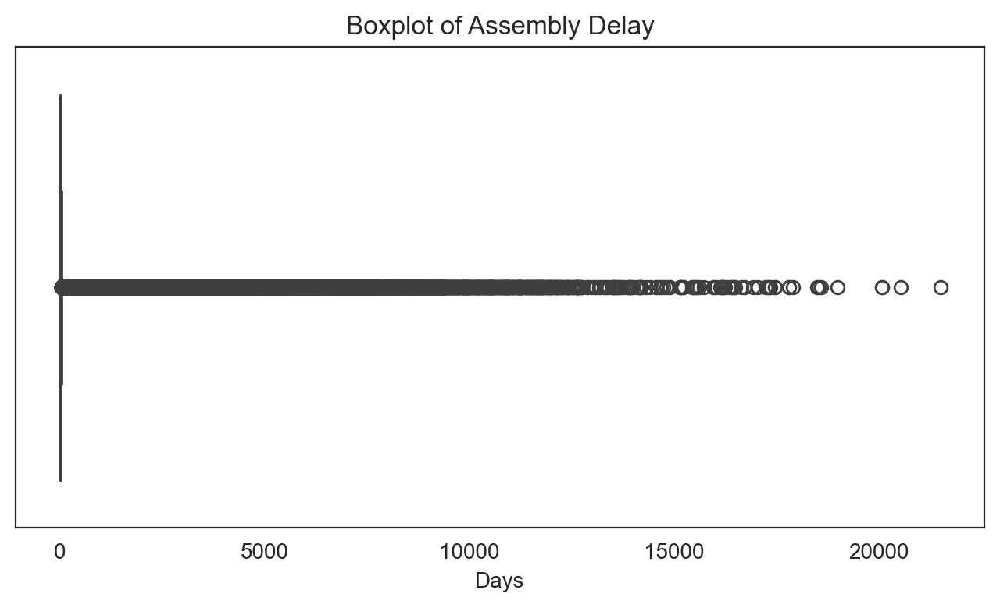

In [225]:
# Create a boxplot for 'assembly_delay'
plt.figure(figsize=(8, 4))
sns.boxplot(x=X_train['assembly_delay'])
plt.title('Boxplot of Assembly Delay')
plt.xlabel('Days')
plt.show()

In [226]:
q1 = X_train['assembly_delay'].quantile(0.25) # 25th percentile or first quartile
q3 = X_train['assembly_delay'].quantile(0.75)  # 75th percentile or third quartile

print(q1)
print(q3)
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr
print(upper_bound)

# Calculate the upper bound (assuming you already have q3 and an interquartile range iqr)

# Cap the values above the upper bound
X_train['assembly_delay'] = X_train['assembly_delay'].apply(lambda x: min(x, upper_bound))
X_val['assembly_delay'] = X_val['assembly_delay'].apply(lambda x: min(x, upper_bound))
X_test['assembly_delay'] = X_test['assembly_delay'].apply(lambda x: min(x, upper_bound))

X_train['assembly_delay'].max()

5.0
24.0
52.5


52.5

### C2_Accident Date:

**The reason we define this in_time category:** 

"The C-2F Form was implemented in New York state in 2013 for employers when reporting an employee injury or illness. The form, titled “Employer’s First Report of Work-Related Injury/Illness,” must be filed with the Board within 10 days of the injury or illness. If the employer misses the deadline, he or she will be subject to a financial penalty."

In [227]:
X_train['c2_to_accident_delay'] = (X_train['C-2 Date'] - X_train['Accident Date']).dt.days
X_val['c2_to_accident_delay'] = (X_val['C-2 Date'] - X_val['Accident Date']).dt.days
X_test['c2_to_accident_delay'] = (X_test['C-2 Date'] - X_test['Accident Date']).dt.days

# Function to categorize c2_to_accident_delay using quartiles
def categorize_c2_to_accident_delay(delay):
    if pd.isnull(delay):
        return 'Undetermined'
    elif delay < 0:
        return "C2_First"
    elif 0 <= delay <= 10:
        return 'In_time'
    else:
        return 'Over_time'

# Apply the function to categorize the delay
X_train['c2_to_accident_delay_category'] = X_train['c2_to_accident_delay'].apply(categorize_c2_to_accident_delay)
X_val['c2_to_accident_delay_category'] = X_val['c2_to_accident_delay'].apply(categorize_c2_to_accident_delay)
X_test['c2_to_accident_delay_category'] = X_test['c2_to_accident_delay'].apply(categorize_c2_to_accident_delay)

Likewise, we also did the other feature where we take the absolute value and fill NAs with median (same as assembly delay) <br>
Keep both features to see the best one.

In [228]:
# Calculate the difference between C-2 Date and Accident Date
X_train['c2_to_accident_delay'] = (X_train['C-2 Date'] - X_train['Accident Date']).dt.days.astype('Int64').abs()
X_val['c2_to_accident_delay'] = (X_val['C-2 Date'] - X_val['Accident Date']).dt.days.astype('Int64').abs()
X_test['c2_to_accident_delay'] = (X_test['C-2 Date'] - X_test['Accident Date']).dt.days.astype('Int64').abs()

# Replace missing values with the median
median_delay = X_train['c2_to_accident_delay'].median()
X_train['c2_to_accident_delay'] = X_train['c2_to_accident_delay'].fillna(median_delay)
X_val['c2_to_accident_delay'] = X_val['c2_to_accident_delay'].fillna(median_delay)
X_test['c2_to_accident_delay'] = X_test['c2_to_accident_delay'].fillna(median_delay)

X_train['c2_to_accident_delay'].value_counts()

c2_to_accident_delay
2        26509
4        26500
3        25885
5        25733
6        25432
         ...  
16401        1
7006         1
3035         1
6118         1
1199         1
Name: count, Length: 3348, dtype: Int64

In [229]:
q1 = X_train['c2_to_accident_delay'].quantile(0.25) # 25th percentile or first quartile
q3 = X_train['c2_to_accident_delay'].quantile(0.75)  # 75th percentile or third quartile

print(q1)
print(q3)
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr
print(upper_bound)

# Calculate the upper bound (assuming you already have q3 and an interquartile range iqr)

# Cap the values above the upper bound
X_train['c2_to_accident_delay'] = X_train['c2_to_accident_delay'].apply(lambda x: min(x, upper_bound))
X_val['c2_to_accident_delay'] = X_val['c2_to_accident_delay'].apply(lambda x: min(x, upper_bound))
X_test['c2_to_accident_delay'] = X_test['c2_to_accident_delay'].apply(lambda x: min(x, upper_bound))

X_train['c2_to_accident_delay'].max()

5.0
26.0
57.5


57.5

### C3- TO ACCIDENT vs Assembly pos vs neg:??

We are assuming that there is no mistake in C3-Form being first then Accident Date - Cumulative injuries and class 4. and 5. have bigger proportion.

Also categories were defined based on this info:

"You must notify your employer within 30 days, but it is best to do so as soon as possible. If 30 days pass and you have not notified your employer, you may lose your rights to workers' compensation benefits. <br>
As soon as possible, you should also file an Employee Claim (Form C-3) with the Board; this is how you notify the Board of your injury. Form C-3 must be filed within two years of the accident or within two years after you knew (or should have known) that you contracted a disease or condition due to the nature of your employment. If you are filing a claim for an occupational disease, see the reporting requirements for an occupational disease."

https://www.wcb.ny.gov/content/main/Workers/file-claim.jsp

In [230]:
# Calculate the difference between C-3 Date and Accident Date
X_train['c3_to_accident_delay'] = (X_train['C-3 Date'] - X_train['Accident Date']).dt.days
X_val['c3_to_accident_delay'] = (X_val['C-3 Date'] - X_val['Accident Date']).dt.days
X_test['c3_to_accident_delay'] = (X_test['C-3 Date'] - X_test['Accident Date']).dt.days

# Handle missing values in C-3 Date using the C3_date_present column
X_train.loc[(X_train['C3_Received'] == 1) & (X_train['Accident_date_present'] == 0), 'c3_to_accident_delay'] = -10000
X_val.loc[(X_val['C3_Received'] == 1) & (X_val['Accident_date_present'] == 0), 'c3_to_accident_delay'] = -10000
X_test.loc[(X_test['C3_Received'] == 1) & (X_test['Accident_date_present'] == 0), 'c3_to_accident_delay'] = -10000

# Handle missing values in Accident Date using the Accident_date_present column
X_train.loc[(X_train['C3_Received'] == 0) & (X_train['Accident_date_present'] == 1), 'c3_to_accident_delay'] = -9999
X_val.loc[(X_val['C3_Received'] == 0) & (X_val['Accident_date_present'] == 1), 'c3_to_accident_delay'] = -9999
X_test.loc[(X_test['C3_Received'] == 0) & (X_test['Accident_date_present'] == 1), 'c3_to_accident_delay'] = -9999

# Function to categorize c3_to_accident_delay using quartiles
def categorize_c3_to_accident_delay(delay):
    if delay == -10000:
        return 'No_accident_date'
    elif delay == -9999:
        return "No_C3"
    elif delay < 0:
        return "C3_first"
    elif 0 <= delay <= 30:
        return 'Short_Delay'
    elif 31 <= delay <= 731:  # 2 years time
        return 'Medium_Delay'
    else:
        return 'Overdue'

# Apply the function to categorize the delay
X_train['c3_to_accident_delay_category'] = X_train['c3_to_accident_delay'].apply(categorize_c3_to_accident_delay)
X_val['c3_to_accident_delay_category'] = X_val['c3_to_accident_delay'].apply(categorize_c3_to_accident_delay)
X_test['c3_to_accident_delay_category'] = X_test['c3_to_accident_delay'].apply(categorize_c3_to_accident_delay)


In this case we decided to drop accident delay due high number of missing values for imputation, just kept the Category:

In [231]:
X_train.drop(columns=["c3_to_accident_delay"], inplace=True)
X_val.drop(columns=["c3_to_accident_delay"], inplace=True) 
X_test.drop(columns=["c3_to_accident_delay"], inplace=True)

### 9/11 PERIOD:

We also decide to create a feature for accidents happening in 9/11 period since there are programs for people who suffered any type of injury there (working/volunteer)

https://www.wcb.ny.gov/WTC/wtc-assistance-programs.jsp

In [232]:
# Define the date range as datetime64 objects
start_date = np.datetime64('2001-09-11')
end_date = np.datetime64('2002-09-11')

# Create a binary column based on the condition
X_train['9_11_period'] = X_train.apply(lambda row: 1 if start_date <= row['Accident Date'] <= end_date else 0, axis=1)
X_val['9_11_period'] = X_val.apply(lambda row: 1 if start_date <= row['Accident Date'] <= end_date else 0, axis=1)
X_test['9_11_period'] = X_test.apply(lambda row: 1 if start_date <= row['Accident Date'] <= end_date else 0, axis=1)

X_train['9_11_period'].value_counts()

9_11_period
0    430160
1       359
Name: count, dtype: int64

### Drop original date columns:

In [233]:
X_train.drop(columns=['Accident Date', 'Assembly Date', 'C-3 Date', 'C-2 Date'], inplace=True)
X_val.drop(columns=['Accident Date','Assembly Date', 'C-3 Date', 'C-2 Date'], inplace=True)
X_test.drop(columns=['Accident Date','Assembly Date', 'C-3 Date', 'C-2 Date'], inplace=True)

<a class="anchor" id="3rd-bullet">

## Number of Dependents:
    
</a>

In [234]:
X_train['dependents_binary'] = X_train['Number of Dependents'].apply(lambda x: 1 if x > 0 else 0)
X_val['dependents_binary'] = X_val['Number of Dependents'].apply(lambda x: 1 if x > 0 else 0)
X_test['dependents_binary'] = X_test['Number of Dependents'].apply(lambda x: 1 if x > 0 else 0)

X_train['dependents_binary'].value_counts()

dependents_binary
1    369046
0     61473
Name: count, dtype: int64

keep both columns to see if any of them is good for the model.

In [235]:
X_train['Number of Dependents'].value_counts()

Number of Dependents
6    62085
3    61693
4    61534
0    61473
5    61365
1    61256
2    61113
Name: count, dtype: Int64

<a class="anchor" id="3rd-bullet">

## WCIO variables Groups
    
</a>

Will keep in model the grouped categories and the initial unique code to see which one model deals better

In [236]:
X_train['general_body_part'] = X_train['WCIO Part Of Body Code'].apply(categorize_body_part_description)
X_train['general_cause_injury'] = X_train['WCIO Cause of Injury Code'].apply(categorize_cause_injury_description)
X_train['general_industry'] = X_train['Industry Code'].apply(categorize_industry_description_final)
X_train['general_nature_injury'] = X_train['WCIO Nature of Injury Code'].apply(categorize_nature_injury_description_final)

X_val['general_body_part'] = X_val['WCIO Part Of Body Code'].apply(categorize_body_part_description)
X_val['general_cause_injury'] = X_val['WCIO Cause of Injury Code'].apply(categorize_cause_injury_description)
X_val['general_industry'] = X_val['Industry Code'].apply(categorize_industry_description_final)
X_val['general_nature_injury'] = X_val['WCIO Nature of Injury Code'].apply(categorize_nature_injury_description_final)

X_test['general_body_part'] = X_test['WCIO Part Of Body Code'].apply(categorize_body_part_description)
X_test['general_cause_injury'] = X_test['WCIO Cause of Injury Code'].apply(categorize_cause_injury_description)
X_test['general_industry'] = X_test['Industry Code'].apply(categorize_industry_description_final)
X_test['general_nature_injury'] = X_test['WCIO Nature of Injury Code'].apply(categorize_nature_injury_description_final)

In [237]:
# Convert to string and fill NAs with "Not_applied" for count encoding

X_train['WCIO Part Of Body Code'] = X_train['WCIO Part Of Body Code'].astype('str').replace('<NA>', 'Not_applied')
X_train['WCIO Nature of Injury Code'] = X_train['WCIO Nature of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_train['WCIO Cause of Injury Code'] = X_train['WCIO Cause of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_train['Industry Code'] = X_train['Industry Code'].astype('str').replace('<NA>', 'Not_applied')

X_val['WCIO Part Of Body Code'] = X_val['WCIO Part Of Body Code'].astype('str').replace('<NA>', 'Not_applied')
X_val['WCIO Nature of Injury Code'] = X_val['WCIO Nature of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_val['WCIO Cause of Injury Code'] = X_val['WCIO Cause of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_val['Industry Code'] = X_val['Industry Code'].astype('str').replace('<NA>', 'Not_applied')

X_test['WCIO Part Of Body Code'] = X_test['WCIO Part Of Body Code'].astype('str').replace('<NA>', 'Not_applied')
X_test['WCIO Nature of Injury Code'] = X_test['WCIO Nature of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_test['WCIO Cause of Injury Code'] = X_test['WCIO Cause of Injury Code'].astype('str').replace('<NA>', 'Not_applied')
X_test['Industry Code'] = X_test['Industry Code'].astype('str').replace('<NA>', 'Not_applied')

# Check unique values
print(X_train['WCIO Part Of Body Code'].unique())

['55' '18' '60' '90' '42' '53' '38' '17' '65' '35' '32' '34' '-9' '14'
 '43' '99' '41' '56' '54' '10' '40' '44' '36' '66' 'Not_applied' '91' '51'
 '25' '11' '33' '49' '37' '63' '61' '12' '52' '31' '39' '30' '45' '48'
 '58' '50' '20' '23' '15' '46' '57' '19' '62' '21' '13' '22' '24' '16'
 '47' '64' '26']


In [238]:
X_train.drop(columns=['WCIO Part Of Body Description', 'WCIO Nature of Injury Description', 'WCIO Cause of Injury Description', 'Industry Code Description'], inplace=True)
X_val.drop(columns=['WCIO Part Of Body Description', 'WCIO Nature of Injury Description', 'WCIO Cause of Injury Description', 'Industry Code Description'], inplace=True)
X_test.drop(columns=['WCIO Part Of Body Description', 'WCIO Nature of Injury Description', 'WCIO Cause of Injury Description', 'Industry Code Description'], inplace=True)

<a class="anchor" id="3rd-bullet">

## Zip Code
    
</a>

**Based on NYS ZIP Codes and Counties we match those in our dataset to reduce cardinality**

In [239]:
X_train = X_train.reset_index()
X_val = X_val.reset_index()
X_test = X_test.reset_index()

# Merge df_wcio_grouped with zip_match on the Zip Code columns
X_train = X_train.merge(zip_match[['Zip Code Numbers', 'County']], 
                                        left_on='Zip Code', 
                                        right_on='Zip Code Numbers', 
                                        how='left').reset_index()

# Merge df_wcio_grouped with zip_match on the Zip Code columns
X_val = X_val.merge(zip_match[['Zip Code Numbers', 'County']], 
                                        left_on='Zip Code', 
                                        right_on='Zip Code Numbers', 
                                        how='left').reset_index()

# Merge df_wcio_grouped with zip_match on the Zip Code columns
X_test = X_test.merge(zip_match[['Zip Code Numbers', 'County']], 
                                        left_on='Zip Code', 
                                        right_on='Zip Code Numbers', 
                                        how='left').reset_index()

X_train = X_train.set_index('Claim Identifier')
X_val = X_val.set_index('Claim Identifier')
X_test = X_test.set_index('Claim Identifier')

X_train.drop(columns=["index"], inplace=True)
X_val.drop(columns=["index"], inplace=True)
X_test.drop(columns=["index"], inplace=True)

X_train.head(2)

,Age at Injury,Alternative Dispute Resolution,Attorney/Representative,Average Weekly Wage,Carrier Name,Carrier Type,County of Injury,COVID-19 Indicator,District Name,Gender,IME-4 Count,Industry Code,Medical Fee Region,WCIO Cause of Injury Code,WCIO Nature of Injury Code,WCIO Part Of Body Code,Zip Code,Number of Dependents,Age_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,Accident_Month,Accident_Year,Accident_DOW,Accident_Day,Assembly_year,assembly_delay,assembly_delay_category,c2_to_accident_delay,c2_to_accident_delay_category,c3_to_accident_delay_category,9_11_period,dependents_binary,general_body_part,general_cause_injury,general_industry,general_nature_injury,Zip Code Numbers,County
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5707009,54.0,N,N,0.0,PENNSYLVANIA MANUFACTURERS',1A. PRIVATE,ONTARIO,N,ROCHESTER,F,NaN,45,I,29,49,55,14425,5,2,0,0,1,1,4,2021,0,12,2021,11.0,Median_Delay,11.0,Over_time,No_C3,0,1,Lower Extremities,"Fall, Slip or Trip Injury",Trade,Traumatic Injuries and Disorders,14425,Ontario
5606012,68.0,N,N,0.0,XL INSURANCE AMERICA INC,1A. PRIVATE,BROOME,N,BINGHAMTON,F,NaN,72,I,29,10,18,13790,2,3,1,1,1,1,11,2020,5,21,2020,3.0,Short_Delay,3.0,In_time,Short_Delay,0,1,Head,"Fall, Slip or Trip Injury",Services,Traumatic Injuries and Disorders,13790,Broome


In [240]:
# Replace missing values in 'County' with 'Unknown', but keep initial NaNs
X_train['Home_county'] = X_train.apply(lambda row: 'Unknown' if pd.isna(row['County']) and not pd.isna(row['Zip Code']) else row['County'], axis=1)
X_val['Home_county'] = X_val.apply(lambda row: 'Unknown' if pd.isna(row['County']) and not pd.isna(row['Zip Code']) else row['County'], axis=1)
X_test['Home_county'] = X_test.apply(lambda row: 'Unknown' if pd.isna(row['County']) and not pd.isna(row['Zip Code']) else row['County'], axis=1)

# Drop not necessary columns.
X_train.drop(columns=['Zip Code','Zip Code Numbers', 'County'], inplace=True)
X_val.drop(columns=['Zip Code','Zip Code Numbers', 'County'], inplace=True)
X_test.drop(columns=['Zip Code','Zip Code Numbers', 'County'], inplace=True)

In [241]:
home_county_mode_to_fill = X_train["Home_county"].mode()[0] # use the information from the training set to fill the missing values for validation set

X_train["Home_county"] = X_train["Home_county"].fillna(home_county_mode_to_fill)
X_val["Home_county"] = X_val["Home_county"].fillna(home_county_mode_to_fill)
X_test["Home_county"] = X_test["Home_county"].fillna(home_county_mode_to_fill)

In [242]:
X_train["Home_county"].nunique()

63

<a class="anchor" id="3rd-bullet">

## County of Injury:
    
</a>

In [243]:
X_train["County of Injury"].unique()

array(['ONTARIO', 'BROOME', 'ROCKLAND', 'MONROE', 'OSWEGO', 'NEW YORK',
       'JEFFERSON', 'BRONX', 'ALLEGANY', 'NIAGARA', 'ALBANY', 'ORLEANS',
       'NASSAU', 'RICHMOND', 'KINGS', 'WESTCHESTER', 'HERKIMER', 'QUEENS',
       'SUFFOLK', 'SCHENECTADY', 'ERIE', 'CAYUGA', 'ONONDAGA', 'CHENANGO',
       'STEUBEN', 'MADISON', 'GREENE', 'CHEMUNG', 'RENSSELAER', 'ORANGE',
       'MONTGOMERY', 'ONEIDA', 'DUTCHESS', 'ST. LAWRENCE', 'SENECA',
       'SARATOGA', 'CHAUTAUQUA', 'CORTLAND', 'SULLIVAN', 'COLUMBIA',
       'LEWIS', 'CATTARAUGUS', 'SCHUYLER', 'ULSTER', 'FULTON', 'WAYNE',
       'ESSEX', 'DELAWARE', 'WASHINGTON', 'WARREN', 'TIOGA', 'GENESEE',
       'PUTNAM', 'UNKNOWN', 'FRANKLIN', 'OTSEGO', 'CLINTON', 'TOMPKINS',
       'LIVINGSTON', 'WYOMING', 'SCHOHARIE', 'HAMILTON', 'YATES'],
      dtype=object)

We also define groups for counties based on https://www.ny.gov/counties to see if that would help: <br>
Anyway, we kept both columns (initial andm new)

In [244]:
region_groups = {
    'Adirondacks': ['CLINTON', 'ESSEX', 'FRANKLIN', 'HAMILTON', 'LEWIS', 'WARREN'],
    'Capital_Saratoga': ['ALBANY', 'FULTON', 'RENSSELAER', 'SARATOGA', 'SCHENECTADY', 'WASHINGTON'],
    'Catskills': ['DELAWARE', 'GREENE', 'SULLIVAN'],
    'Central_New_York': ['BROOME', 'CHENANGO', 'HERKIMER', 'MADISON', 'MONTGOMERY', 'ONEIDA', 'OTSEGO', 'SCHOHARIE'],
    'Chautauqua': ['ALLEGANY', 'CATTARAUGUS', 'CHAUTAUQUA'],
    'Finger_Lakes': ['CAYUGA', 'CHEMUNG', 'CORTLAND', 'LIVINGSTON', 'MONROE', 'ONONDAGA', 'ONTARIO', 'SCHUYLER', 'SENECA', 'STEUBEN', 'TIOGA', 'TOMPKINS', 'WAYNE', 'YATES'],
    'Greater_Niagara': ['ERIE', 'GENESEE', 'NIAGARA', 'ORLEANS', 'WYOMING'],
    'Hudson_Valley': ['COLUMBIA', 'DUTCHESS', 'ORANGE', 'PUTNAM', 'ROCKLAND', 'ULSTER', 'WESTCHESTER'],
    'Long_Island': ['NASSAU', 'SUFFOLK'],
    'New_York_City': ['BRONX', 'KINGS', 'NEW YORK', 'QUEENS', 'RICHMOND'],
    'Thousand_Islands_Seaway': ['JEFFERSON', 'OSWEGO', 'ST. LAWRENCE'],
    'Unknown': ['UNKNOWN']
}

# Create a reverse mapping dictionary
county_to_region = {county: region for region, counties in region_groups.items() for county in counties}

# Function to map county to region
def map_county_to_region(county):
    return county_to_region.get(county.upper(), 'Unknown')

# Apply the function to create a new column for the region category
X_train['county_zone'] = X_train['County of Injury'].apply(map_county_to_region)
X_val['county_zone'] = X_val['County of Injury'].apply(map_county_to_region)
X_test['county_zone'] = X_test['County of Injury'].apply(map_county_to_region)

X_train['county_zone'].value_counts()

county_zone
New_York_City              146649
Long_Island                 77847
Hudson_Valley               56256
Finger_Lakes                47292
Greater_Niagara             32298
Capital_Saratoga            25626
Central_New_York            17484
Thousand_Islands_Seaway      7820
Adirondacks                  6932
Chautauqua                   6569
Catskills                    4868
Unknown                       878
Name: count, dtype: int64

<a class="anchor" id="3rd-bullet">

## Categorical variables transformations:
    
</a>

- Alternative Dispute Resolution: The group replaced the "U" values with the mode the frequency was very low
- Gender: the group replaced the "X" and "U" with Unknown/Other and then replaced it with the mode
- Attorney/Representative, COVID-19 Indicator, Alternative Dispute Resolution were converted to binary features
- For the test dataset, the group replaced the Special Funds Carrier Types with a single type (5. Special Fund) (This was already done for the training and consequently the validation dataset)



In [245]:
## for the columsn Alternative Dispute Resolution - replace the "U" values with the mode
adr_mode_to_fill = X_train["Alternative Dispute Resolution"].mode()[0]                # use the information from the training set to fill the missing values for validation set
X_train["Alternative Dispute Resolution"] = X_train["Alternative Dispute Resolution"].replace('U', adr_mode_to_fill)
X_val["Alternative Dispute Resolution"] = X_val["Alternative Dispute Resolution"].replace('U', adr_mode_to_fill)
X_test["Alternative Dispute Resolution"] = X_test["Alternative Dispute Resolution"].replace('U', adr_mode_to_fill)

In [246]:
X_train["Alternative Dispute Resolution"].value_counts()

Alternative Dispute Resolution
N    428555
Y      1964
Name: count, dtype: int64

In [247]:
# Replace 'U' with 'Unknown' and 'X' with 'Unknown' in the Gender column
X_train["Gender"] = X_train["Gender"].replace({'U': 'Unknown', 'X': 'Unknown'})
X_val["Gender"] = X_val["Gender"].replace({'U': 'Unknown', 'X': 'Unknown'})
X_test["Gender"] = X_test["Gender"].replace({'U': 'Unknown', 'X': 'Unknown'})

# Replace 'Unknown/Other' with the mode and replace this value in the validation and test set
mode_gender = X_train['Gender'].mode()[0]
X_train["Gender"] = X_train["Gender"].replace('Unknown', mode_gender)
X_val["Gender"] = X_val["Gender"].replace('Unknown', mode_gender)
X_test["Gender"] = X_test["Gender"].replace('Unknown', mode_gender)

#Changing the data type of the columns
X_train["Gender"] = X_train['Gender'].replace({'M': 1, 'F': 0}).astype('Int64')
X_val["Gender"] = X_val['Gender'].replace({'M': 1, 'F': 0}).astype('Int64')
X_test["Gender"] = X_test['Gender'].replace({'M': 1, 'F': 0}).astype('Int64')

In [248]:
X_train["Gender"].value_counts()

Gender
1    255039
0    175480
Name: count, dtype: Int64

In [249]:
#Changing the data type of the columns : "Attorney/Representative", "COVID-19 Indicator", "Alternative Dispute Resolution" to binary
columns_to_binary=["Attorney/Representative", "COVID-19 Indicator", "Alternative Dispute Resolution"]
for i in columns_to_binary:
    X_train[i] = X_train[i].map({'Y': 1, 'N': 0}).astype('Int64')
    X_val[i] = X_val[i].map({'Y': 1, 'N': 0}).astype('Int64')
    X_test[i] = X_test[i].map({'Y': 1, 'N': 0}).astype('Int64')

In [250]:
# Define the special fund carrier types
special_fund_types = [
    "5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
    "5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
    "5D. SPECIAL FUND - UNKNOWN"
]

# Replace the special fund carrier types with a single type
X_train["Carrier Type"] = X_train["Carrier Type"].replace(special_fund_types, "5. SPECIAL FUND")
X_val["Carrier Type"] = X_val["Carrier Type"].replace(special_fund_types, "5. SPECIAL FUND")
X_test["Carrier Type"] = X_test["Carrier Type"].replace(special_fund_types, "5. SPECIAL FUND")

<a class="anchor" id="3rd-bullet">

## Encoding categorical variables
    
</a>

<a class="anchor" id="3rd-bullet">

### Carrier Name
    
</a>

In [251]:
X_train[X_train["Carrier Type"] == "UNKNOWN"][["Carrier Name"]]

,Carrier Name
Claim Identifier,
5682864,*** CARRIER UNDETERMINED ***
5901267,*** CARRIER UNDETERMINED ***
5450657,*** CARRIER UNDETERMINED ***
5640771,*** CARRIER UNDETERMINED ***
5824232,*** CARRIER UNDETERMINED ***
...,...
5463721,*** CARRIER UNDETERMINED ***
6046096,*** CARRIER UNDETERMINED ***
5600344,*** CARRIER UNDETERMINED ***


Tried to see how model would behave having only top 20 counties and Unknown, the rest would be all "Other" to reduce high cardinality <br>
However, we kept both columns

In [252]:
# Identify the top 20 carriers
top_20_carriers = X_train['Carrier Name'].value_counts().index[:20]

# Define a function to categorize based on these statistics
def categorize_carrier_name(x):
    if x == "*** CARRIER UNDETERMINED ***":
        return 'UNKNOWN'
    elif x in top_20_carriers:
        return x
    else:
        return 'Other'

X_train['Carrier_Name_Category'] = X_train['Carrier Name'].apply(categorize_carrier_name)
X_val['Carrier_Name_Category'] = X_val['Carrier Name'].apply(categorize_carrier_name)
X_test['Carrier_Name_Category'] = X_test['Carrier Name'].apply(categorize_carrier_name)

X_train['Carrier_Name_Category'].value_counts()

Carrier_Name_Category
Other                            201572
STATE INSURANCE FUND              83178
POLICE, FIRE, SANITATION          16200
AMERICAN ZURICH INSURANCE CO      13067
CHARTER OAK FIRE INS CO           12840
INDEMNITY INS. OF N AMERICA       10715
SAFETY NATIONAL CASUALTY CORP     10475
NEW HAMPSHIRE INSURANCE CO         9583
LM INSURANCE CORP                  9209
A I U INSURANCE COMPANY            8284
INDEMNITY INSURANCE CO OF          6848
NYC TRANSIT AUTHORITY              6117
HARTFORD ACCIDENT & INDEMNITY      5649
NEW YORK BLACK CAR OPERATORS'      5446
ARCH INDEMNITY INSURANCE CO.       5000
AIU INSURANCE CO                   4881
CNY OTHER THAN ED, HED WATER       4836
HEALTH & HOSPITAL CORP.            4221
ARCH INDEMNITY INSURANCE CO        4032
PENNSYLVANIA MANUFACTURERS'        3659
ACE AMERICAN INSURANCE CO.         3396
UNKNOWN                            1311
Name: count, dtype: int64

<a class="anchor" id="3rd-bullet">

### Carrier Type:
    
</a>

We created a feature for having or not carrier active, assuming "Unknown" would mean not having insurance.

In [253]:
X_train['Carrier Type'].unique()

array(['1A. PRIVATE', '3A. SELF PUBLIC', '2A. SIF', '4A. SELF PRIVATE',
       'UNKNOWN', '5. SPECIAL FUND'], dtype=object)

In [254]:
X_train['Carrier_binary'] = X_train['Carrier Type'].apply(lambda x: 1 if x == 'UNKNOWN' else 0)
X_val['Carrier_binary'] = X_val['Carrier Type'].apply(lambda x: 1 if x == 'UNKNOWN' else 0)
X_test['Carrier_binary'] = X_test['Carrier Type'].apply(lambda x: 1 if x == 'UNKNOWN' else 0)

X_train['Carrier_binary'].value_counts()

Carrier_binary
0    429208
1      1311
Name: count, dtype: int64

<a class="anchor" id="3rd-bullet">

### Ime-4 Count or binary:
    
</a>

Due to high number of missing values, we convert this feature into binary:

In [255]:
X_train['IME4_binary'] = X_train['IME-4 Count'].apply(lambda x: 1 if x > 0 else 0)
X_val['IME4_binary'] = X_val['IME-4 Count'].apply(lambda x: 1 if x > 0 else 0)
X_test['IME4_binary'] = X_test['IME-4 Count'].apply(lambda x: 1 if x > 0 else 0)

X_train['IME4_binary'].value_counts()

IME4_binary
0    330934
1     99585
Name: count, dtype: int64

For the original feature, we fill NAs with zero, and controlled outliers after noticing on EDA there is not really a difference in having 10 or 50 IME´s...

In [256]:
# Replace NaN with 0 in the specified column for all datasets
print(X_train['IME-4 Count'].isnull().sum())

X_train['IME-4 Count'] = X_train['IME-4 Count'].fillna(0)
X_val['IME-4 Count'] = X_val['IME-4 Count'].fillna(0)
X_test['IME-4 Count'] = X_test['IME-4 Count'].fillna(0)

print(X_train['IME-4 Count'].isnull().sum())

330934
0


In [257]:
# Calculate Q1 and Q3 for 'IME-4 Count' where values are greater than 0
q1 = X_train[X_train['IME-4 Count'] > 0]['IME-4 Count'].quantile(0.25)
q3 = X_train[X_train['IME-4 Count'] > 0]['IME-4 Count'].quantile(0.75)

print("Q1 (25th percentile):", q1)
print("Q3 (75th percentile):", q3)

# Calculate IQR and upper bound
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr
print("Upper bound:", upper_bound)

# Cap values above the upper bound in 'IME-4 Count'
X_train['IME-4 Count'] = X_train['IME-4 Count'].apply(lambda x: min(x, upper_bound))
X_val['IME-4 Count'] = X_val['IME-4 Count'].apply(lambda x: min(x, upper_bound))
X_test['IME-4 Count'] = X_test['IME-4 Count'].apply(lambda x: min(x, upper_bound))

# Verify maximum value in capped 'IME-4 Count' in training set
print("Max value in 'IME-4 Count' after capping:", X_train['IME-4 Count'].max())


Q1 (25th percentile): 1.0
Q3 (75th percentile): 4.0
Upper bound: 8.5
Max value in 'IME-4 Count' after capping: 8.5


<a class="anchor" id="3rd-bullet">

### AWW MAP:
    
</a>

Two variables: one categorical without replacement of missing values and other with fillna by Industry median () and where we control outliers.

We could define this as quartiles, however difference between q1, q2 and q3 was to small...

In [258]:
# Function to categorize the wage using quartiles
def categorize_wage_quartiles(wage):
    if pd.isnull(wage):
        return 'Missing_Wage'
    elif wage == 0:
        return 'No_Wage'
    elif 0 < wage <= 1000:
        return 'low_wage'
    elif 1000 < wage <= 3000:
        return 'medium_high_wage'
    else:
        return 'huge_wage'

# Apply the function to categorize the wage in the training, validation, and test sets
X_train['average_weekly_wage_category'] = X_train['Average Weekly Wage'].apply(categorize_wage_quartiles)
X_val['average_weekly_wage_category'] = X_val['Average Weekly Wage'].apply(categorize_wage_quartiles)
X_test['average_weekly_wage_category'] = X_test['Average Weekly Wage'].apply(categorize_wage_quartiles)

X_train['average_weekly_wage_category'].value_counts()

average_weekly_wage_category
No_Wage             251735
medium_high_wage     81005
low_wage             72350
Missing_Wage         21537
huge_wage             3892
Name: count, dtype: int64

In [259]:
# Calculate the median wage for each industry code in the training set
median_wage_by_industry = X_train.groupby("Industry Code")["Average Weekly Wage"].median()

# Fill missing values in the training set with the corresponding industry median
X_train["Average Weekly Wage"] = X_train["Average Weekly Wage"].fillna(
    X_train["Industry Code"].map(median_wage_by_industry))

# Fill missing values in the validation and test sets with the corresponding industry median
X_val["Average Weekly Wage"] = X_val["Average Weekly Wage"].fillna(
    X_val["Industry Code"].map(median_wage_by_industry))
X_test["Average Weekly Wage"] = X_test["Average Weekly Wage"].fillna(
    X_test["Industry Code"].map(median_wage_by_industry))

# Check for remaining NaNs
print("Remaining NaNs in training set:", X_train["Average Weekly Wage"].isna().sum())
print("Remaining NaNs in validation set:", X_val["Average Weekly Wage"].isna().sum())
print("Remaining NaNs in test set:", X_test["Average Weekly Wage"].isna().sum())

Remaining NaNs in training set: 0
Remaining NaNs in validation set: 0
Remaining NaNs in test set: 0


In [260]:
# Calculate Q1 and Q3 for 'IME-4 Count' where values are greater than 0
q1 = X_train[X_train['Average Weekly Wage'] > 0]['Average Weekly Wage'].quantile(0.25)
q3 = X_train[X_train['Average Weekly Wage'] > 0]['Average Weekly Wage'].quantile(0.75)

print("Q1 (25th percentile):", q1)
print("Q3 (75th percentile):", q3)

# Calculate IQR and upper bound
iqr = q3 - q1
upper_bound = q3 + 1.5 * iqr
print("Upper bound:", upper_bound)

# Cap values above the upper bound in 'Average Weekly Wage'
X_train['Average Weekly Wage'] = X_train['Average Weekly Wage'].apply(lambda x: min(x, upper_bound))
X_val['Average Weekly Wage'] = X_val['Average Weekly Wage'].apply(lambda x: min(x, upper_bound))
X_test['Average Weekly Wage'] = X_test['Average Weekly Wage'].apply(lambda x: min(x, upper_bound))

# Verify maximum value in capped 'IME-4 Count' in training set
print("Max value in 'Average Weekly Wage' after capping:", X_train['Average Weekly Wage'].max())

Q1 (25th percentile): 685.01
Q3 (75th percentile): 1567.835
Upper bound: 2892.0725
Max value in 'Average Weekly Wage' after capping: 2892.0725


In [261]:
print("Max value in 'Average Weekly Wage' after capping:", X_train['Average Weekly Wage'].max())

Max value in 'Average Weekly Wage' after capping: 2892.0725


<a class="anchor" id="3rd-bullet">

### Frequency Encoder:
    
</a>

In [262]:
X_train.head(3)

,Age at Injury,Alternative Dispute Resolution,Attorney/Representative,Average Weekly Wage,Carrier Name,Carrier Type,County of Injury,COVID-19 Indicator,District Name,Gender,IME-4 Count,Industry Code,Medical Fee Region,WCIO Cause of Injury Code,WCIO Nature of Injury Code,WCIO Part Of Body Code,Number of Dependents,Age_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,Accident_Month,Accident_Year,Accident_DOW,Accident_Day,Assembly_year,assembly_delay,assembly_delay_category,c2_to_accident_delay,c2_to_accident_delay_category,c3_to_accident_delay_category,9_11_period,dependents_binary,general_body_part,general_cause_injury,general_industry,general_nature_injury,Home_county,county_zone,Carrier_Name_Category,Carrier_binary,IME4_binary,average_weekly_wage_category
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5707009,54.0,0,0,0.0000,PENNSYLVANIA MANUFACTURERS',1A. PRIVATE,ONTARIO,0,ROCHESTER,0,0.0,45,I,29,49,55,5,2,0,0,1,1,4,2021,0,12,2021,11.0,Median_Delay,11.0,Over_time,No_C3,0,1,Lower Extremities,"Fall, Slip or Trip Injury",Trade,Traumatic Injuries and Disorders,Ontario,Finger_Lakes,PENNSYLVANIA MANUFACTURERS',0,0,No_Wage
5606012,68.0,0,0,0.0000,XL INSURANCE AMERICA INC,1A. PRIVATE,BROOME,0,BINGHAMTON,0,0.0,72,I,29,10,18,2,3,1,1,1,1,11,2020,5,21,2020,3.0,Short_Delay,3.0,In_time,Short_Delay,0,1,Head,"Fall, Slip or Trip Injury",Services,Traumatic Injuries and Disorders,Broome,Central_New_York,Other,0,0,No_Wage
5689880,54.0,0,1,2892.0725,"RAMAPO, TOWN OF",3A. SELF PUBLIC,ROCKLAND,1,NYC,1,2.0,92,III,83,83,60,3,2,1,1,1,1,12,2020,6,20,2021,52.5,Long_Delay,57.5,Over_time,Medium_Delay,0,1,Trunk,Pandemic,Public Sector,INFECTIOUS AND PARASITIC DISEASES,Rockland,Hudson_Valley,Other,0,1,huge_wage


We decided to use count encoder as it maintain same number of features and replace label by the frequency of that labeL. <br>
We also defined min group size, to not look into labels that only appear for instance one time... 

In [263]:
columns_to_encode = ['Carrier Name', 'Carrier Type', 'County of Injury', 'District Name', 'Industry Code', 'Medical Fee Region', 'WCIO Cause of Injury Code', 'WCIO Nature of Injury Code',
                     'WCIO Part Of Body Code', 'assembly_delay_category', 'c2_to_accident_delay_category', 'c3_to_accident_delay_category', 'Home_county', 'county_zone',
                     'general_body_part', 'general_cause_injury', 'general_industry', 'general_nature_injury', 'average_weekly_wage_category', 'Carrier_Name_Category']

# Create the count encoder
count_encoder = ce.CountEncoder(cols= columns_to_encode, handle_unknown='value', min_group_size=50)
count_encoder.fit(X_train, y_train_binary)

# Transform the training and validation sets
X_train = count_encoder.transform(X_train)
X_val = count_encoder.transform(X_val)
X_test = count_encoder.transform(X_test)

<a class="anchor" id="3rd-bullet">

## Data Scaling:
    
</a>

In [264]:
X_train.head()

,Age at Injury,Alternative Dispute Resolution,Attorney/Representative,Average Weekly Wage,Carrier Name,Carrier Type,County of Injury,COVID-19 Indicator,District Name,Gender,IME-4 Count,Industry Code,Medical Fee Region,WCIO Cause of Injury Code,WCIO Nature of Injury Code,WCIO Part Of Body Code,Number of Dependents,Age_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,Accident_Month,Accident_Year,Accident_DOW,Accident_Day,Assembly_year,assembly_delay,assembly_delay_category,c2_to_accident_delay,c2_to_accident_delay_category,c3_to_accident_delay_category,9_11_period,dependents_binary,general_body_part,general_cause_injury,general_industry,general_nature_injury,Home_county,county_zone,Carrier_Name_Category,Carrier_binary,IME4_binary,average_weekly_wage_category
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5707009,54.0,0,0,0.0000,3659,214070,3034,0,30250,0,0.0,13515,102091,21970,41881,18696,5,2,0,0,1,1,4,2021,0,12,2021,11.0,202769,11.0,199620,289920,0,1,85467,89571,57742,357624,2213,47292,3659,0,0,251735
5606012,68.0,0,0,0.0000,1305,214070,5078,0,16396,0,0.0,19734,102091,21970,83186,10353,2,3,1,1,1,1,11,2020,5,21,2020,3.0,120002,3.0,217584,74166,0,1,42601,89571,115569,357624,4029,17484,201572,0,0,251735
5689880,54.0,0,1,2892.0725,17883,91448,6881,1,203493,1,2.0,69296,40199,18668,19195,10411,3,2,1,1,1,1,12,2020,6,20,2021,52.5,103881,57.5,199620,60974,0,1,80740,18707,69296,20647,5833,56256,201572,0,1,3892
5483000,28.0,0,0,0.0000,296,214070,17930,0,30250,1,0.0,27944,63526,3288,115094,16821,5,1,0,0,1,1,10,2018,0,1,2020,52.5,103881,57.5,199620,289920,0,1,49177,3288,40505,357624,16284,47292,201572,0,0,251735
5976887,50.0,0,0,0.0000,17883,91448,2836,0,33543,1,0.0,33230,102091,8883,115094,38940,6,2,0,0,1,1,4,2022,0,25,2022,2.0,120002,2.0,217584,289920,0,1,80740,116181,115569,357624,2999,7820,201572,0,0,251735


Using a Standard Scaler can help manage outliers in our dataset by standardizing the features to have a mean of 0 and a standard deviation of 1. <br>
Also the model will perform better after scaling the data.

In [265]:
# Define the features to scale
features_to_scale = ['Age at Injury', 'Average Weekly Wage', 'Carrier Name', 'Carrier Type', 'County of Injury', 'District Name', 'IME-4 Count' ,'Industry Code', 'Medical Fee Region',
                     'WCIO Cause of Injury Code', 'WCIO Nature of Injury Code', 'WCIO Part Of Body Code', 'Number of Dependents', 'Age_Category' , 'Accident_DOW' , 'Accident_Month', 'Accident_Year', 'Accident_Day',
                     'Assembly_year', 'assembly_delay', 'assembly_delay_category', 'c2_to_accident_delay', 'c2_to_accident_delay_category', 'c3_to_accident_delay_category',
                     'Home_county', 'county_zone', 'general_body_part', 'general_cause_injury', 'general_industry', 'general_nature_injury', 'average_weekly_wage_category',
                     'Carrier_Name_Category']

# Initialize the scaler
standard_scaler = StandardScaler()

# Fit only on the training set
X_train[features_to_scale] = standard_scaler.fit_transform(X_train[features_to_scale])

# Apply the same transformation on validation and test sets
X_val[features_to_scale] = standard_scaler.transform(X_val[features_to_scale])
X_test[features_to_scale] = standard_scaler.transform(X_test[features_to_scale])

# Assign the scaled data back to the original variables
X_train_scaled = X_train
X_val_scaled = X_val
X_test_scaled = X_test


In [266]:
X_train_scaled.head(4)

,Age at Injury,Alternative Dispute Resolution,Attorney/Representative,Average Weekly Wage,Carrier Name,Carrier Type,County of Injury,COVID-19 Indicator,District Name,Gender,IME-4 Count,Industry Code,Medical Fee Region,WCIO Cause of Injury Code,WCIO Nature of Injury Code,WCIO Part Of Body Code,Number of Dependents,Age_Category,Hearing_Held,C3_Received,C2_Received,Accident_date_present,Accident_Month,Accident_Year,Accident_DOW,Accident_Day,Assembly_year,assembly_delay,assembly_delay_category,c2_to_accident_delay,c2_to_accident_delay_category,c3_to_accident_delay_category,9_11_period,dependents_binary,general_body_part,general_cause_injury,general_industry,general_nature_injury,Home_county,county_zone,Carrier_Name_Category,Carrier_binary,IME4_binary,average_weekly_wage_category
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5707009,0.841936,0,0,-0.629260,-0.538736,0.983772,-1.315002,0,-1.090379,0,-0.420901,-0.903043,-0.437841,0.700652,-0.390639,-0.030752,0.996240,0.269082,0,0,1,1,-0.712850,0.091797,-1.375669,-0.386847,-0.065102,-0.380279,1.026180,-0.398950,-0.092856,0.694294,0,1,0.026761,0.004757,-0.513479,0.451407,-1.215399,-0.680648,-1.269615,0,0,0.833572
5606012,1.867570,0,0,-0.629260,-0.614395,0.983772,-1.184538,0,-1.261189,0,-0.420901,-0.695313,-0.437841,0.700652,0.579089,-0.713734,-0.502428,1.693027,1,1,1,1,1.305770,-0.448281,1.383669,0.632155,-1.299140,-0.847711,-0.716705,-0.814602,0.416771,-1.350890,0,1,-1.048378,0.004757,1.299849,0.451407,-1.121852,-1.271245,1.016418,0,0,0.833572
5689880,0.841936,0,1,3.517884,-0.081567,-0.778345,-1.069457,1,1.045589,1,0.779305,0.960181,-1.362582,0.366533,-0.923244,-0.708986,-0.002872,0.269082,1,1,1,1,1.594144,-0.448281,1.935537,0.518932,-0.065102,2.044528,-1.056177,2.017023,-0.092856,-1.475940,0,1,-0.091798,-1.665835,-0.151171,-2.156266,-1.028923,-0.503041,1.016418,0,1,-1.883834
5483000,-1.062813,0,0,-0.629260,-0.646825,0.983772,-0.364226,0,-1.090379,1,-0.420901,-0.421079,-1.014048,-1.189719,1.328201,-0.184245,0.996240,-1.154863,0,0,1,1,1.017395,-1.528437,-1.375669,-1.632294,-1.299140,2.044528,-1.056177,2.017023,-0.092856,0.694294,0,1,-0.883442,-2.029332,-1.053994,0.451407,-0.490565,-0.680648,1.016418,0,0,0.833572


<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 6. Feature Selection
    

    
</div>

<a class="anchor" id="3rd-bullet">

## Filter methods:
    
</a>

### Variance

In [267]:
variances = X_train_scaled.var().sort_values(ascending=True)
low_variance_features = variances[variances < 0.001]
low_variance_features

9_11_period    0.000833
dtype: Float64

In [268]:
low_variance_features_columns = low_variance_features.index.to_list()
low_variance_features_columns

['9_11_period']

only if it´s 0.00000000, we drop

### Correlation indices

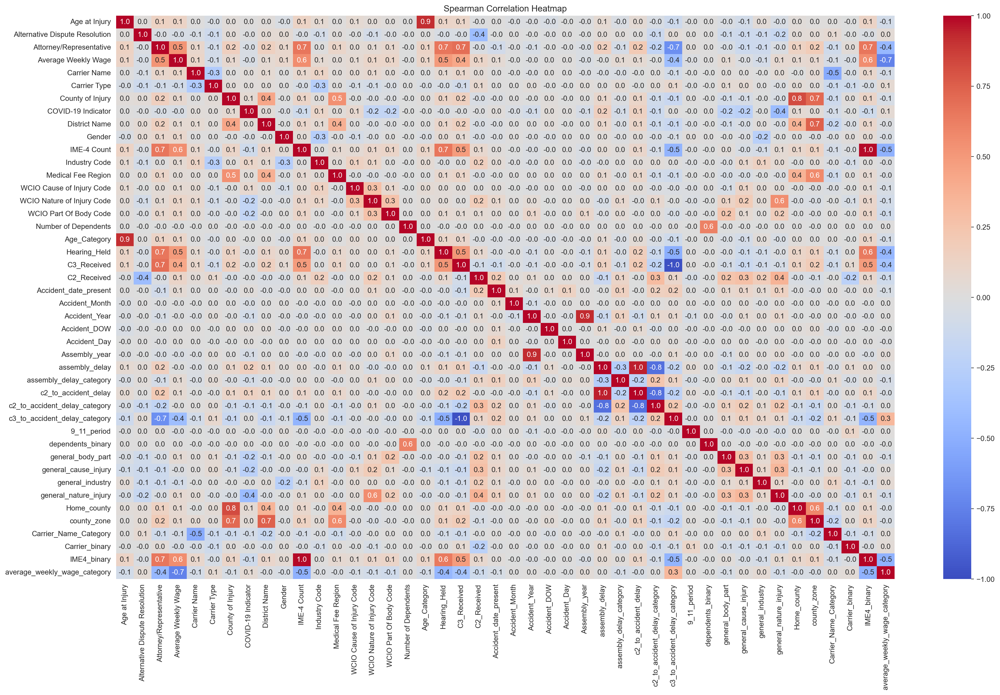

Age_Category Age at Injury 0.9161154491326097
Assembly_year Accident_Year 0.9283753824120565
c2_to_accident_delay assembly_delay 0.9520965075753389
c2_to_accident_delay_category assembly_delay -0.8316828122904406
c2_to_accident_delay_category c2_to_accident_delay -0.8283320180255621
c3_to_accident_delay_category C3_Received -0.9786501899280345
Home_county County of Injury 0.8265075517396626
IME4_binary IME-4 Count 0.9891426181333786


In [269]:
# Calculate the Spearman correlation matrix
cor_spearman = X_train_scaled.corr(method='spearman')

# Plotting the heatmap
plt.figure(figsize=(24, 14))
sns.heatmap(cor_spearman, annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt='.1f')
plt.title('Spearman Correlation Heatmap')
plt.show()

# Check the name of the variables that have a correlation higher than 0.80
for i in range(len(cor_spearman.columns)):
    for j in range(i):
        if abs(cor_spearman.iloc[i, j]) > 0.80:
            print(cor_spearman.columns[i], cor_spearman.columns[j], cor_spearman.iloc[i, j])

In [270]:
# Calculate the Spearman correlation matrix
cor_spearman = X_train_scaled.corr(method='spearman')

# Set to store unique feature names
correlated_features_set = set()

# Check for pairs of variables with a correlation higher than 0.8
for i in range(len(cor_spearman.columns)):
    for j in range(i):
        if abs(cor_spearman.iloc[i, j]) > 0.80:
            correlated_features_set.add(cor_spearman.columns[i])
            correlated_features_set.add(cor_spearman.columns[j])

# Convert the set to a list
correlated_features_list = list(correlated_features_set)

# Print the list of correlated feature names
print("Features that appeared at least once in correlated pairs:")
print(correlated_features_list)

Features that appeared at least once in correlated pairs:
['Assembly_year', 'c2_to_accident_delay_category', 'Accident_Year', 'Home_county', 'c3_to_accident_delay_category', 'C3_Received', 'assembly_delay', 'County of Injury', 'IME-4 Count', 'IME4_binary', 'c2_to_accident_delay', 'Age at Injury', 'Age_Category']


In [271]:
X_train_scaled.shape

(430519, 44)

<a class="anchor" id="3rd-bullet">

## Feature Importance:
    
</a>

### Feature Importance - RidgeCV

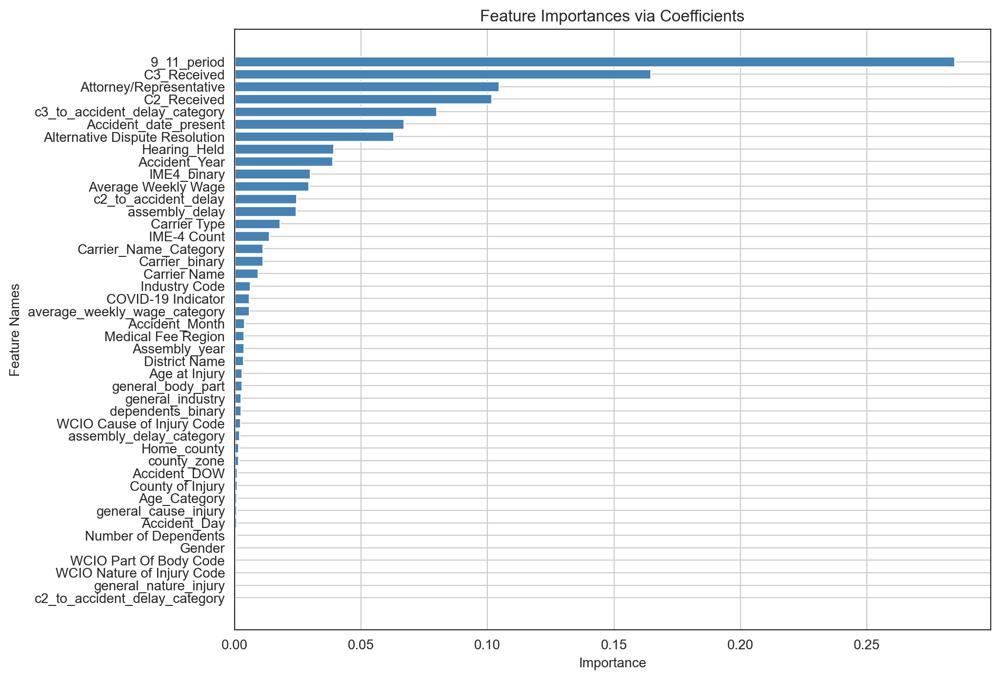

In [272]:
# Define the alphas for RidgeCV
alphas = np.logspace(-6, 6, num=5)

# Fit the RidgeCV model
ridge = RidgeCV(alphas=alphas).fit(X_train_scaled, y_train_binary)

# Get the importance of features
importance = np.abs(ridge.coef_).flatten()

# Ensure feature names are correctly defined
feature_names = np.array(X_train_scaled.columns)

# Create a DataFrame to sort the feature importances
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importance})

# Sort the DataFrame by importance in descending order
importance_df = importance_df.sort_values(by='Importance', ascending=True)

# Plot the sorted feature importances with labels on the side
plt.figure(figsize=(10, 8))
plt.barh(y=importance_df['Feature'], width=importance_df['Importance'], color='#4782B4')
plt.xlabel('Importance')
plt.ylabel('Feature Names')
plt.title('Feature Importances via Coefficients')
plt.grid(True)
plt.show()

In [273]:
low_importance_features_ridge = importance_df[importance_df['Importance'] < 0.0005]['Feature'].tolist()
# Print the list of low importance features 
print("Features with importance below 0.005:") 
print(low_importance_features_ridge)

Features with importance below 0.005:
['c2_to_accident_delay_category', 'general_nature_injury', 'WCIO Nature of Injury Code', 'WCIO Part Of Body Code', 'Gender']


### Mutual Info Gain:

<Axes: title={'center': 'Mutual Information'}>

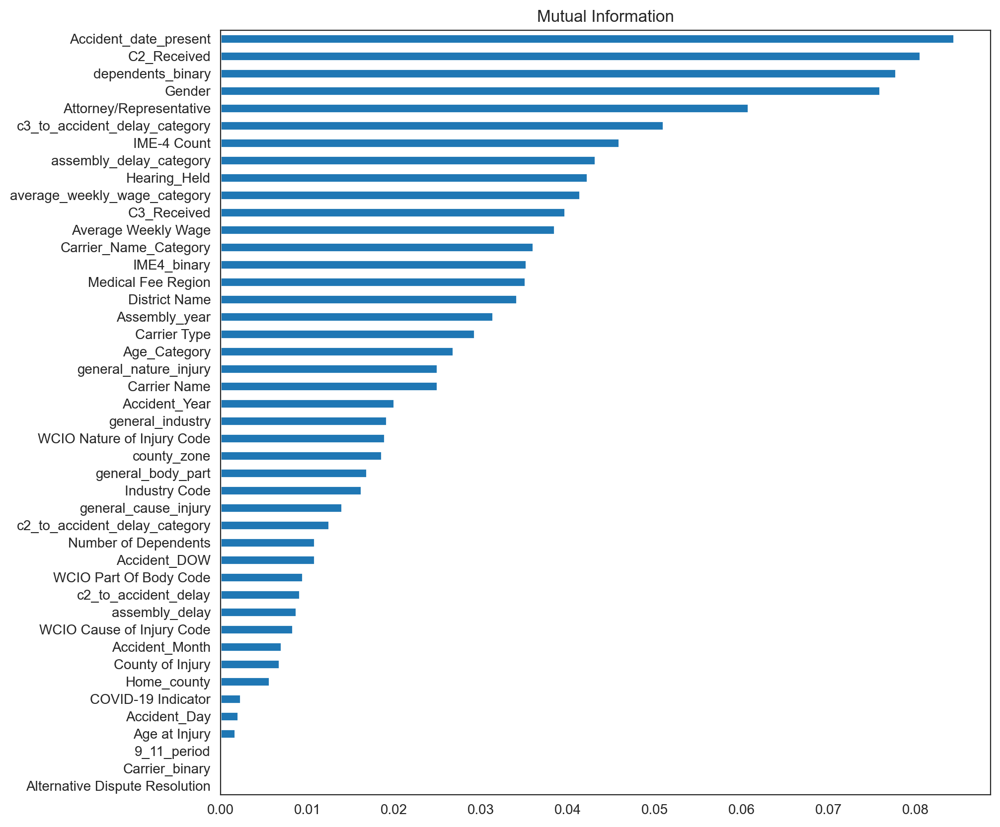

In [274]:
mi = mutual_info_classif(X_train_scaled, y_train_binary)
mi = pd.Series(mi)
mi.index = X_train_scaled.columns
mi.sort_values(ascending=False)
mi.sort_values().plot(kind='barh', title = "Mutual Information", figsize=(10, 10))

In [275]:
low_mi_features = mi[mi < 0.005].index.tolist() 
# Print the list of low mutual information features 
print("Features with mutual information below 0.005:")
print(low_mi_features)

Features with mutual information below 0.005:
['Age at Injury', 'Alternative Dispute Resolution', 'COVID-19 Indicator', 'Accident_Day', '9_11_period', 'Carrier_binary']


### Permutation Importance - Logistic: For each Class to see the difference, in OUTPUT, the CV Score was (BINARY) vs Validation (Macro) by mistake. 

In [276]:
# Initialize the Stratified K-Fold Cross-Validation
#skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize Logistic Regression with multinomial option and class_weight='balanced'
#model = LogisticRegression(class_weight='balanced', max_iter=200, solver='saga', random_state=42, warm_start=True, C=0.8)

# Define a scorer for Macro F1 Score
#macro_f1_scorer = make_scorer(f1_score, average='binary')

# Perform Stratified K-Fold Cross-Validation with Macro F1 Score
#scores = cross_val_score(model, X_train_scaled, y_train_binary, cv=skf, scoring=macro_f1_scorer)
#print(f"Cross-Validation Scores (Binary F1): {scores}")
#print(f"Mean Cross-Validation Score (Binary F1): {scores.mean():.3f}")

# Split the data into training and validation sets
#X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
 #   X_train_scaled, y_train_binary, random_state=42, shuffle=True, stratify=y_train_binary, test_size=0.25)

# Train Logistic Regression on the split data
#model.fit(X_train_split, y_train_split)

# Evaluate the model on the validation set
#print(f"Model Score on Validation Set (Binary F1): {f1_score(y_val_split, model.predict(X_val_split), average='binary'):.3f}")

# Initialize a dictionary to store feature importances for each class
#class_importances = {}

# Loop through each class and calculate permutation importance
#for class_label in np.unique(y_val_split):
 #   class_mask = y_val_split == class_label
  #  r_class = permutation_importance(model, X_val_split[class_mask], y_val_split[class_mask], n_repeats=5, random_state=0, n_jobs=-1)
    
    # Store the feature importances for the current class
   # class_importances[class_label] = {
    #    "mean": r_class.importances_mean,
     #   "std": r_class.importances_std
    #}
    
    # Create a DataFrame for the current class
    #importance_df_class = pd.DataFrame({
     #   'Feature': X_train_scaled.columns,
      #  'Importance Mean': r_class.importances_mean,
       # 'Importance Std': r_class.importances_std
   # }).sort_values(by='Importance Mean', ascending=False)
    
    # Plot the feature importances for the current class
    #plt.figure(figsize=(12, 15))
    #plt.barh(importance_df_class['Feature'], importance_df_class['Importance Mean'], xerr=importance_df_class['Importance Std'], color='skyblue')
    #plt.xlabel('Permutation Importance')
    #plt.ylabel('Feature')
    #plt.title(f'Feature Importances for Class {class_label}')
    #plt.gca().invert_yaxis()
    #plt.show()

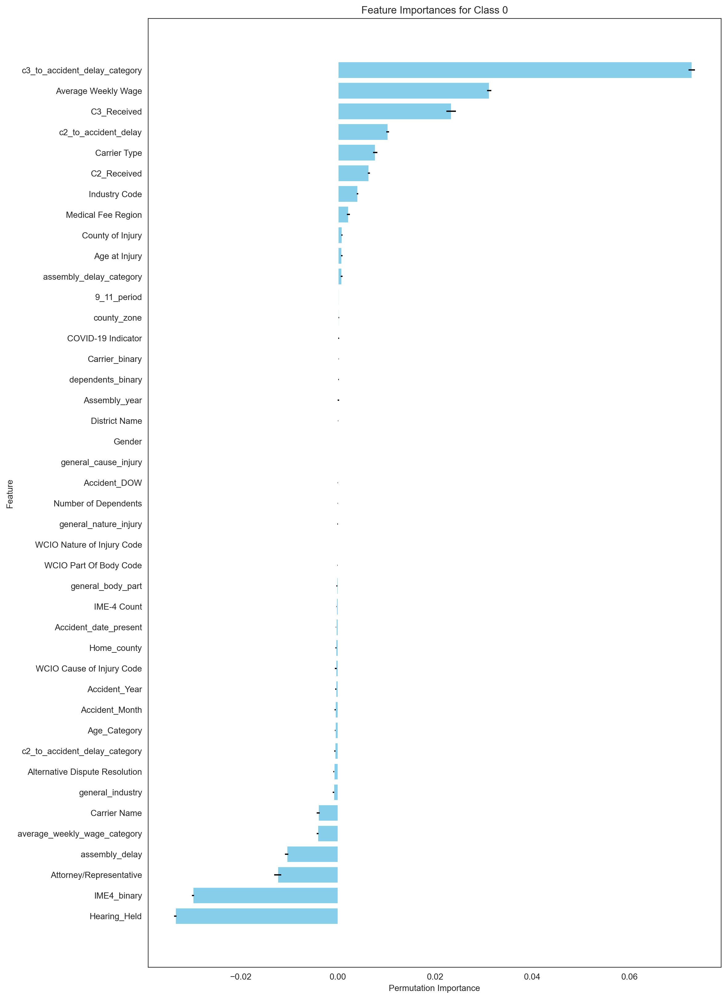

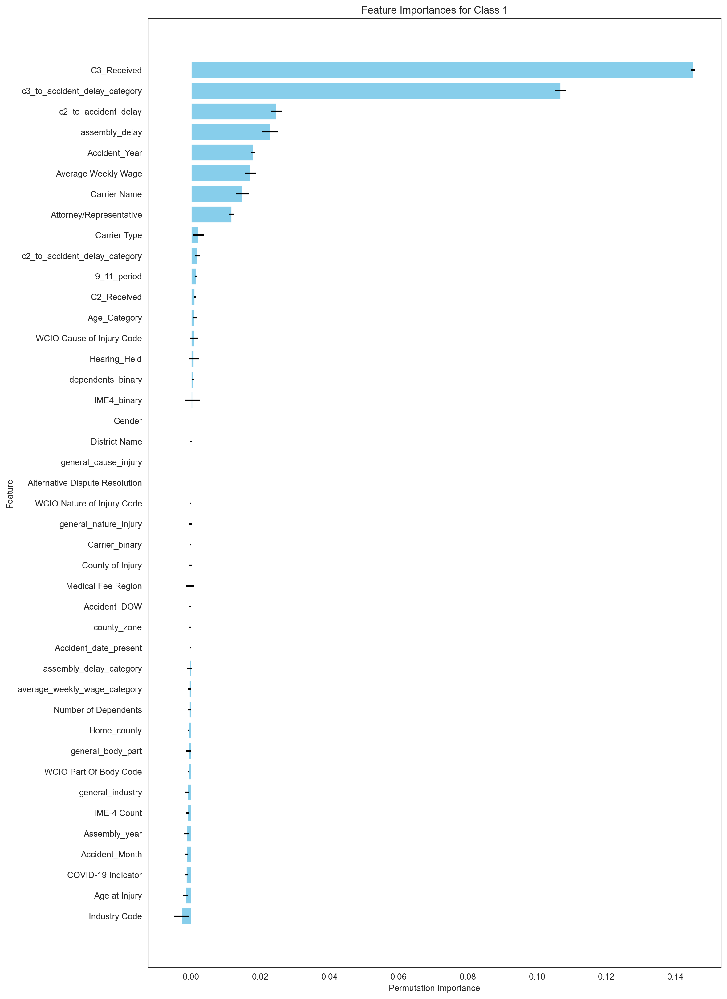

<a class="anchor" id="3rd-bullet">

## Embedded Methods:
    
</a>

### Lasso Regression

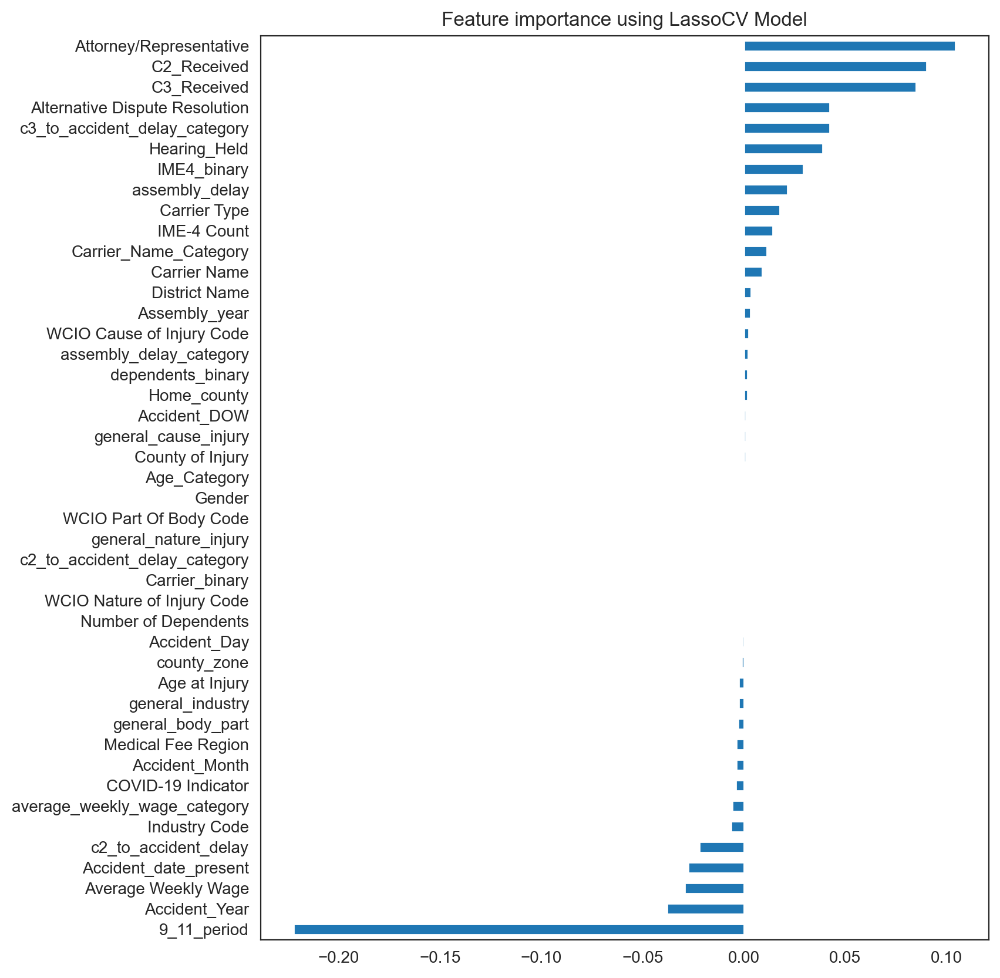

Selected features: Index(['Age at Injury', 'Alternative Dispute Resolution',
       'Attorney/Representative', 'Average Weekly Wage', 'Carrier Name',
       'Carrier Type', 'County of Injury', 'COVID-19 Indicator',
       'District Name', 'Gender', 'IME-4 Count', 'Industry Code',
       'Medical Fee Region', 'WCIO Cause of Injury Code',
       'WCIO Part Of Body Code', 'Number of Dependents', 'Age_Category',
       'Hearing_Held', 'C3_Received', 'C2_Received', 'Accident_date_present',
       'Accident_Month', 'Accident_Year', 'Accident_DOW', 'Accident_Day',
       'Assembly_year', 'assembly_delay', 'assembly_delay_category',
       'c2_to_accident_delay', 'c3_to_accident_delay_category', '9_11_period',
       'dependents_binary', 'general_body_part', 'general_cause_injury',
       'general_industry', 'general_nature_injury', 'Home_county',
       'county_zone', 'Carrier_Name_Category', 'IME4_binary',
       'average_weekly_wage_category'],
      dtype='object')


In [277]:
# Function to plot feature importance
def plot_importance(coef, name):
    imp_coef = coef.sort_values()
    plt.figure(figsize=(8,10))
    imp_coef.plot(kind="barh")
    plt.title("Feature importance using " + name + " Model")
    plt.show()

# Initialize LassoCV with StratifiedKFold
reg = LassoCV(cv=StratifiedKFold(n_splits=5))

# Fit the model
reg.fit(X_train_scaled, y_train_binary)

# Get the coefficients
coef = pd.Series(reg.coef_, index=X_train_scaled.columns)

# Plot the feature importance
plot_importance(coef, "LassoCV")

# Get the selected features
selected_features = coef[coef != 0].index
print("Selected features:", selected_features)

In [278]:
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

Lasso picked 41 variables and eliminated the other 3 variables


In [279]:
# features that lasso model excluded
lasso_drop = coef[coef == 0]

In [280]:
lasso_drop = X_train_scaled.columns[coef == 0]
lasso_drop_list = lasso_drop.tolist()
lasso_drop_list

['WCIO Nature of Injury Code',
 'c2_to_accident_delay_category',
 'Carrier_binary']

<a class="anchor" id="3rd-bullet">

## Decisions on Features:
    
</a>

We decided to use for the binary prediction purely the features that RFECV with logistic regression will select since were using this specific model. <br>
In the Multiclass we will dive deeper in feature selection - and drop variables that constantly are Not important across different methods...

In [281]:
y_train_binary.value_counts() # we also try to use SMOTE, however we got identical results, so there was no point in do it.

Agreement Reached
0    410429
1     20090
Name: count, dtype: int64

### RFECV - Logistic: - FOCUS ON THIS METHOD - However it takes 29 Min to run so it´s with text, however we see the output below:

In [282]:
# Define a custom scorer for F1 Macro
#f1_binary_scorer = make_scorer(f1_score, average="binary")

#min_features_to_select = 1  

# Initialize the classifier
#clf = LogisticRegression(class_weight="balanced", solver="saga", random_state=42, n_jobs=-1)

#cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# RFECV with F1 Binary as the scoring metric
#rfecv = RFECV(estimator=clf, step=1, cv=cv, scoring=f1_binary_scorer, min_features_to_select=min_features_to_select, n_jobs=-1,)

#rfecv.fit(X_train_scaled, y_train_binary)

#print(f"Optimal number of features: {rfecv.n_features_}")

#ranking = pd.DataFrame(
 #   {"Feature": X_train_scaled.columns, "Rank": rfecv.ranking_}).sort_values(by="Rank")

#print("Feature Rankings:")
#print(ranking)

# Get the cross-validation scores (mean test score) from the cv_results_ attribute
#cv_scores = rfecv.cv_results_['mean_test_score']

#plt.figure(figsize=(10, 6))
#plt.xlabel("Number of features selected")
#plt.ylabel("Cross-validation score (F1 Binary)")
#plt.title("RFECV: Recursive Feature Elimination using F1 Binary")
#plt.plot(range(min_features_to_select, len(cv_scores) + min_features_to_select), cv_scores)
#plt.show()


This provided the rankings, however for some reason the output disappeared, so we have in MARKDOWN from previous Notebook.

Optimal number of features: 31

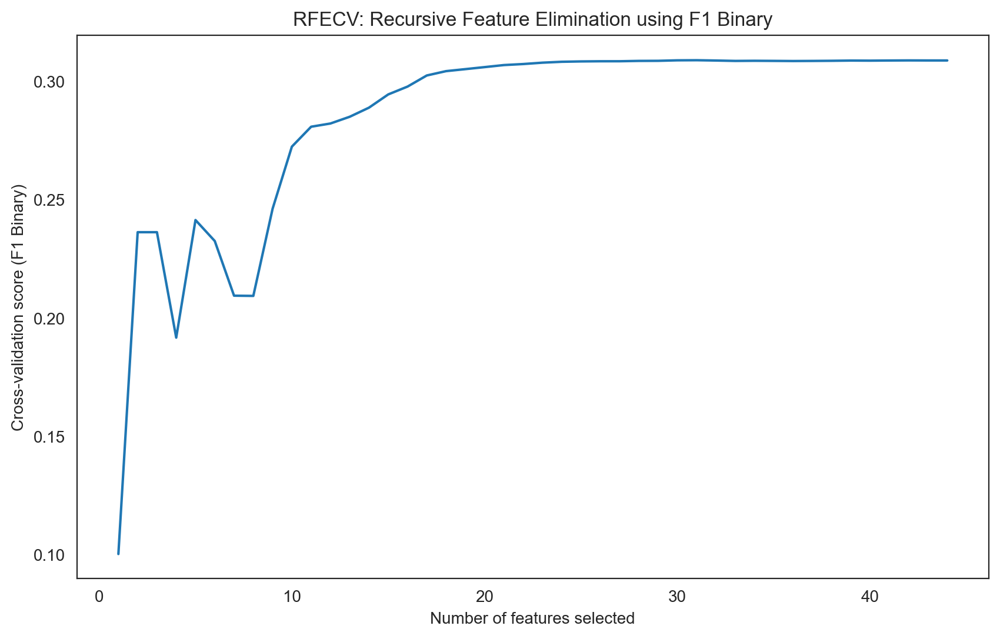

In [283]:
# Sorting the feature rankings by highest importance (Rank = 1 is most important)
#sorted_ranking = ranking.sort_values(by="Rank", ascending=True)

# Plotting the sorted feature rankings
#plt.figure(figsize=(10, 10))
#plt.barh(sorted_ranking['Feature'], sorted_ranking['Rank'], color='steelblue')
#plt.xlabel('Rank (1 = most important)')
#plt.ylabel('Feature')
#plt.title('Feature Importance Based on RFECV Ranking (Lowest Rank = Most Important)')
#plt.gca().invert_yaxis()  # To have the most important feature at the top
#plt.show()


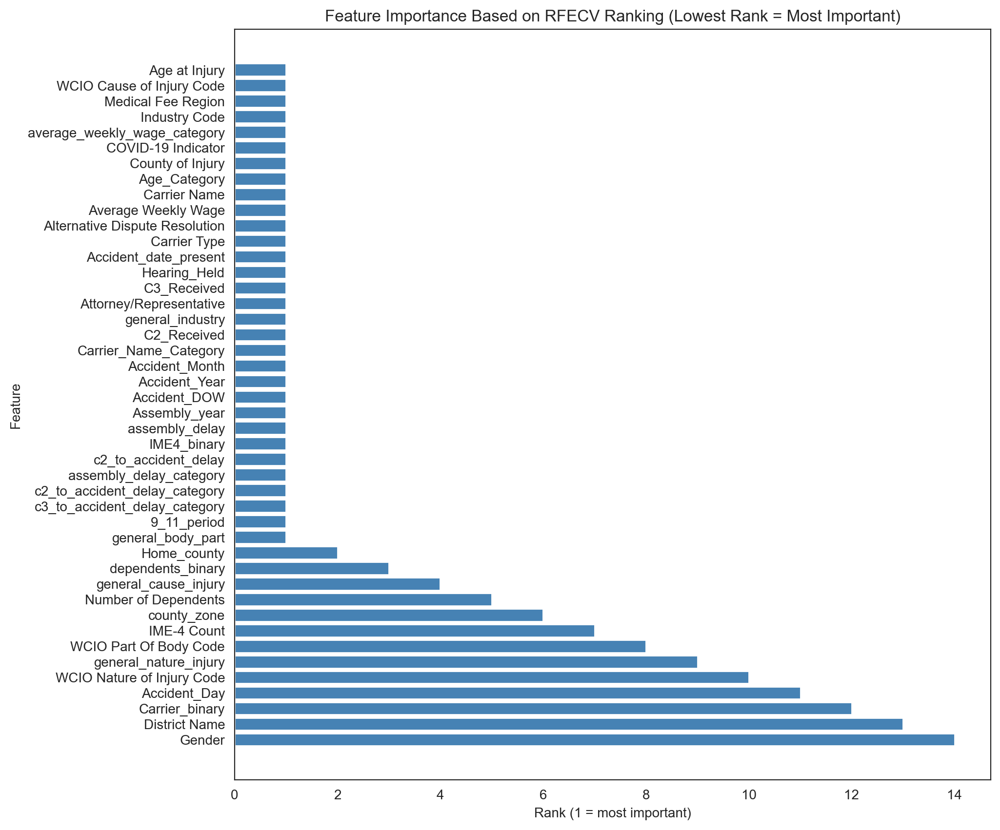

In [284]:
# Get the selected features based on RFECV
#selected_features = X_train_scaled.columns[rfecv.support_]

# Print the list of selected features
#print("Selected Features:")
#print(selected_features)

In [285]:
selected_features = ['Age at Injury', 'Alternative Dispute Resolution',
       'Attorney/Representative', 'Average Weekly Wage', 'Carrier Name',
       'Carrier Type', 'County of Injury', 'COVID-19 Indicator',
       'Industry Code', 'Medical Fee Region', 'WCIO Cause of Injury Code',
       'Age_Category', 'Hearing_Held', 'C3_Received', 'C2_Received',
       'Accident_date_present', 'Accident_Month', 'Accident_Year',
       'Accident_DOW', 'Assembly_year', 'assembly_delay',
       'assembly_delay_category', 'c2_to_accident_delay',
       'c2_to_accident_delay_category', 'c3_to_accident_delay_category',
       '9_11_period', 'general_body_part', 'general_industry',
       'Carrier_Name_Category', 'IME4_binary', 'average_weekly_wage_category']

<div class="alert alert-block alert-success">

<a class="anchor" id="1st-bullet">    </a>
# 7. Model for Binary Target - Agreement Reached
    

    
</div>

<a class="anchor" id="3rd-bullet">

### Logistic Binary
    
</a>

## Why did we chose Logistic Regression for Binary Classification

1. **Simplicity and Interpretability**: 
   - Logistic regression is straightforward to implement and interpret.
   - The coefficients represent the log odds of the outcome, making it easy to understand the relationship between the features and the target variable.

2. **Probabilistic Output**: 
   - It provides probabilistic predictions, which can be useful for decision-making processes.
   - The output is a probability score between 0 and 1, indicating the likelihood of the positive class.

3. **Feature Importance**: 
   - The model coefficients can be used to assess the importance of each feature, providing insights into which features are most influential in predicting the target variable.
   

4. **Wide Applicability**: 
   - Logistic regression is widely applicable across various domains, including finance, healthcare, marketing, and social sciences, making it a versatile tool for binary classification problems.

Overall, logistic regression is a robust and reliable choice for binary classification tasks, offering a good balance between simplicity, interpretability, and performance.

In [286]:
# Define the scoring metrics: accuracy, macro F1 score, and log loss
scoring = {
    'accuracy': 'accuracy',
    'f1_binary': make_scorer(f1_score, average='binary'),
    'log_loss': make_scorer(log_loss, greater_is_better=False, needs_proba=True)
}

# Initialize the logistic regression model
logistic_model = LogisticRegression(random_state=42, max_iter=400, verbose=1, C=0.90, class_weight='balanced')

# Perform a 5-fold cross-validation
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
cv_results = cross_validate(logistic_model, X_train_scaled[selected_features], y_train_binary, cv=skf, scoring=scoring)

print("Cross-Validation Results:")
print(f"Accuracy: {np.mean(cv_results['test_accuracy']):.4f}")
print(f"Binary F1 Score: {np.mean(cv_results['test_f1_binary']):.4f}")
print(f"Log Loss: {-np.mean(cv_results['test_log_loss']):.4f}")

Cross-Validation Results:
Accuracy: 0.8137
Binary F1 Score: 0.3087
Log Loss: 0.3900


**In here, we tried to define a threshold that also maximizes precision and recall on minority class (1)**

Validation Results with Lower Threshold:
Accuracy: 0.9311
Binary F1 Score: 0.3851
Log Loss: 0.3896

Classification Report with Lower Threshold:
              precision    recall  f1-score   support

           0     0.9731    0.9541    0.9635    136810
           1     0.3301    0.4621    0.3851      6697

    accuracy                         0.9311    143507
   macro avg     0.6516    0.7081    0.6743    143507
weighted avg     0.9431    0.9311    0.9365    143507



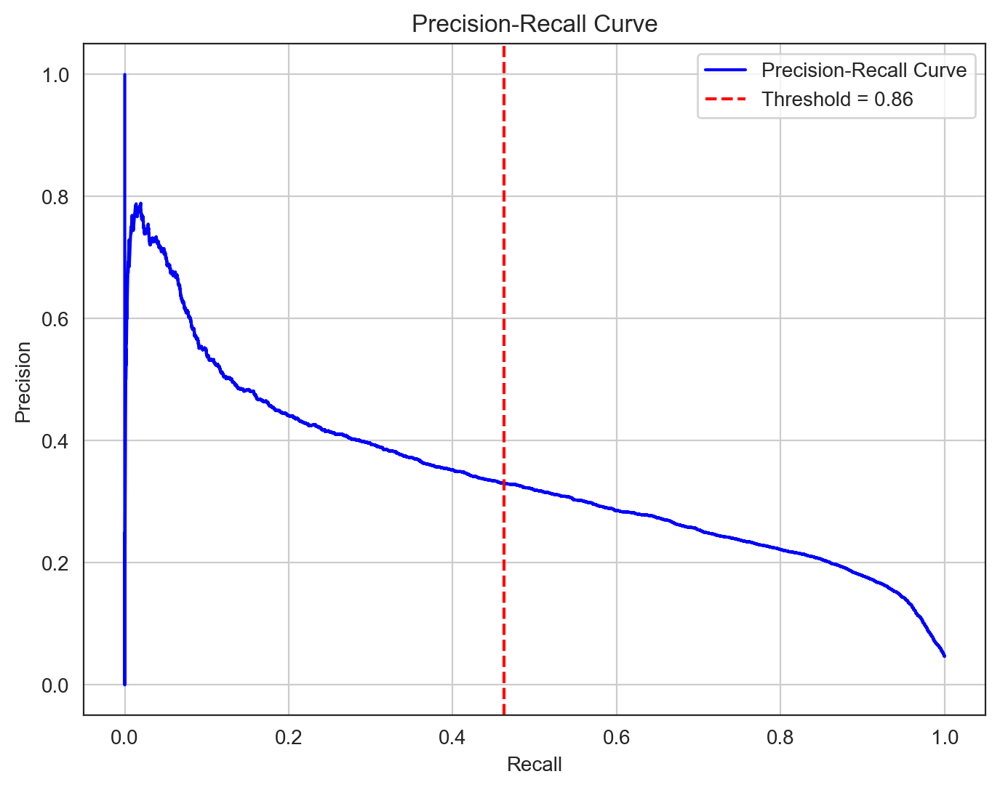

In [287]:
# Fit the logistic regression model on the entire training set
logistic_model.fit(X_train_scaled[selected_features], y_train_binary)

# Evaluate the model on the validation set
val_probabilities = logistic_model.predict_proba(X_val_scaled[selected_features])[:, 1]

# Set a threshold
lower_threshold = 0.86

# Make predictions using threshold
val_predictions_lower = (val_probabilities >= lower_threshold).astype(int)

# Calculate validation metrics
val_accuracy = accuracy_score(y_val_binary, val_predictions_lower)
val_f1_binary = f1_score(y_val_binary, val_predictions_lower, average='binary')
val_log_loss = log_loss(y_val_binary, val_probabilities)  # Use val_probabilities for log_loss

# Output validation metrics
print("Validation Results with Lower Threshold:")
print(f"Accuracy: {val_accuracy:.4f}")
print(f"Binary F1 Score: {val_f1_binary:.4f}")
print(f"Log Loss: {val_log_loss:.4f}")

# Generate and print a detailed classification report
print("\nClassification Report with Lower Threshold:")
print(classification_report(y_val_binary, val_predictions_lower, digits=4))

# Generate precision-recall curve
precision, recall, thresholds = precision_recall_curve(y_val_binary, val_probabilities)

# Plot the precision-recall curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label="Precision-Recall Curve", color='b')
plt.axvline(x=recall[(thresholds >= lower_threshold).argmax()], linestyle="--", color="r", label=f"Threshold = {lower_threshold:.2f}")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve")
plt.legend()
plt.grid()
plt.show()


**We see by the Confusion Matrix, that the model doesn´t perform well on predicting class 1, since it fails 6280 and only get right 3095**

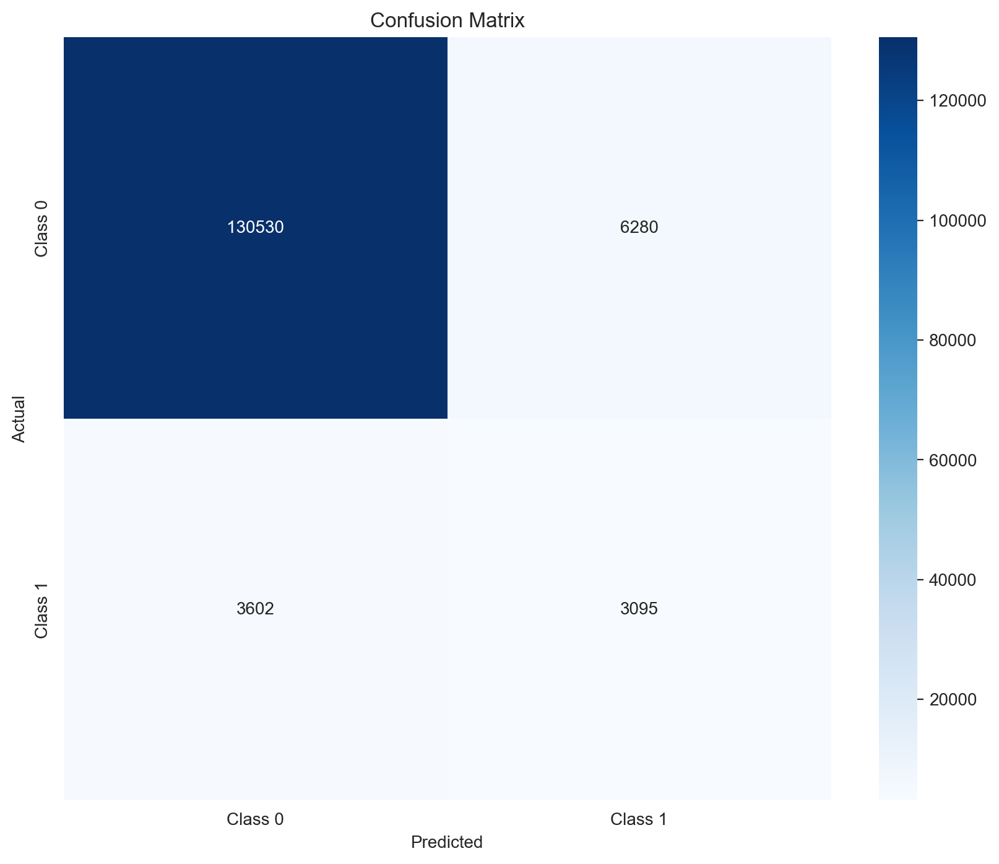

In [288]:
# Compute the confusion matrix
conf_matrix = confusion_matrix(y_val_binary, val_predictions_lower)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [289]:
y_test_binary = logistic_model.predict(X_test_scaled[selected_features])             # predict on the test set
test_probabilities = logistic_model.predict_proba(X_test_scaled[selected_features])     # get the class probabilities

y_test_binary = pd.DataFrame(y_test_binary, columns=['Agreement Reached'])
y_test_binary.head()

,Agreement Reached
0,0
1,0
2,0
3,0
4,0


In [290]:
# Merge y_test_binary (with predictions) with X_test (original features)
X_test_original = pd.read_csv('test_data.csv')  # add to original one the agreement reached.

# Add the 'Agreement Reached' column to X_test
X_test_original['Agreement Reached'] = y_test_binary['Agreement Reached']

# Check the first few rows of the combined DataFrame
X_test_original.head()

,Accident Date,Age at Injury,Alternative Dispute Resolution,Assembly Date,Attorney/Representative,Average Weekly Wage,Birth Year,C-2 Date,C-3 Date,Carrier Name,Carrier Type,Claim Identifier,County of Injury,COVID-19 Indicator,District Name,First Hearing Date,Gender,IME-4 Count,Industry Code,Industry Code Description,Medical Fee Region,OIICS Nature of Injury Description,WCIO Cause of Injury Code,WCIO Cause of Injury Description,WCIO Nature of Injury Code,WCIO Nature of Injury Description,WCIO Part Of Body Code,WCIO Part Of Body Description,Zip Code,Number of Dependents,Agreement Reached
0,2022-12-24,19,N,2023-01-02,N,NaN,2003.0,2023-01-02,NaN,INDEMNITY INSURANCE CO OF,1A. PRIVATE,6165911,BRONX,N,NYC,NaN,M,NaN,48.0,TRANSPORTATION AND WAREHOUSING,IV,NaN,31.0,"FALL, SLIP OR TRIP, NOC",10.0,CONTUSION,54.0,LOWER LEG,10466,1,0
1,2022-11-20,19,N,2023-01-02,N,NaN,2003.0,2023-01-02,NaN,A I U INSURANCE COMPANY,1A. PRIVATE,6166141,QUEENS,N,NYC,NaN,F,NaN,45.0,RETAIL TRADE,IV,NaN,75.0,FALLING OR FLYING OBJECT,10.0,CONTUSION,10.0,MULTIPLE HEAD INJURY,11691,1,0
2,2022-12-26,59,N,2023-01-02,N,0.0,1963.0,2022-12-31,NaN,AMGUARD INSURANCE COMPANY,1A. PRIVATE,6165907,WESTCHESTER,N,NYC,NaN,F,NaN,56.0,ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMEN...,III,NaN,68.0,STATIONARY OBJECT,49.0,SPRAIN OR TEAR,62.0,BUTTOCKS,10604,0,0
3,2022-12-28,55,N,2023-01-02,N,0.0,0.0,2023-01-02,NaN,INDEMNITY INS. OF N AMERICA,1A. PRIVATE,6166047,QUEENS,N,NYC,NaN,F,NaN,48.0,TRANSPORTATION AND WAREHOUSING,IV,NaN,25.0,FROM DIFFERENT LEVEL (ELEVATION),10.0,CONTUSION,53.0,KNEE,11411,6,0
4,2022-12-20,25,N,2023-01-02,N,0.0,1997.0,2022-12-31,NaN,NEW HAMPSHIRE INSURANCE CO,1A. PRIVATE,6166102,KINGS,N,NYC,NaN,M,NaN,55.0,MANAGEMENT OF COMPANIES AND ENTERPRISES,IV,NaN,79.0,OBJECT BEING LIFTED OR HANDLED,40.0,LACERATION,37.0,THUMB,11212,5,0


In [291]:
X_test_original['Agreement Reached'].value_counts()

Agreement Reached
0    359805
1     28170
Name: count, dtype: int64

In [292]:
X_test_original.to_csv('X_test_agreement.csv', index=False)